<a href="https://colab.research.google.com/github/rodks/Projeto_integrador_DH_2021/blob/main/Projeto_Integrador_colab_(Completo).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# PROJETO INTEGRADOR

In this challenge, you are asked to predict whether a user will churn after his/her subscription expires. Specifically, we want to forecast if a user make a new service subscription transaction within 30 days after the current membership expiration date.

KKBOX offers subscription based music streaming service. When users signs up for our service, users can choose to either manual renew or auto-renew the service. Users can actively cancel their membership at any time.

# Análise Descritiva

## Data Description



#### The churn/renewal definition can be tricky due to KKBox's subscription model. Since the majority of KKBox's subscription length is 30 days, a lot of users re-subscribe every month. The key fields to determine churn/renewal are transaction date, membership expiration date, and is_cancel. Note that the is_cancel field indicates whether a user actively cancels a subscription. Subscription cancellation does not imply the user has churned. A user may cancel service subscription due to change of service plans or other reasons. The criteria of "churn" is no new valid service subscription within 30 days after the current membership expires.

UPDATE: As of November 6, 2017, we have refreshed the test data to predict user churn in the month of April, 2017

The training and the test data are selected from users whose membership expire within a certain month. The train data consists of users whose subscription expires within the month of February 2017, and the test data is with users whose subscription expires within the month of March 2017. This means we are looking at user churn or renewal roughly in the month of March 2017 for train set, and the user churn or renewal roughly in the month of April 2017. Train and test sets are split by transaction date, as well as the public and private leaderboard data.

In this dataset, KKBox has included more users behaviors than the ones in train and test datasets, in order to enable participants to explore different user behaviors outside of the train and test sets. For example, a user could actively cancel the subscription, but renew within 30 days.

## Tables

### train.csv


the train set, containing the user ids and whether they have churned.

msno: user id
is_churn: This is the target variable. Churn is defined as whether the user did not continue the subscription within 30 days of expiration. is_churn = 1 means churn,is_churn = 0 means renewal.

### transactions.csv

msno: user id

payment_method_id: payment method

payment_plan_days: length of membership plan in days

plan_list_price: in New Taiwan Dollar (NTD)

actual_amount_paid: in New Taiwan Dollar (NTD)

is_auto_renew

transaction_date: format %Y%m%d

membership_expire_date: format %Y%m%d

is_cancel: whether or not the user canceled the membership in this transaction.

### user_logs.csv

daily user logs describing listening behaviors of a user. Data collected until 2/28/2017.

msno: user id
    
date: format %Y%m%d
    
num_25: # of songs played less than 25% of the song length
    
num_50: # of songs played between 25% to 50% of the song length
    
num_75: # of songs played between 50% to 75% of of the song length
num_985: # of songs played between 75% to 98.5% of the song length
    
num_100: # of songs played over 98.5% of the song length
    
num_unq: # of unique songs played
    
total_secs: total seconds played

### members.csv

user information. Note that not every user in the dataset is available.

msno

city

bd: age. Note: this column has outlier values ranging from -7000 to 2015, please use your judgement.

gender

registered_via: registration method

registration_init_time: format %Y%m%d

expiration_date: format %Y%m%d, taken as a snapshot at which the member.csv is extracted. Not representing the actual churn behavior.

### Data Extraction Details

We include the code "WSDMChurnLabeller.scala" for generating labels for the user of our interest. The code provided is the one we used to generate the label for the test data set. Note that the date values in the script is modified so it is easier to run on personal laptops. On our cluster, the log history starts from 2015-01-01 to 2017-03-31. With the provision of the user label generator, we encourage participants to generate training labels using data not included in our sample training labels.

One important information in the data extraction process is the definition of membership expiration date. Suppose we have a sequence for a user with the tuple of (transaction date, membership expiration date, and is_cancel):

(2017-01-01, 2017-02-28, false)

(2017-02-25, 0217-03-15, false)

(2017-04-30, 3017-05-20, false)

(data used for demo only, not included in competition dataset)

This user is included in the dataset since the expiration date falls within our time period. Since the subscription transaction is 30 days away from 2017-03-15, the previous expiration date, we will count this user as a churned user.

Let's consider a more complex example derive the last one, suppose now a user has the following transaction sequence

(2017-01-01, 2017-02-28, false)

(2017-02-25, 2017-04-03, false)

(2017-03-15, 2017-03-16, true)

(2017-04-01, 3017-06-30, false)

The above entries is quite typical for a user who changes his subscription plan. Entry 3 indicates that the membership expiration date is moved from 2017-04-03 back to 2017-03-16 due to the user making an active cancellation on the 15th. On April 1st, the user made a long term (two month subscription), which is 15 days after the "current" expiration date. So this user is not a churn user.

Now let's consider the a sequence that indicate the user does not falls in our scope of prediction

(2017-01-01, 2017-02-28, false)

(2017-02-25, 2017-04-03, false)

(2017-03-15, 2017-03-16, true)

(2017-03-18, 2017-04-02, false)

Note that even the 3rd entry has member ship expiration date falls in 2017-03-16, but the fourth entry extends the membership expiration date to 2017-04-02, not between 2017-03-01 and 2017-03-31, so we will not make a prediction for the user.

## Tipos de variáveis

### Variáveis Quantitativas: 
são as características que podem ser medidas em uma escala quantitativa, ou seja, apresentam valores numéricos que fazem sentido. Podem ser contínuas
ou discretas.
#### Variáveis contínuas: 
características mensuráveis que assumem valores em uma
escala contínua (na reta real), para as quais valores não-inteiros (com casas
decimais) fazem sentido. Usualmente devem ser medidas através de algum
instrumento. Exemplos: peso (balança), altura (régua), tempo (relógio), pressão
arterial, idade.
#### Variáveis discretas: 
características mensuráveis que podem assumir apenas um
número finito ou infinito contável de valores e, assim, somente fazem sentido
valores inteiros. Geralmente, são o resultado de contagens. Exemplos: número de
filhos, número de bactérias por litro de leite, número de cigarros fumados por dia. 

### Variáveis Qualitativas (ou categóricas): 
são as características que não possuem valores
quantitativos, mas, ao contrário, são definidas por várias categorias, ou seja, representam uma
classificação dos indivíduos. Podem ser nominais ou ordinais.
#### Variável nominais: 
não existe ordenação entre as categorias.
Exemplos: sexo, cor dos olhos, fumante/não fumante, doente/sadio.
#### Variáveis ordinais: 
existe uma ordenação entre as categorias.
Exemplos: escolaridade (1o, 2o, 3o graus), estágio da doença (inicial,
intermediário, terminal), mês de observação (janeiro, fevereiro,..., dezembro). 

### transactions.csv

#### Variáveis Qualitativas nominais:

msno: user id

payment_method_id: payment method

is_auto_renew

is_cancel: whether or not the user canceled the membership in this transaction.

#### Variáveis Qualitativas ordinais:

transaction_date: format %Y%m%d

membership_expire_date: format %Y%m%d

#### Variáveis Quantitativas discretas:

payment_plan_days: length of membership plan in days

plan_list_price: in New Taiwan Dollar (NTD)

actual_amount_paid: in New Taiwan Dollar (NTD)






### user_logs.csv

#### Variáveis Qualitativa nominais:

msno: user id

#### Variáveis Qualitativas ordinais:

date: format %Y%m%d

#### Variáveis Quantitativas discretas:
    
num_25: # of songs played less than 25% of the song length
    
num_50: # of songs played between 25% to 50% of the song length
    
num_75: # of songs played between 50% to 75% of of the song length
num_985: # of songs played between 75% to 98.5% of the song length
    
num_100: # of songs played over 98.5% of the song length
    
num_unq: # of unique songs played

total_secs: total seconds played

### members.csv

#### Variáveis Qualitativa nominais:

msno

city

gender

registered_via: registration method

#### Variáveis Qualitativas ordinais:

registration_init_time: format %Y%m%d

expiration_date: format %Y%m%d, taken as a snapshot at which the member.csv is extracted. Not representing the actual churn behavior.


#### Variáveis Quantitativas discretas:

bd: age. Note: this column has outlier values ranging from -7000 to 2015, please use your judgement.



# Bibliotecas

## Instalações

In [1]:
pip install sweetviz

     |████████████████████████████████| 15.1 MB 3.7 MB/s 


In [ ]:
#pip install featuretools

In [ ]:
#!apt-get install p7zip-full

In [2]:
pip install imblearn 

## Rodar as instalações antes de importar

In [3]:
# Biblioteca EDA
import sweetviz as sv
from imblearn.over_sampling import SMOTE
# Feature Engineering
# import featuretools as ft

/usr/local/lib/python3.7/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


## Biblioteca Principal

In [4]:
# Bibliotecas basicas
import numpy as np
import matplotlib.pyplot as plt  
import pandas as pd 
import seaborn as sns
from IPython.display import HTML
import random
import pandas
from matplotlib.ticker import FormatStrFormatter
import os, signal

# Bibliotecas Data Wrangling
from sklearn.model_selection import train_test_split
import sklearn.metrics as metrics
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, OneHotEncoder, OrdinalEncoder
from sklearn.compose import ColumnTransformer # aplicação de diferentes transformações a diferentes recursos em um pipeline scikit-learn.
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.model_selection import  cross_validate
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score

# Modelos de Machine Learning
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression

# Estatisticas
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import make_scorer
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import fbeta_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import log_loss
from mlxtend.plotting import plot_confusion_matrix
from sklearn.metrics import classification_report

## Carregamento dos dados

### Via Colab

In [5]:
from google.colab import drive 
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
df_members = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/members_v3.csv')

In [ ]:
df_transactions = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/transactions.csv')

In [ ]:
df_train = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/train.csv')


In [ ]:
df_user_logs_group_all_final = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/user_logs_group_all_final.csv')

### Via Jupyter

In [ ]:
df_members = pd.read_csv('members_v3.csv')

In [ ]:
df_transactions = pd.read_csv('transactions.csv')

In [ ]:
df_train = pd.read_csv('train.csv')

In [ ]:
df_user_logs = pd.read_csv('user_logs_sample3 (0,1%).csv')

# ANALISE EXPLORATÓRIA DOS DADOS

## transactions.csv

In [ ]:
df_transactions.columns

Index(['msno', 'payment_method_id', 'payment_plan_days', 'plan_list_price',
       'actual_amount_paid', 'is_auto_renew', 'transaction_date',
       'membership_expire_date', 'is_cancel'],
      dtype='object')

In [ ]:
df_transactions.shape

(21547746, 9)

In [ ]:
df_transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21547746 entries, 0 to 21547745
Data columns (total 9 columns):
 #   Column                  Dtype 
---  ------                  ----- 
 0   msno                    object
 1   payment_method_id       int64 
 2   payment_plan_days       int64 
 3   plan_list_price         int64 
 4   actual_amount_paid      int64 
 5   is_auto_renew           int64 
 6   transaction_date        int64 
 7   membership_expire_date  int64 
 8   is_cancel               int64 
dtypes: int64(8), object(1)
memory usage: 1.4+ GB


In [ ]:
# modificar a variavel "date" para datetime
df_transactions_mod = df_transactions

In [ ]:
df_transactions_mod['transaction_date'] =  pd.to_datetime(df_transactions_mod['transaction_date'], format='%Y%m%d')
df_transactions_mod['membership_expire_date' ] =  pd.to_datetime(df_transactions_mod['membership_expire_date'], format='%Y%m%d')

In [ ]:
# Criar uma coluna apenas com anos
df_transactions_mod['transaction_year'] = pd.DatetimeIndex(df_transactions_mod['transaction_date']).year
df_transactions_mod['membership_expire_year'] = pd.DatetimeIndex(df_transactions_mod['membership_expire_date']).year

In [ ]:
df_transactions_mod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21547746 entries, 0 to 21547745
Data columns (total 11 columns):
 #   Column                  Dtype         
---  ------                  -----         
 0   msno                    object        
 1   payment_method_id       int64         
 2   payment_plan_days       int64         
 3   plan_list_price         int64         
 4   actual_amount_paid      int64         
 5   is_auto_renew           int64         
 6   transaction_date        datetime64[ns]
 7   membership_expire_date  datetime64[ns]
 8   is_cancel               int64         
 9   transaction_year        int64         
 10  membership_expire_year  int64         
dtypes: datetime64[ns](2), int64(8), object(1)
memory usage: 1.8+ GB


In [ ]:
df_transactions_mod.head()

,msno,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date,membership_expire_date,is_cancel,transaction_year,membership_expire_year
0,YyO+tlZtAXYXoZhNr3Vg3+dfVQvrBVGO8j1mfqe4ZHc=,41,30,129,129,1,2015-09-30,2015-11-01,0,2015,2015
1,AZtu6Wl0gPojrEQYB8Q3vBSmE2wnZ3hi1FbK1rQQ0A4=,41,30,149,149,1,2015-09-30,2015-10-31,0,2015,2015
2,UkDFI97Qb6+s2LWcijVVv4rMAsORbVDT2wNXF0aVbns=,41,30,129,129,1,2015-09-30,2016-04-27,0,2015,2016
3,M1C56ijxozNaGD0t2h68PnH2xtx5iO5iR2MVYQB6nBI=,39,30,149,149,1,2015-09-30,2015-11-28,0,2015,2015
4,yvj6zyBUaqdbUQSrKsrZ+xNDVM62knauSZJzakS9OW4=,39,30,149,149,1,2015-09-30,2015-11-21,0,2015,2015


In [ ]:
df_transactions_mod.tail()

,msno,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date,membership_expire_date,is_cancel,transaction_year,membership_expire_year
21547741,6AO1oJjW3YT1adWzyWhzf8hlyjeOuQatudP8FF13UB4=,38,30,149,149,0,2015-10-30,2015-11-29,0,2015,2015
21547742,wkSSJvM8E1hsNmRYE4vlOcR426v0Kd4L2E++Qxgz/bo=,36,30,150,150,0,2016-03-31,2016-05-30,0,2016,2016
21547743,VQ4KpwvezU3dqq6Bkqfjsmt4fn0JDRckkDoFFt0/UqM=,36,30,180,180,0,2016-11-29,2016-12-29,0,2016,2016
21547744,a84q/Ts47Oyyqc1N1WRasBdbgYSF/f3uqBcEAPNemoM=,41,30,99,99,1,2016-11-30,2016-12-31,0,2016,2016
21547745,oE4y2wK5E7OR8zyrCHeW02uTeI6wTwT4QTApEVBNEdM=,41,30,149,0,1,2015-10-29,2015-10-29,1,2015,2015


In [ ]:
df_transactions_mod.describe()

,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,is_cancel,transaction_year,membership_expire_year
count,2.154775e+07,2.154775e+07,2.154775e+07,2.154775e+07,2.154775e+07,2.154775e+07,2.154775e+07,2.154775e+07
mean,3.893310e+01,3.133906e+01,1.398850e+02,1.419873e+02,8.519661e-01,3.976523e-02,2.015694e+03,2.015797e+03
std,3.507936e+00,3.035649e+01,1.309647e+02,1.324824e+02,3.551336e-01,1.954072e-01,6.252518e-01,7.874909e-01
min,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.015000e+03,1.970000e+03
25%,3.800000e+01,3.000000e+01,9.900000e+01,9.900000e+01,1.000000e+00,0.000000e+00,2.015000e+03,2.015000e+03
50%,4.100000e+01,3.000000e+01,1.490000e+02,1.490000e+02,1.000000e+00,0.000000e+00,2.016000e+03,2.016000e+03
75%,4.100000e+01,3.000000e+01,1.490000e+02,1.490000e+02,1.000000e+00,0.000000e+00,2.016000e+03,2.016000e+03
max,4.100000e+01,4.500000e+02,2.000000e+03,2.000000e+03,1.000000e+00,1.000000e+00,2.017000e+03,2.017000e+03


In [ ]:
df_transactions_mod.isnull().sum()

msno                      0
payment_method_id         0
payment_plan_days         0
plan_list_price           0
actual_amount_paid        0
is_auto_renew             0
transaction_date          0
membership_expire_date    0
is_cancel                 0
transaction_year          0
membership_expire_year    0
dtype: int64

In [ ]:
df_transactions_mod.duplicated().value_counts()

False    21544407
True         3339
dtype: int64

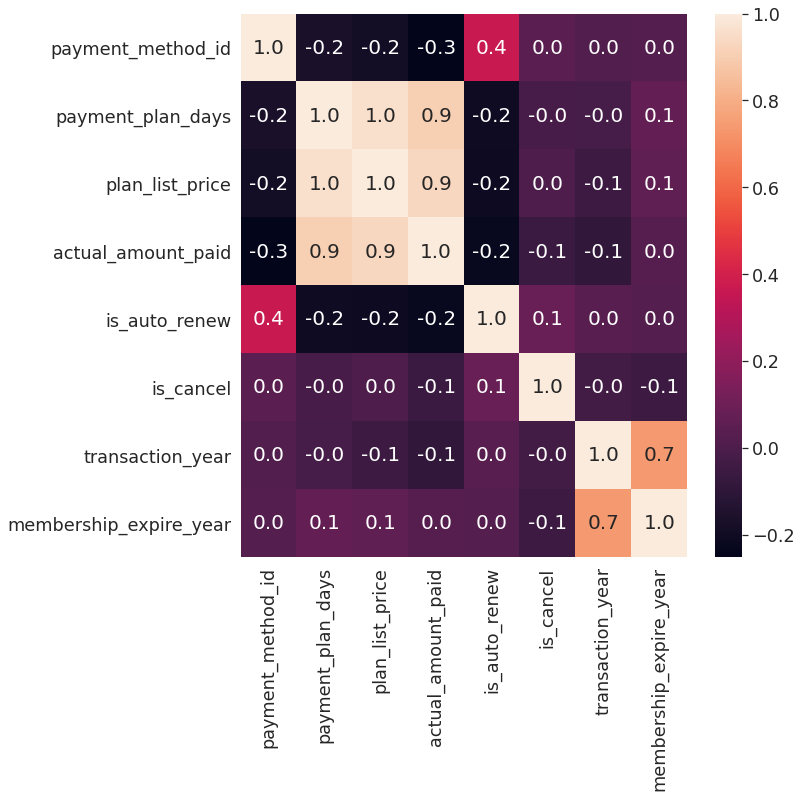

In [ ]:
sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(df_transactions_mod.corr(), annot=True, fmt='.1f', annot_kws={"size": 20})

### Resumo Correlação & Null Values: 

1.   **Null values**: Não foram identificados valores nulos
2.   **Correlação1**: Alta correlação entre payment_plan_days e (plan_list_price & actual_amount_paid)
3.   **Correlação2**: Alta correlação entre plan_list_price & actual_amount_paid
4.   **Analise Correlação 1 e 2**: As correlações acima podem causar problemas de multicolinearidade por estarem relacionadas a forma de pagamento
5.   **Correlação3**: Alta correlação entre transaction_date & membership_expire_date
4.   **Analise Correlação 3**: As correlações acima podem causar problemas de multicolinearidade porque a data de transação tende a ocorrer no momento da expiração.

In [ ]:
# Gerar o relatorio HTML abaixo
#my_report = sv.analyze(df_transactions_mod)
#my_report.show_html()


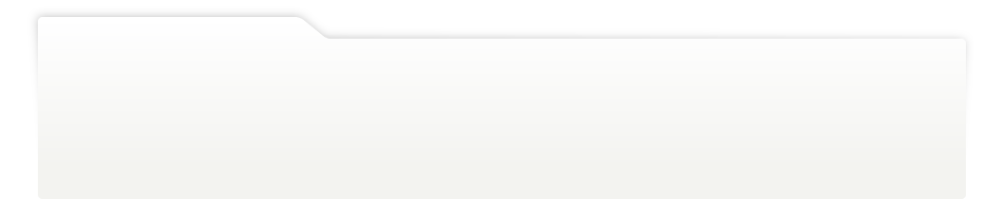
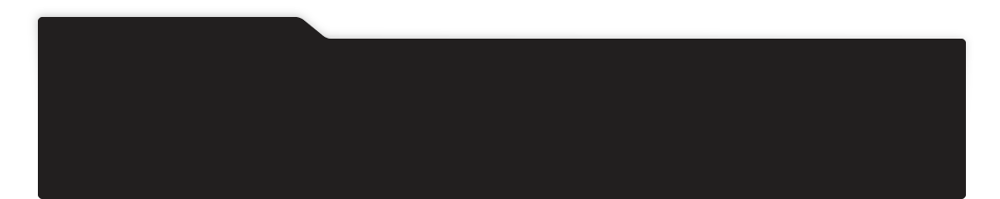
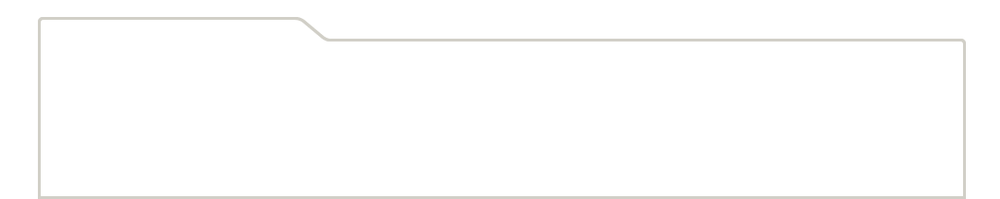
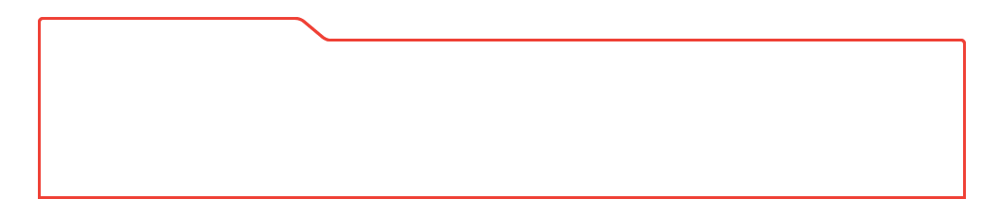
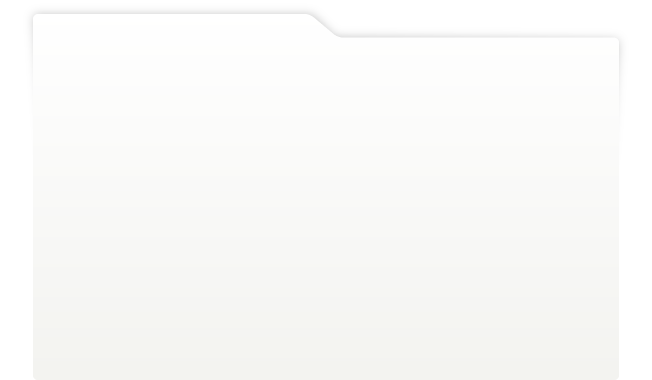
...
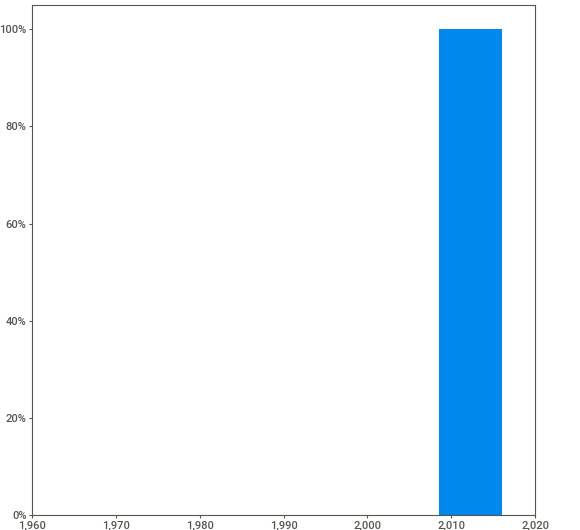
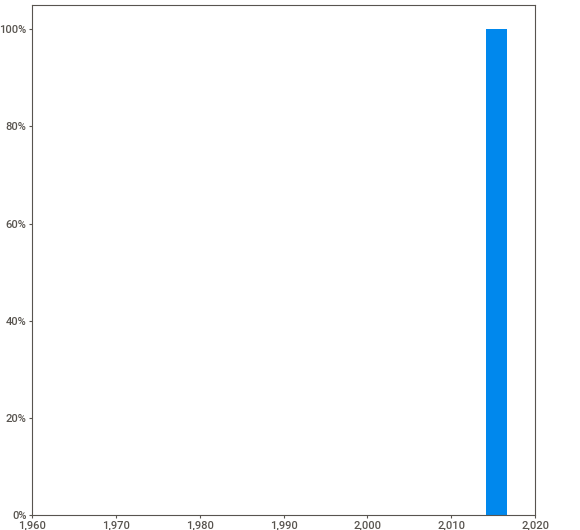
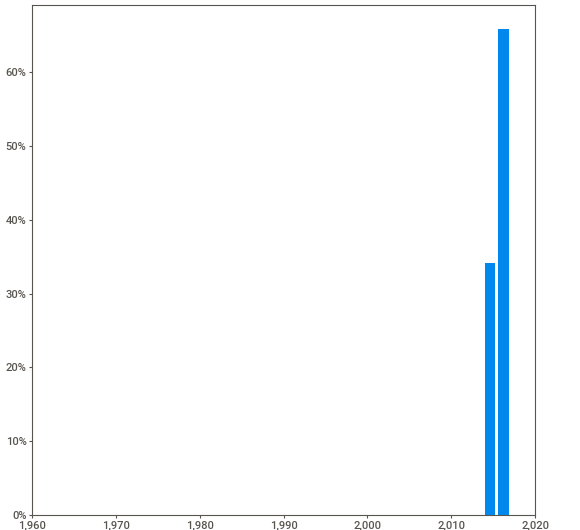
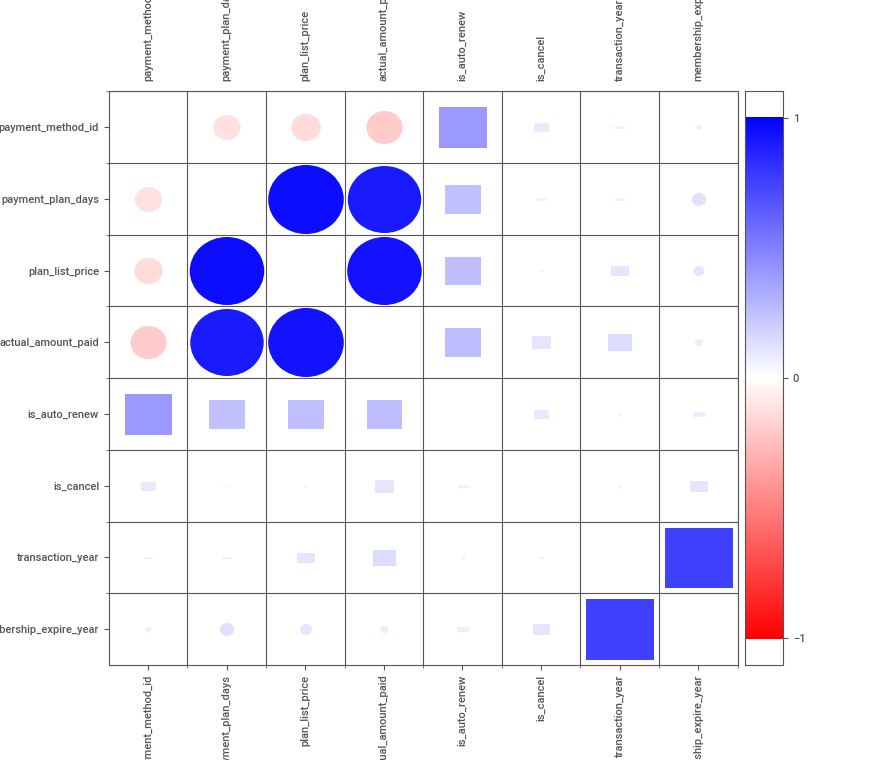
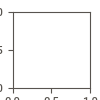

In [ ]:
HTML(filename="SWEETVIZ_REPORT_mod_transactions.html")



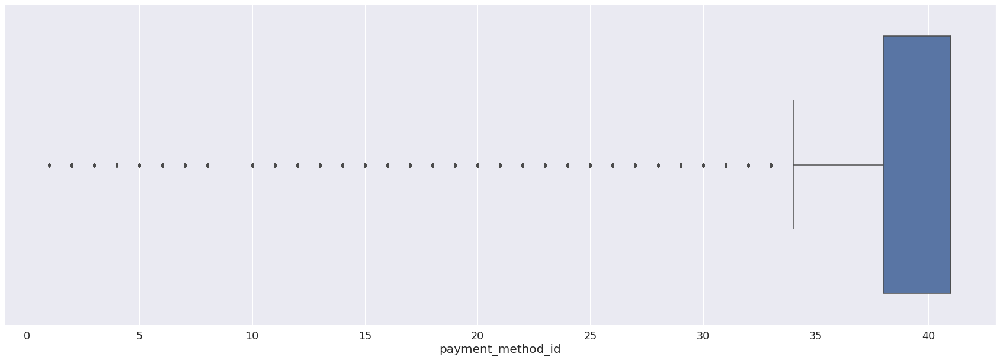

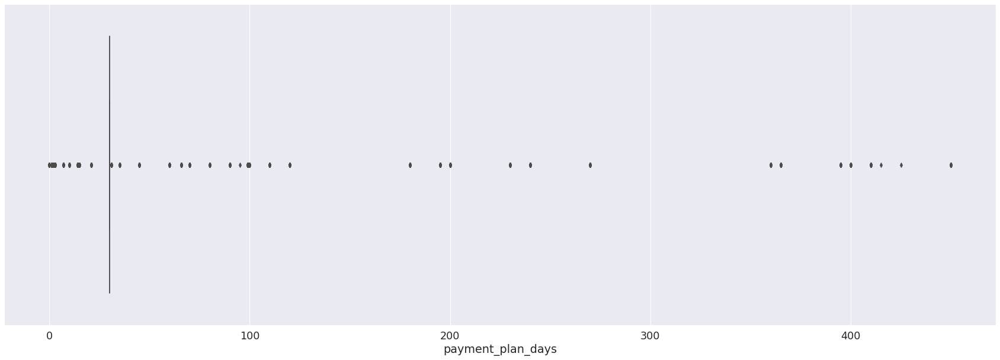

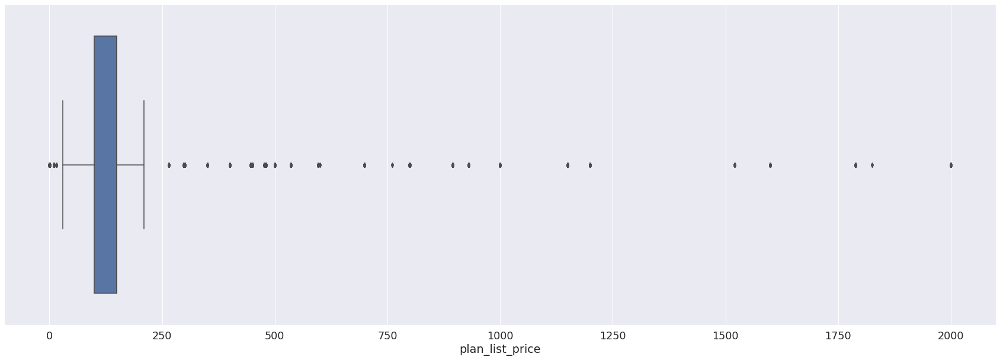

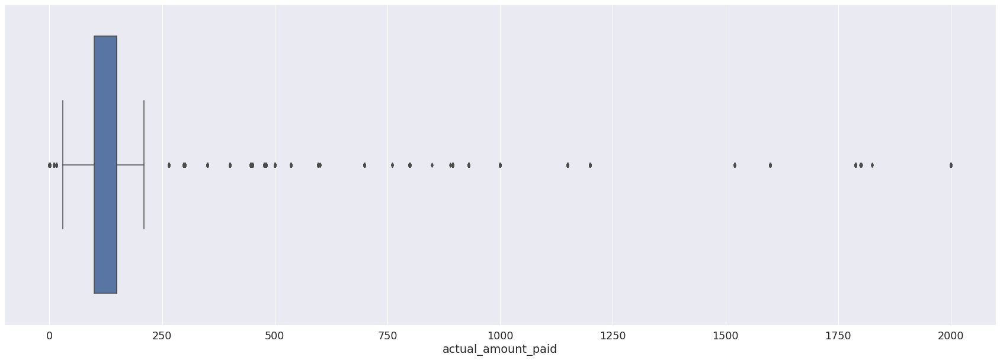

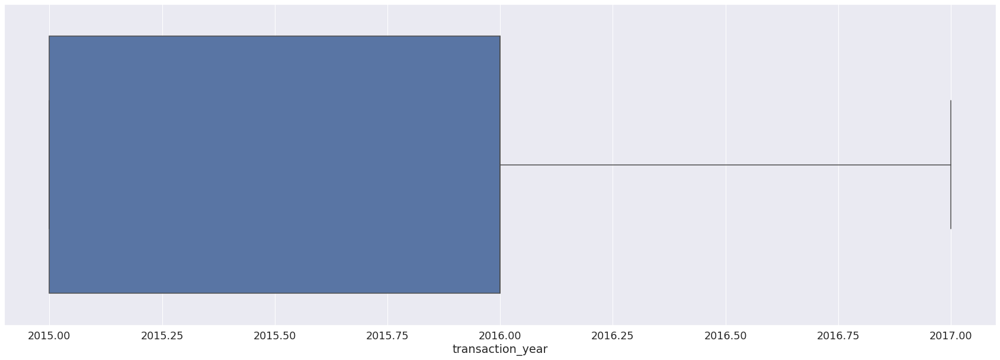

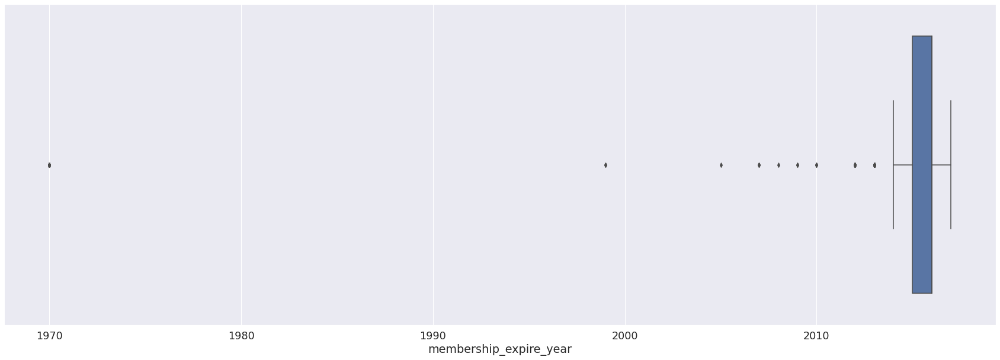

In [ ]:
# Outliers

df = df_transactions_mod

plt.figure(figsize = (30,10))
sns.boxplot(x="payment_method_id", data=df)
plt.xlabel('payment_method_id', fontsize=20)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="payment_plan_days", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="plan_list_price", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="actual_amount_paid", data=df)
plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="is_auto_renew", data=df)
#plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="transaction_date", data=df)
#plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="membership_expire_date", data=df)
#plt.show()


plt.figure(figsize = (30,10))
sns.boxplot(x="transaction_year",  data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="membership_expire_year", data=df)
plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="is_cancel", data=df)
#plt.show()

### Resumo Outliers

1.   **payment_method_id**: Métodos de pagamentos abaixos de 35 são menos comuns, mas não outliers
1.   **payment_plan_days**: a mediana dos dias dos planos de pagamento é 30, mas os valores fora de Q1/Q3 não são necessariamente outliers. apenas menos comuns
1.   **plan_list_price**: segue o mesmo comportamento dos dias dos planos de pagamento
1.   **actual_amount_paid**: segue o mesmo comportamento dos dias dos planos de pagamento
1.   **transaction_year**: Não apresenta outliers
1.   **membership_expire_year**: Apresenta Outliers que devem ser corrigidos

### Analise das variaveis de df_transactions

1.   **msno**: ID dos usuarios
1.   **payment_method_id**: Apresenta dados muito desbalanceados (o método 41 representa 53% dos dados) e "left Skewed"
1.   **payment_plan_days**: Apresenta dados muito desbalanceados (o plano 30 representa 88% dos dados) e "right Skewed"
1.   **plan_list_price**: Apresenta dados muito desbalanceados (o plano 149 representa 58% dos dados) e "right Skewed"
1.   **actual_amount_paid**:  Apresenta dados muito desbalanceados (o valor 149 representa 58% dos dados) e "right Skewed"
1.   **is_auto_renew**: Apresenta dados muito desbalanceados (o valor 1 representa 85% dos dados)
1.   **transaction_date**: as datas estão bem distribuidas
1.   **membership_expire_date**: Apresenta alguns valores "outliers" (exemplo: o valor 19700101 que não faz sentido aparece 1776 vezes)
1.   **is_cancel**: Apresenta dados muito desbalanceados (o valor 1 representa 96% dos dados)














## Transactions + Train (Comportamento do Churn)

In [ ]:
df_train_transactions = pd.merge(df_train, df_transactions_mod, on='msno', how='left')

In [ ]:
df_train_transactions.isnull().sum()

msno                      0
is_churn                  0
payment_method_id         0
payment_plan_days         0
plan_list_price           0
actual_amount_paid        0
is_auto_renew             0
transaction_date          0
membership_expire_date    0
is_cancel                 0
transaction_year          0
membership_expire_year    0
dtype: int64

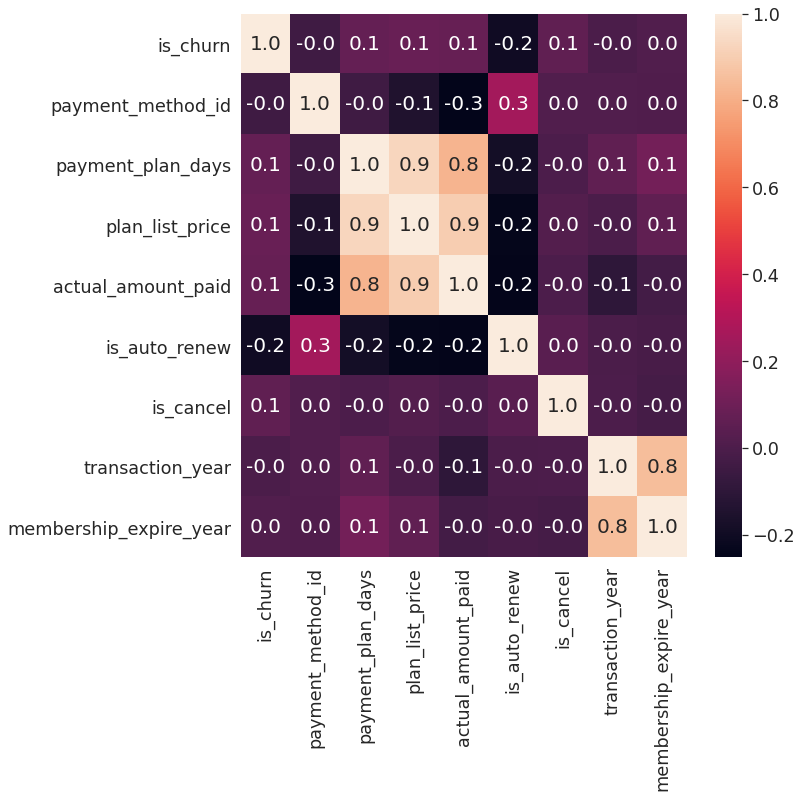

In [ ]:

sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(df_train_transactions.corr(), annot=True, fmt='.1f', annot_kws={"size": 20})

In [ ]:
splot=sns.countplot(x="is_churn", hue="is_churn", data=df, )
for p in splot.patches:
    splot.annotate(format(p.get_height(), '.1f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 9), 
                   textcoords = 'offset points')

plt.xlabel('is_churn', fontsize=30)
plt.ylabel('count', fontsize=30)


sns.set(font_scale = 2)
ax.yaxis.set_major_formatter(StrMethodFormatter('{x:,}'))

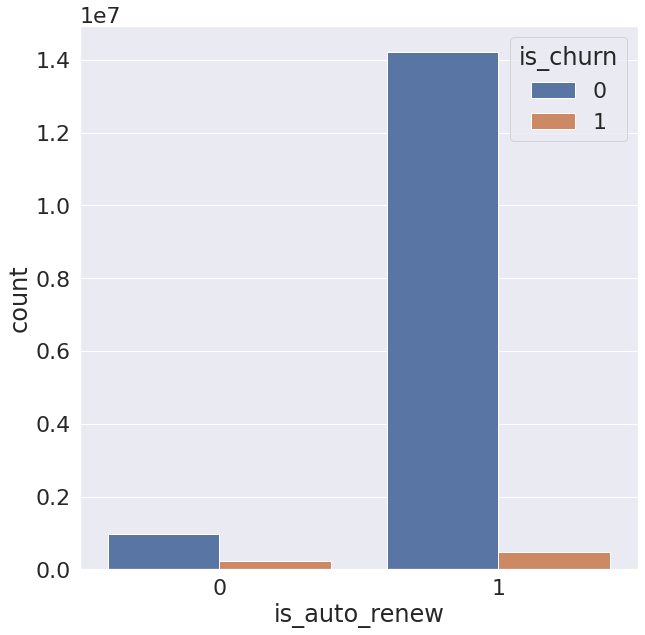

'\nplt.figure(figsize = (25,10))\nsns.countplot(x="transaction_date", hue="is_churn", data=df)\nplt.show()\n\nplt.figure(figsize = (25,10))\nsns.countplot(x="membership_expire_date", hue="is_churn", data=df)\nplt.show()\n\n\nplt.figure(figsize = (25,10))\nsns.countplot(x="transaction_year", hue="is_churn", data=df)\nplt.show()\n\nplt.figure(figsize = (25,10))\nsns.countplot(x="membership_expire_year", hue="is_churn", data=df)\nplt.show()\n\nplt.figure(figsize = (25,10))\nsns.countplot(x="is_cancel", hue="is_churn", data=df)\nplt.show()'

In [ ]:
df = df_train_transactions
'''
plt.figure(figsize = (25,10))
sns.countplot(x="payment_method_id", hue="is_churn", data=df)
plt.xlabel('payment_method_id', fontsize=20)
plt.show()

plt.figure(figsize = (25,10))
sns.countplot(x="payment_plan_days", hue="is_churn", data=df)
plt.show()

plt.figure(figsize = (25,10))
sns.countplot(x="plan_list_price", hue="is_churn", data=df)
plt.show()

plt.figure(figsize = (25,10))
sns.countplot(x="actual_amount_paid", hue="is_churn", data=df)
plt.show()
'''
plt.figure(figsize = (10,10))
sns.countplot(x="is_auto_renew", hue="is_churn", data=df)
plt.show()

sns.set(font_scale = 2)
'''
plt.figure(figsize = (25,10))
sns.countplot(x="transaction_date", hue="is_churn", data=df)
plt.show()

plt.figure(figsize = (25,10))
sns.countplot(x="membership_expire_date", hue="is_churn", data=df)
plt.show()


plt.figure(figsize = (25,10))
sns.countplot(x="transaction_year", hue="is_churn", data=df)
plt.show()

plt.figure(figsize = (25,10))
sns.countplot(x="membership_expire_year", hue="is_churn", data=df)
plt.show()

plt.figure(figsize = (25,10))
sns.countplot(x="is_cancel", hue="is_churn", data=df)
plt.show()'''

### Analise das variaveis de df_train_transactions (comportamento do churn)

**is_churn**: não apresenta forte correlação com as variaveis de df_transaction. Mesmo "is_cancel" que havia desconfiança não apresentou forte correlação. 

Há um forte desbalanceamento entre positivo/negativo churn (1 e 0 respectivamente).

A analise do comportamento de churn em relação as diferentes variaveis de df_transactions não demonstra uma tendencia "obvia" para algum tipo de padrão de comportamento

## Conclusão sobre df_transaction

Para evitarmos problemas de multicolinearidade: 

1.   Retirar as variaveis **actual_amount_paid** e **plan_list_price**. Manter a variavel **payment_plan_days**
1.   Retirar as variaveis **membership_expire_date** e **membership_expire_year**. Manter a variavel **transaction_date** e **transaction_year**
1.   Os outliers de  **membership_expire_date** serão removidos ao excluir o item acima


## user_logs.csv

In [ ]:
df_user_logs_group_all_final.columns

Index(['msno', 'num_25_sum', 'num_25_min', 'num_25_mean', 'num_50_sum',
       'num_50_min', 'num_50_mean', 'num_985_sum', 'num_985_min',
       'num_985_mean', 'num_100_sum', 'num_100_min', 'num_100_mean',
       'total_secs_sum', 'total_secs_min', 'total_secs_mean', 'num_unq_sum',
       'num_unq_min', 'num_unq_mean'],
      dtype='object')

In [ ]:
df_user_logs_group_all_final.shape

(5234111, 19)

In [ ]:
df_user_logs_group_all_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5234111 entries, 0 to 5234110
Data columns (total 19 columns):
 #   Column           Dtype  
---  ------           -----  
 0   msno             object 
 1   num_25_sum       int64  
 2   num_25_min       int64  
 3   num_25_mean      float64
 4   num_50_sum       int64  
 5   num_50_min       int64  
 6   num_50_mean      float64
 7   num_985_sum      int64  
 8   num_985_min      int64  
 9   num_985_mean     float64
 10  num_100_sum      int64  
 11  num_100_min      int64  
 12  num_100_mean     float64
 13  total_secs_sum   float64
 14  total_secs_min   float64
 15  total_secs_mean  float64
 16  num_unq_sum      int64  
 17  num_unq_min      int64  
 18  num_unq_mean     float64
dtypes: float64(8), int64(10), object(1)
memory usage: 758.7+ MB


In [ ]:
df_user_logs_group_all_final.head()

,msno,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean
0,+++4vcS9aMH7KWdfh5git6nA5fC5jjisd5H/NcM++WM=,1,1,1.000000,1,1,1.000000,0,0,0.000000,0,0,0.000000,9.741100e+01,97.411,97.411000,2,2,2.000000
1,+++EI4HgyhgcJHIPXk/VRP7bt17+2joG39T6oEfJ+tc=,2,2,2.000000,0,0,0.000000,0,0,0.000000,0,0,0.000000,5.686800e+01,56.868,56.868000,1,1,1.000000
2,+++FOrTS7ab3tIgIh8eWwX4FqRv8w/FoiOuyXsFvphY=,60,0,8.571429,12,0,1.714286,7,0,1.000000,171,3,24.428571,4.999677e+04,834.189,7142.395857,179,2,25.571429
3,+++IZseRRiQS9aaSkH6cMYU6bGDcxUieAi/tH67sC5s=,817,0,1.313505,249,0,0.400322,195,0,0.313505,59354,0,95.424437,1.466484e+07,4.532,23576.915444,53604,1,86.180064
4,+++TipL0Kt3JvgNE9ahuJ8o+drJAnQINtxD4c5GePXI=,3,3,3.000000,3,3,3.000000,1,1,1.000000,14,14,14.000000,3.661527e+03,3661.527,3661.527000,22,22,22.000000


In [ ]:
df_user_logs_group_all_final.tail()

,msno,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean
5234106,zzzeSzWGUrQw+eP47oa1CXqL/im1Uq6/JYAJs8oGjI8=,2,2,2.000000,2,2,2.000000,0,0,0.000000,2,2,2.000000,733.143,733.143,733.143000,6,6,6.000000
5234107,zzzqx+aMPSFYjW71JqJ6T/hita+iVemVWzJTE4yQRx8=,4,0,2.000000,2,0,1.000000,1,0,0.500000,18,1,9.000000,4610.743,219.220,2305.371500,24,1,12.000000
5234108,zzztPAN9xjMytpZ0RN2gU9mScDULJnHQZK8eZb4uELU=,42,0,1.750000,16,0,0.666667,7,0,0.291667,21,0,0.875000,9192.670,62.760,383.027917,81,1,3.375000
5234109,zzztsqkufVj9DPVJDM3FxDkhlbCL5z4aiYxgPSGkIK4=,13,0,0.866667,5,0,0.333333,4,0,0.266667,70,1,4.666667,18739.562,216.383,1249.304133,61,1,4.066667
5234110,zzzyOgMk9MljCerbCCYrVtvu85aSCiy7yCMjAEgNYMs=,17,17,17.000000,23,23,23.000000,3,3,3.000000,0,0,0.000000,3390.248,3390.248,3390.248000,47,47,47.000000


In [ ]:
df_user_logs_group_all_final.describe()

,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean
count,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06,5.234111e+06
mean,4.878578e+02,1.898615e+00,6.013398e+00,1.228804e+02,4.877254e-01,1.661299e+00,8.455263e+01,1.680325e-01,7.693518e-01,2.301406e+03,2.455151e+00,1.368686e+01,-1.082389e+14,-5.273810e+13,-3.317576e+11,2.254164e+03,4.927938e+00,1.677951e+01
std,1.617936e+03,6.892398e+00,1.022634e+01,3.703220e+02,2.412278e+00,3.513445e+00,3.007422e+02,8.478056e-01,1.468650e+00,7.479736e+03,8.151179e+00,2.046929e+01,2.324801e+15,6.954437e+14,1.411610e+13,6.522137e+03,1.036117e+01,1.824278e+01
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-6.917529e+17,-9.223372e+15,-9.223372e+15,1.000000e+00,1.000000e+00,1.000000e+00
25%,3.000000e+00,0.000000e+00,1.370135e+00,1.000000e+00,0.000000e+00,2.500000e-01,0.000000e+00,0.000000e+00,0.000000e+00,2.000000e+00,0.000000e+00,1.000000e+00,1.025253e+03,4.041100e+01,5.969890e+02,8.000000e+00,1.000000e+00,4.000000e+00
50%,1.500000e+01,0.000000e+00,3.333333e+00,4.000000e+00,0.000000e+00,1.000000e+00,2.000000e+00,0.000000e+00,5.000000e-01,2.400000e+01,0.000000e+00,7.166667e+00,7.664507e+03,2.096070e+02,2.301310e+03,4.100000e+01,2.000000e+00,1.180000e+01
75%,1.470000e+02,1.000000e+00,7.000000e+00,4.100000e+01,0.000000e+00,2.000000e+00,2.300000e+01,0.000000e+00,1.000000e+00,4.960000e+02,2.000000e+00,1.878200e+01,1.230398e+05,6.743795e+02,5.215057e+03,5.710000e+02,4.000000e+00,2.300000e+01
max,9.114170e+05,2.529000e+03,2.529000e+03,5.274700e+04,1.414000e+03,1.414000e+03,1.014050e+05,3.020000e+02,4.024008e+02,7.873280e+05,3.099000e+03,9.046167e+03,9.223372e+15,3.133618e+07,1.844674e+14,2.680470e+05,9.330000e+02,1.308240e+03


In [ ]:
df_user_logs_group_all_final.isnull().sum()

msno               0
num_25_sum         0
num_25_min         0
num_25_mean        0
num_50_sum         0
num_50_min         0
num_50_mean        0
num_985_sum        0
num_985_min        0
num_985_mean       0
num_100_sum        0
num_100_min        0
num_100_mean       0
total_secs_sum     0
total_secs_min     0
total_secs_mean    0
num_unq_sum        0
num_unq_min        0
num_unq_mean       0
dtype: int64

In [ ]:
df_user_logs_group_all_final.duplicated().value_counts()

False    5234111
dtype: int64

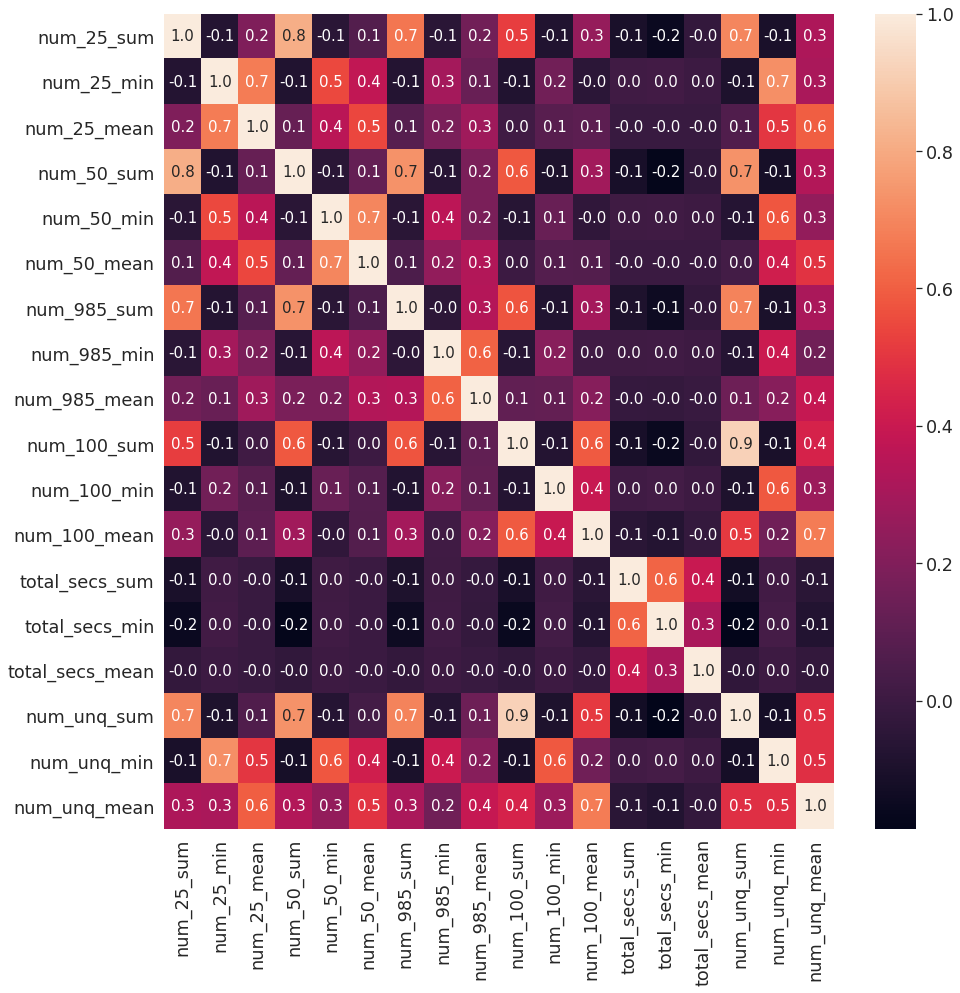

In [ ]:


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(15,15)) 
sns.heatmap(df_user_logs_group_all_final.corr(), annot=True, fmt='.1f', annot_kws={"size": 15})

### Resumo Correlação & Null Values: 

1.   **Null values**: Não foram identificados valores nulos
2.   **Correlação**: Apesar das variaveis de logs apresentarem correlação média/alta a combinação unica de cada usuario pode ser fator para identificação do churn

In [ ]:
# Gerar o relatorio HTML abaixo
my_report = sv.analyze(df_user_logs_group_all_final)
my_report.show_html()

                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



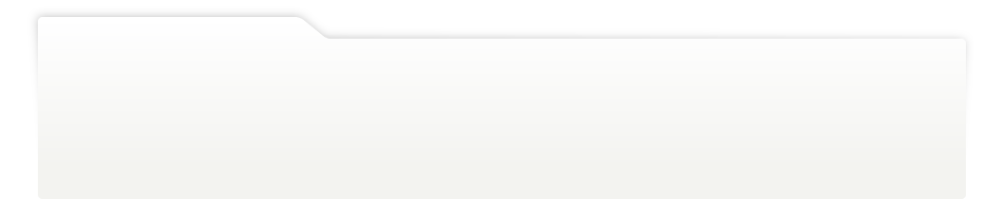
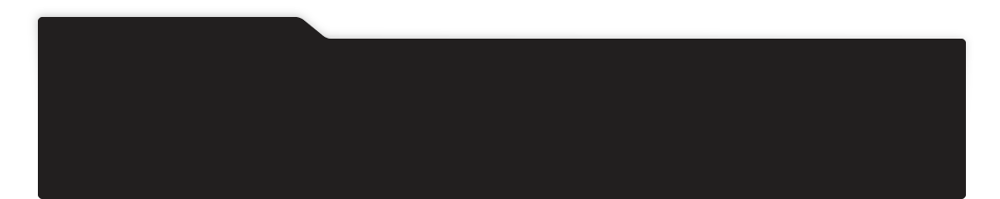
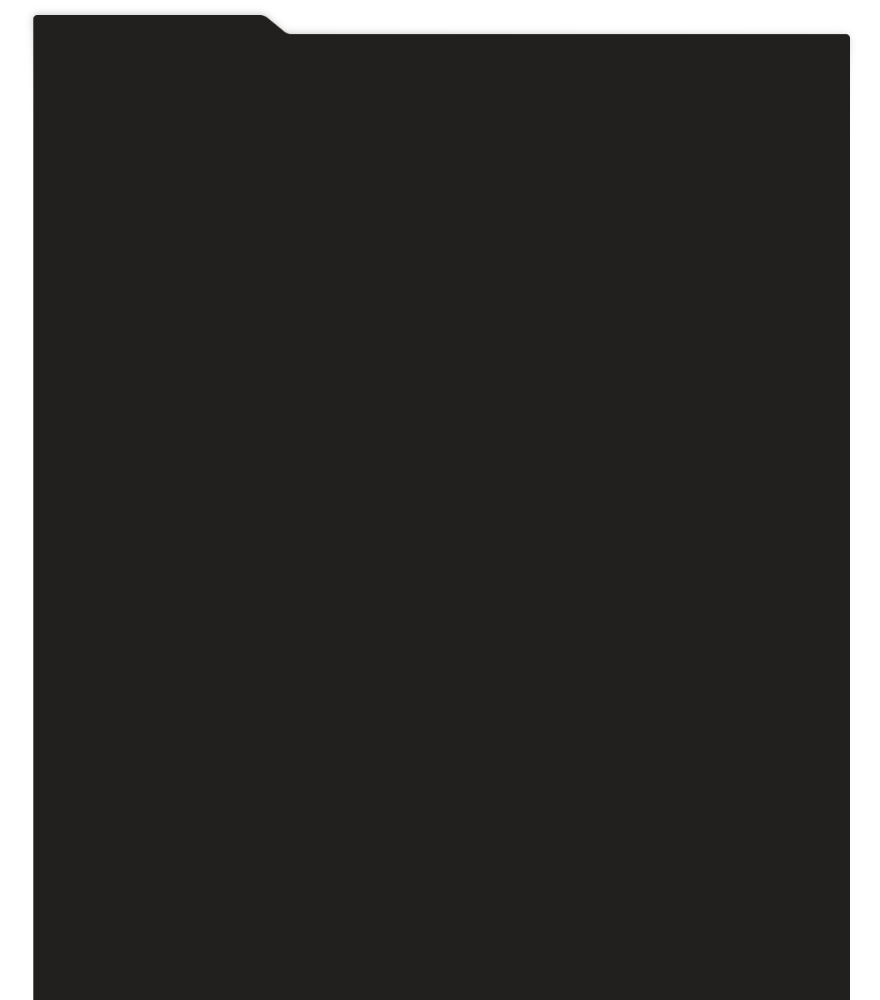
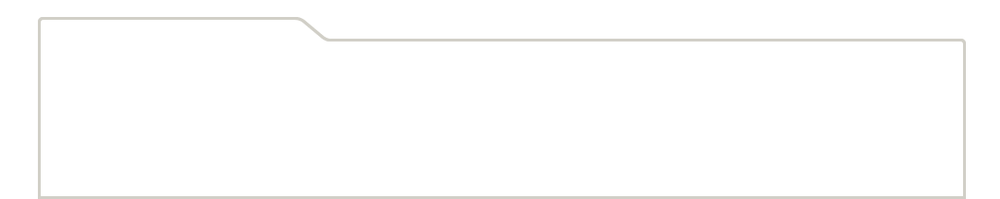
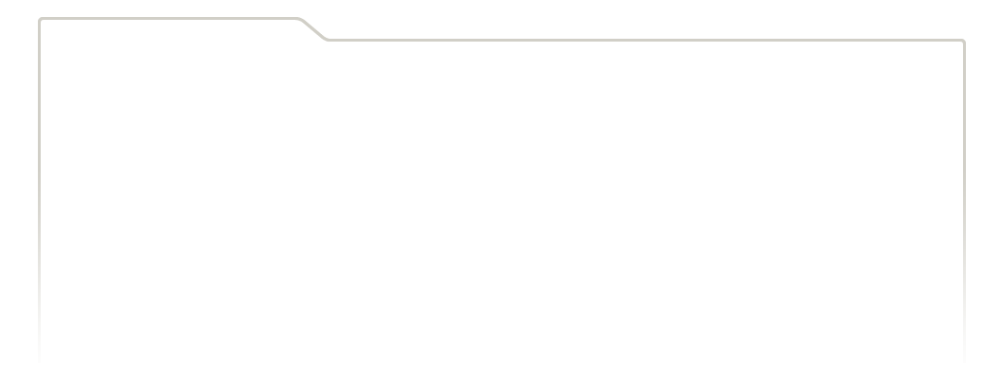
...
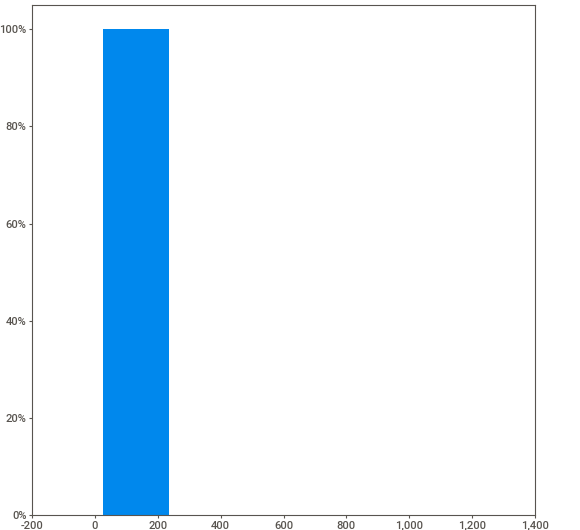
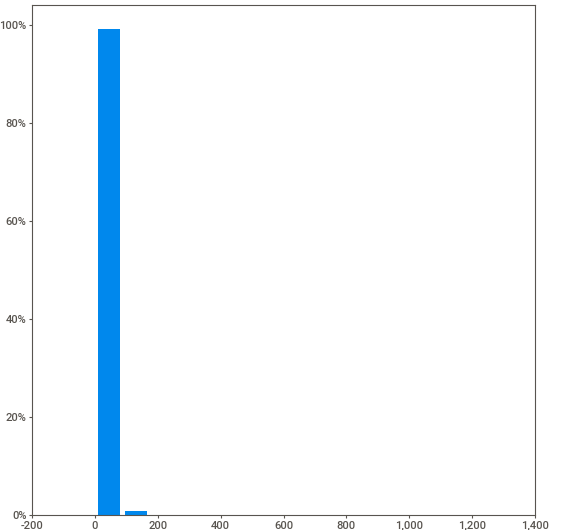
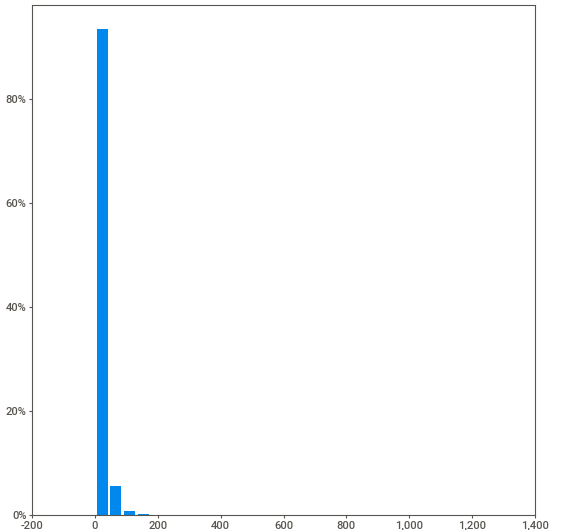
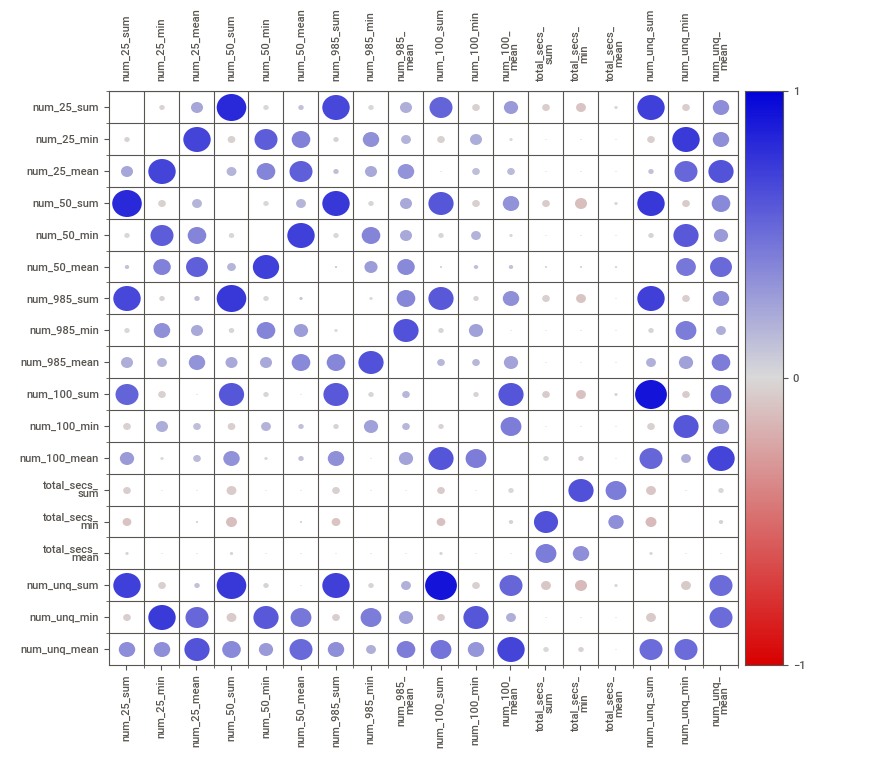
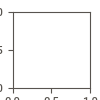

In [ ]:
HTML(filename="SWEETVIZ_REPORT_user_logs_group_all_final.html")



In [ ]:
df_user_logs_group_all_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5234111 entries, 0 to 5234110
Data columns (total 19 columns):
 #   Column           Dtype  
---  ------           -----  
 0   msno             object 
 1   num_25_sum       int64  
 2   num_25_min       int64  
 3   num_25_mean      float64
 4   num_50_sum       int64  
 5   num_50_min       int64  
 6   num_50_mean      float64
 7   num_985_sum      int64  
 8   num_985_min      int64  
 9   num_985_mean     float64
 10  num_100_sum      int64  
 11  num_100_min      int64  
 12  num_100_mean     float64
 13  total_secs_sum   float64
 14  total_secs_min   float64
 15  total_secs_mean  float64
 16  num_unq_sum      int64  
 17  num_unq_min      int64  
 18  num_unq_mean     float64
dtypes: float64(8), int64(10), object(1)
memory usage: 758.7+ MB


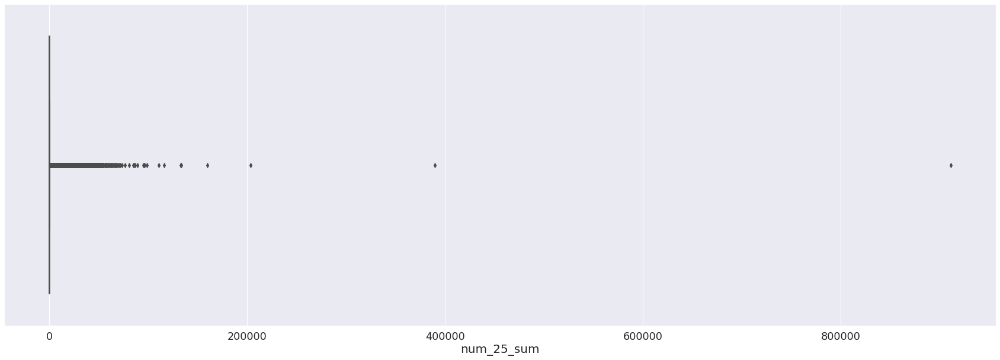

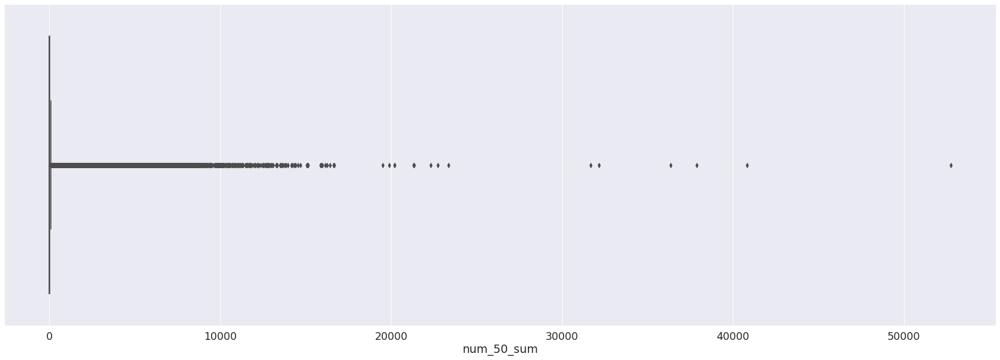

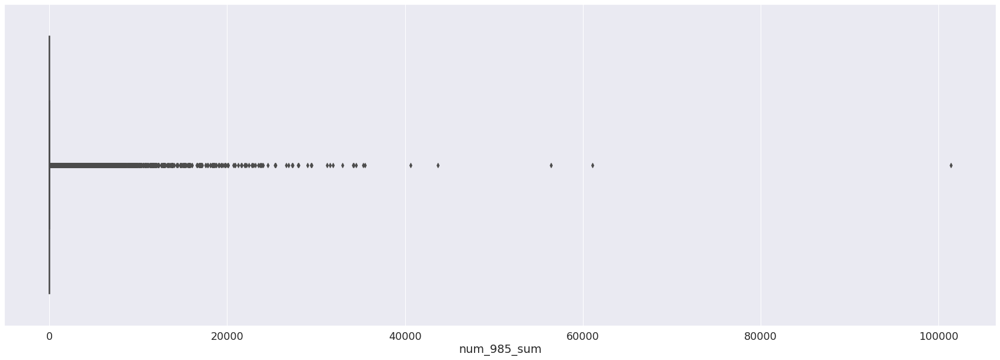

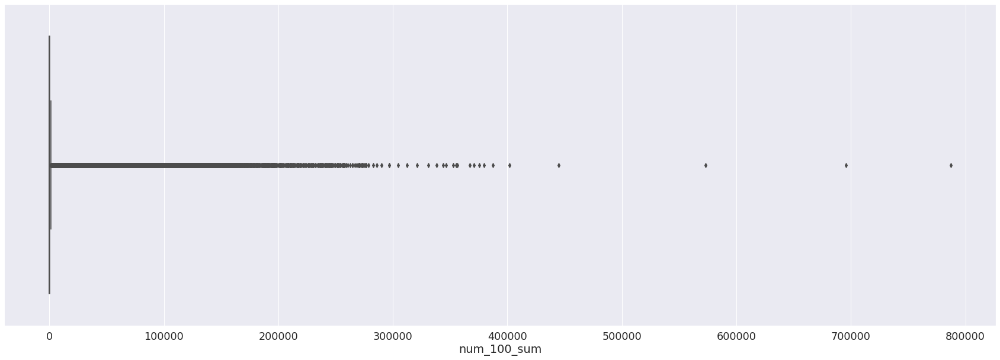

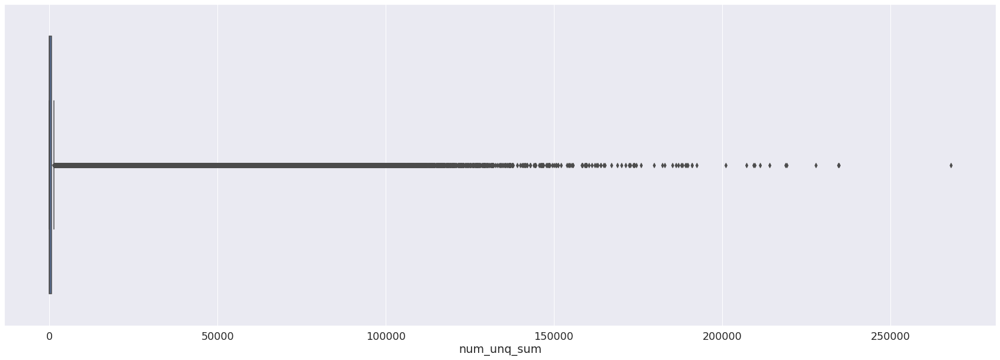

...

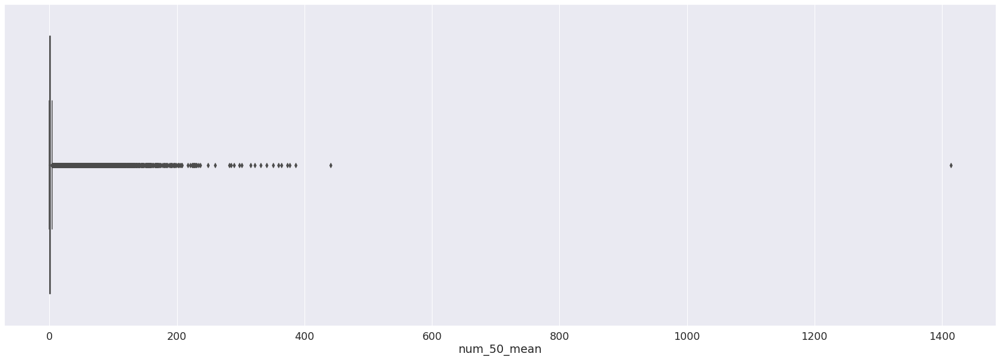

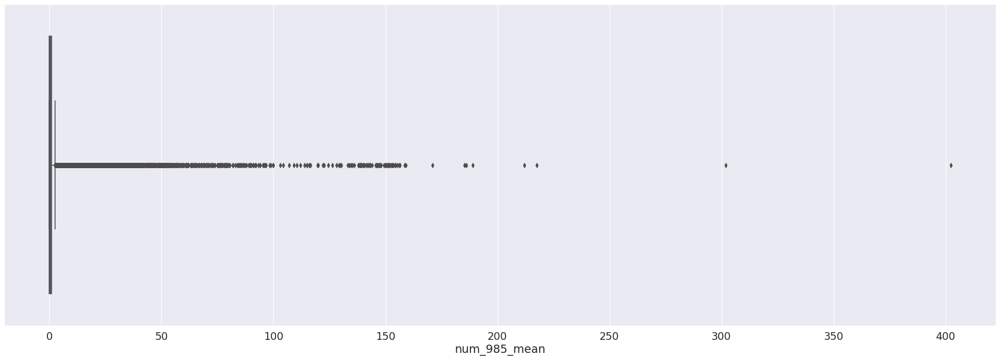

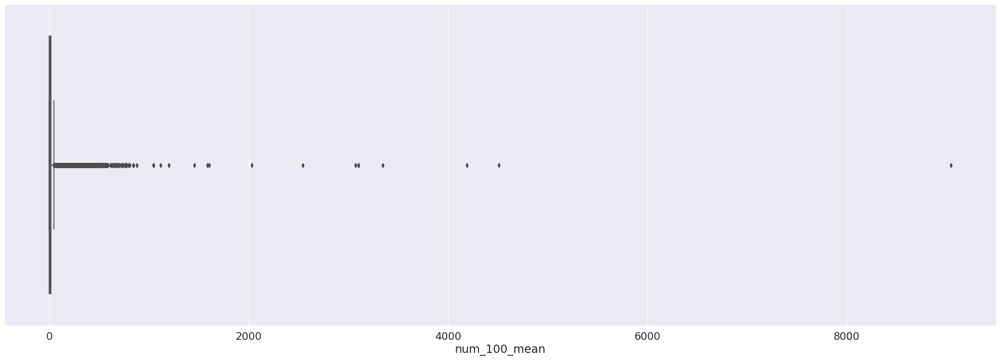

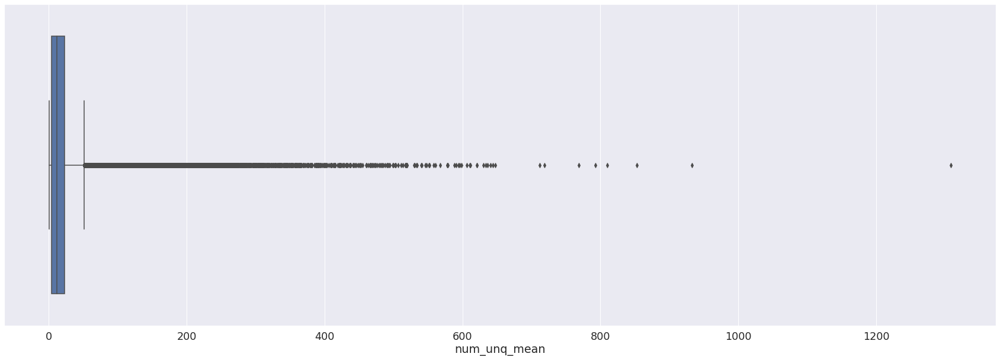

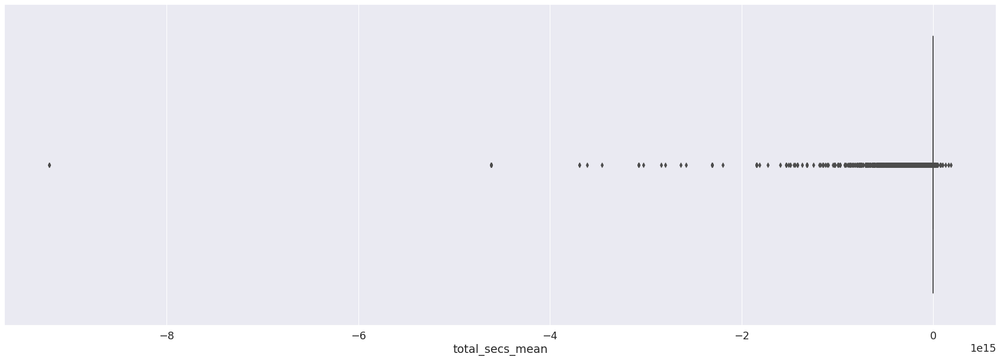

In [ ]:
# Outliers

df = df_user_logs_group_all_final

#plt.figure(figsize = (30,10))
#sns.boxplot(x="date", data=df)
#plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_25_sum", data=df)
plt.xlabel('num_25_sum', fontsize=20)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_50_sum", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_985_sum", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_100_sum", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_unq_sum", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="total_secs_sum", data=df)
plt.show()


plt.figure(figsize = (30,10))
sns.boxplot(x="num_25_min", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_50_min", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_985_min", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_100_min", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_unq_min", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="total_secs_min", data=df)
plt.show()


plt.figure(figsize = (30,10))
sns.boxplot(x="num_25_mean", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_50_mean", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_985_mean", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_100_mean", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="num_unq_mean", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="total_secs_mean", data=df)
plt.show()


### Resumo Outliers

1.   **num_25**: Apesar de parecer possuir outliers, não é possivel afirmar sem conhecer o comportamento do usuario
1.   **num_50**: Apesar de parecer possuir outliers, não é possivel afirmar sem conhecer o comportamento do usuario. apenas menos comuns
1.   **num_75**: Apesar de parecer possuir outliers, não é possivel afirmar sem conhecer o comportamento do usuario
1.   **num_985**: Apesar de parecer possuir outliers, não é possivel afirmar sem conhecer o comportamento do usuario
1.   **num_100**: Apesar de parecer possuir outliers, não é possivel afirmar sem conhecer o comportamento do usuario
1.   **num_unq**: Apesar de parecer possuir outliers, não é possivel afirmar sem conhecer o comportamento do usuario


### Analise das variaveis de df_user_logs

1.   **msno**: ID dos usuarios
1.   **date**: Os valores foram construido no modelo "Ano-mês-dia" dessa forma os valores organizados em ordem crescente mantem a ordem cronologica. Dessa forma é possivel verifica um aumento rápido de logs nas datas mais "atuais"

Analise com o grafico countplot abaixo
1.   **num_25**: graficos apresentam um comportamento exponencial decrescente
1.   **num_50**: graficos apresentam um comportamento exponencial decrescente
1.   **num_75**:  graficos apresentam um comportamento exponencial decrescente
1.   **num_985**: graficos apresentam um comportamento exponencial decrescente
1.   **num_100**: graficos apresentam um comportamento exponencial decrescente
1.   **num_unq**: graficos apresentam um comportamento exponencial decrescente





## User_logs + Train (Comportamento do Churn)

In [ ]:
df_train_user_logs = pd.merge(df_train, df_user_logs_group_all_final, on='msno', how='left')

In [ ]:
df_train_user_logs.isnull().sum()

msno                    0
is_churn                0
num_25_sum         123005
num_25_min         123005
num_25_mean        123005
num_50_sum         123005
num_50_min         123005
num_50_mean        123005
num_985_sum        123005
num_985_min        123005
num_985_mean       123005
num_100_sum        123005
num_100_min        123005
num_100_mean       123005
total_secs_sum     123005
total_secs_min     123005
total_secs_mean    123005
num_unq_sum        123005
num_unq_min        123005
num_unq_mean       123005
dtype: int64

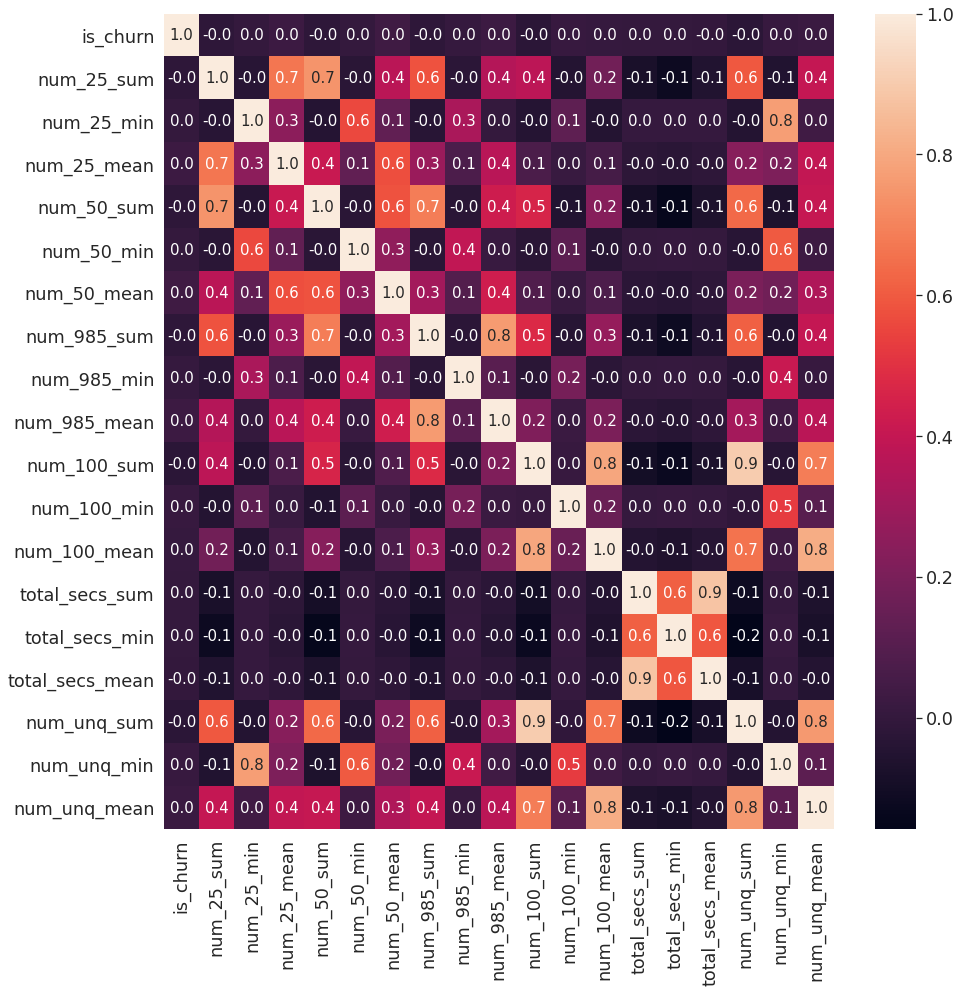

In [ ]:

sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(15,15)) 
sns.heatmap(df_train_user_logs.corr(), annot=True, fmt='.1f', annot_kws={"size": 15})

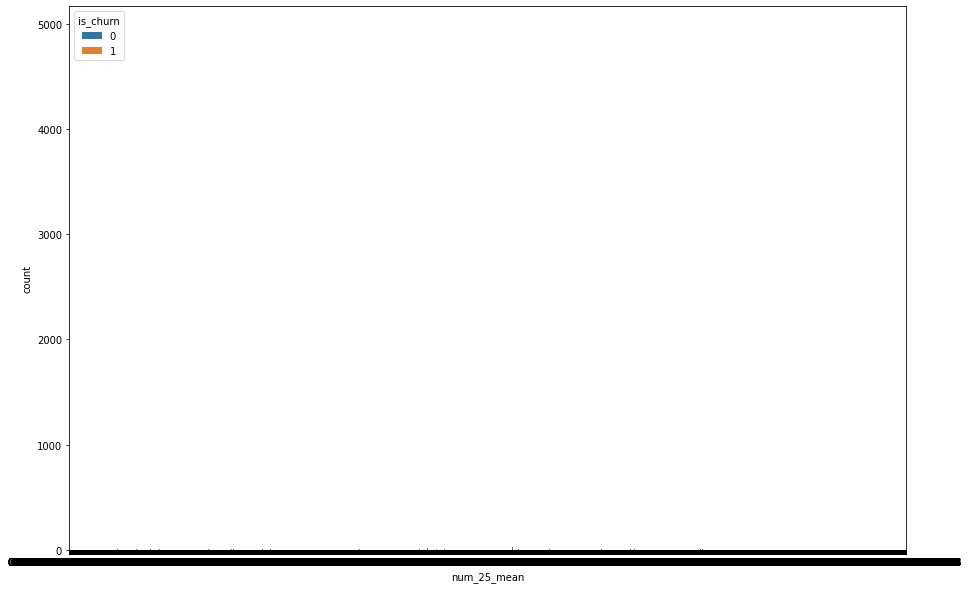

KeyboardInterrupt: ignored

In [ ]:
df = df_train_user_logs

plt.figure(figsize = (15,10))
sns.countplot(x="num_25_mean", hue="is_churn", data=df)
plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_50_mean", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_985_mean", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_100_mean", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_unq_mean", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="total_secs_mean", hue="is_churn", data=df)
#plt.show()




#plt.figure(figsize = (15,10))
#sns.countplot(x="num_25_min", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_50_min", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_985_min", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_100_min", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_unq_min", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="total_secs_min", hue="is_churn", data=df)
#plt.show()




#plt.figure(figsize = (15,10))
#sns.countplot(x="num_25_sum", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_50_sum", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_985_sum", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_100_sum", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="num_unq_sum", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (15,10))
#sns.countplot(x="total_secs_sum", hue="is_churn", data=df)
#plt.show()



### Analise das variaveis de df_train_user_logs (comportamento do churn)

**is_churn**: apresenta correlação com as variaveis de df_user_logs. Nas diferentes frações de músicas tocadas quanto mais proximo de zero musicas tocadas maior a chance de ocorrencia do churn. 

Há um forte desbalanceamento entre positivo/negativo churn (1 e 0 respectivamente).

## Conclusão sobre df_user_logs

Para evitarmos problemas de multicolinearidade: 

1.   Retirar a variavel **num_75**. Manter a variavel **num_50**
1.   Retirar a variavel **num_nqn**. Manter a variavel **num_100**
1.   A variavel **total_secs** necessita de preprocessing para outliers

## members.csv

In [ ]:
df_members.columns

Index(['msno', 'city', 'bd', 'gender', 'registered_via',
       'registration_init_time'],
      dtype='object')

In [ ]:
df_members.shape

(6769473, 6)

In [ ]:
df_members.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6769473 entries, 0 to 6769472
Data columns (total 6 columns):
 #   Column                  Dtype 
---  ------                  ----- 
 0   msno                    object
 1   city                    int64 
 2   bd                      int64 
 3   gender                  object
 4   registered_via          int64 
 5   registration_init_time  int64 
dtypes: int64(4), object(2)
memory usage: 309.9+ MB


In [ ]:
# modificar a variavel "registration_init_time" para datetime
df_members_mod = df_members

In [ ]:
df_members_mod['registration_init_time'] =  pd.to_datetime(df_members_mod['registration_init_time'], format='%Y%m%d')

In [ ]:
# Criar uma coluna apenas com anos
df_members_mod['registration_init_year'] = pd.DatetimeIndex(df_members_mod['registration_init_time']).year


In [ ]:
# Transformar a variavel "gender" em dummies

df_members_mod = pd.get_dummies(data = df_members_mod, columns = ["gender"], dummy_na = True) 

In [ ]:
df_members_mod.head()

,msno,city,bd,registered_via,registration_init_time,registration_init_year,gender_female,gender_male,gender_nan
0,Rb9UwLQTrxzBVwCB6+bCcSQWZ9JiNLC9dXtM1oEsZA8=,1,0,11,2011-09-11,2011,0,0,1
1,+tJonkh+O1CA796Fm5X60UMOtB6POHAwPjbTRVl/EuU=,1,0,7,2011-09-14,2011,0,0,1
2,cV358ssn7a0f7jZOwGNWS07wCKVqxyiImJUX6xcIwKw=,1,0,11,2011-09-15,2011,0,0,1
3,9bzDeJP6sQodK73K5CBlJ6fgIQzPeLnRl0p5B77XP+g=,1,0,11,2011-09-15,2011,0,0,1
4,WFLY3s7z4EZsieHCt63XrsdtfTEmJ+2PnnKLH5GY4Tk=,6,32,9,2011-09-15,2011,1,0,0


In [ ]:
df_members_mod.tail()

,msno,city,bd,registered_via,registration_init_time,registration_init_year,gender_female,gender_male,gender_nan
6769468,VSGkb3hyBRUtb/b1MQUZbvOkktS3vKLnhMHW0CF8eyU=,1,0,7,2015-10-20,2015,0,0,1
6769469,nWjH7glPkZ7jOVaCRwwjlpmp0T1hSWdv8hMJxiWCwKc=,1,0,7,2015-10-20,2015,0,0,1
6769470,GH+b5+1tlv7ZZXsA8upBzVXMTLyffKcsF7WoU8b5rOI=,15,26,4,2015-10-20,2015,1,0,0
6769471,XVlwT3fdCFGKqerEKBzUIjK+jzI6jzSke4cDMVhYyjE=,1,0,4,2015-10-20,2015,0,0,1
6769472,isBt+JlgvZRNy6lxVr5vvuJ4lD00ofTaKyJ+uRnGcPg=,1,0,4,2015-10-21,2015,0,0,1


In [ ]:
df_members_mod.describe()

,city,bd,registered_via,registration_init_year,gender_female,gender_male,gender_nan
count,6.769473e+06,6.769473e+06,6.769473e+06,6.769473e+06,6.769473e+06,6.769473e+06,6.769473e+06
mean,3.847358e+00,9.795794e+00,5.253069e+00,2.014451e+03,1.690845e-01,1.765802e-01,6.543353e-01
std,5.478359e+00,1.792590e+01,2.361398e+00,2.323070e+00,3.748266e-01,3.813131e-01,4.755845e-01
min,1.000000e+00,-7.168000e+03,-1.000000e+00,2.004000e+03,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.000000e+00,0.000000e+00,4.000000e+00,2.014000e+03,0.000000e+00,0.000000e+00,0.000000e+00
50%,1.000000e+00,0.000000e+00,4.000000e+00,2.015000e+03,0.000000e+00,0.000000e+00,1.000000e+00
75%,4.000000e+00,2.100000e+01,7.000000e+00,2.016000e+03,0.000000e+00,0.000000e+00,1.000000e+00
max,2.200000e+01,2.016000e+03,1.900000e+01,2.017000e+03,1.000000e+00,1.000000e+00,1.000000e+00


In [ ]:
df_members_mod.isnull().sum()

msno                      0
city                      0
bd                        0
registered_via            0
registration_init_time    0
registration_init_year    0
gender_female             0
gender_male               0
gender_nan                0
dtype: int64

In [ ]:
df_members_mod.duplicated().value_counts()

False    6769473
dtype: int64

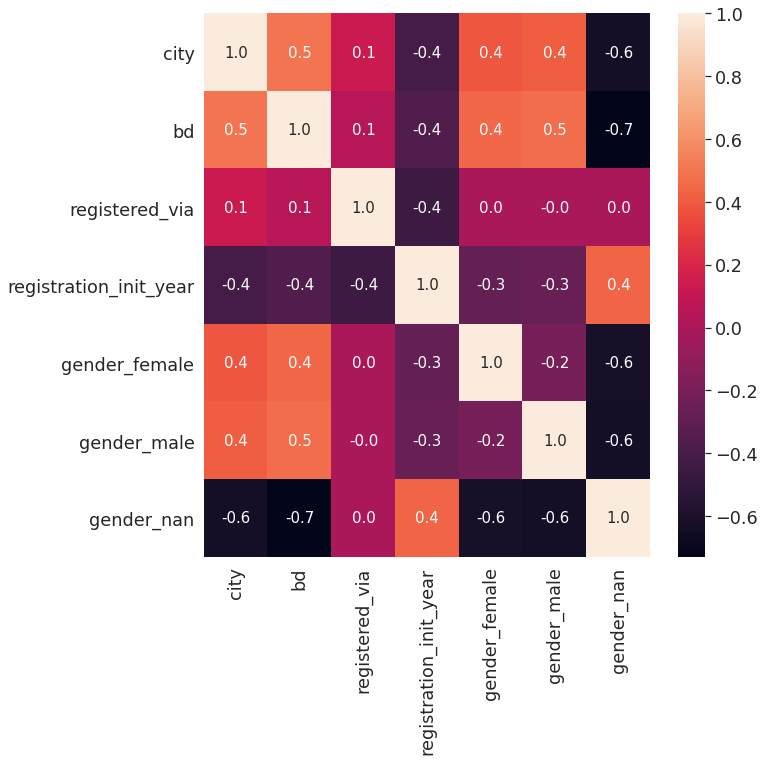

In [ ]:


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(df_members_mod.corr(), annot=True, fmt='.1f', annot_kws={"size": 15})

### Correlação & Null Values


1.   **Null values**: Não foram identificados valores nulos
2.   **Correlação**: Não foram identificadas correlações relevantes que necessitam de tratamento

In [ ]:
#my_report = sv.analyze(df_members)
#my_report.show_html()


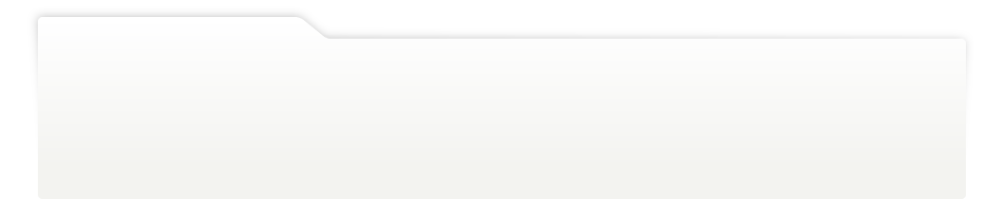
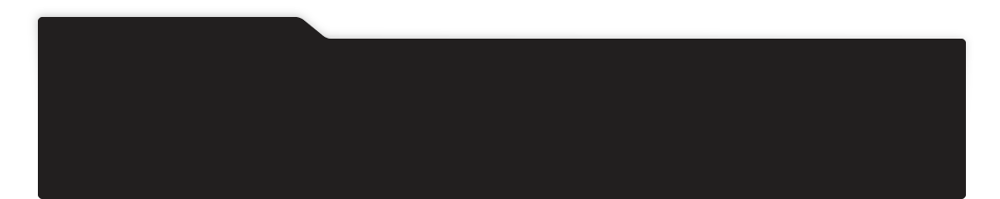
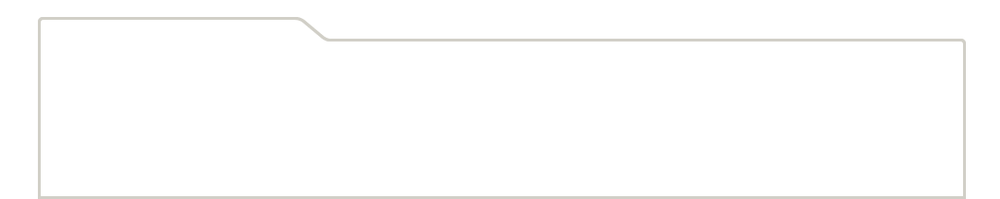
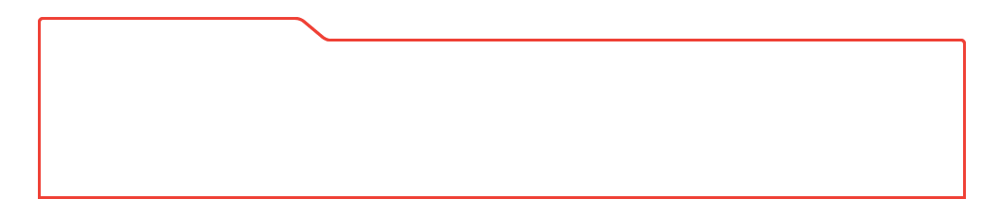
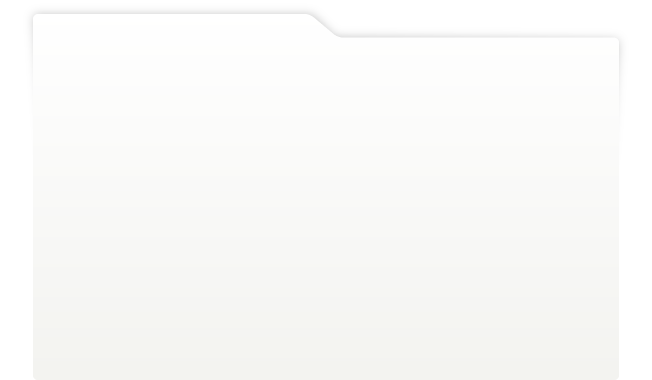
...
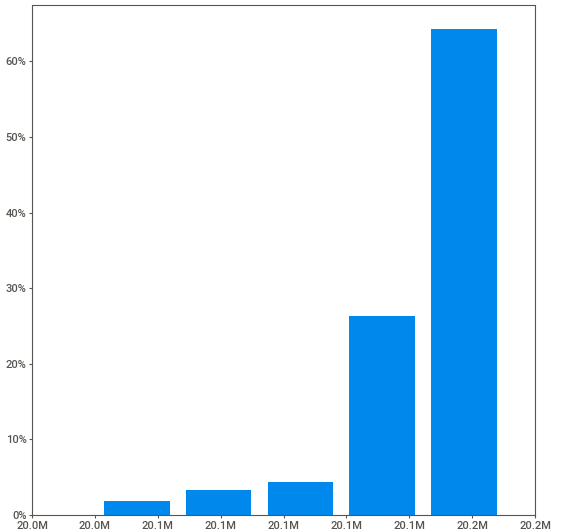
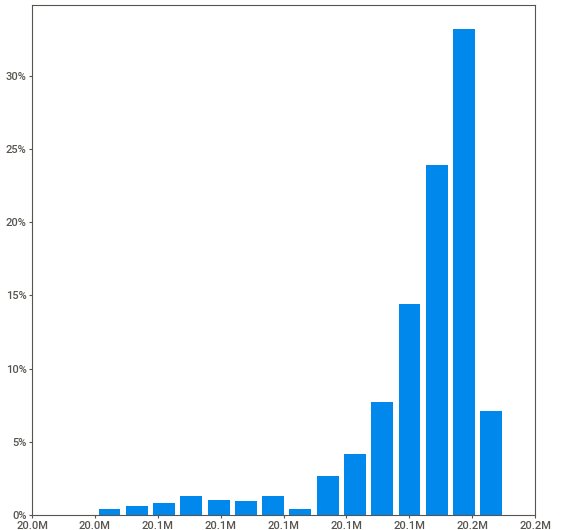
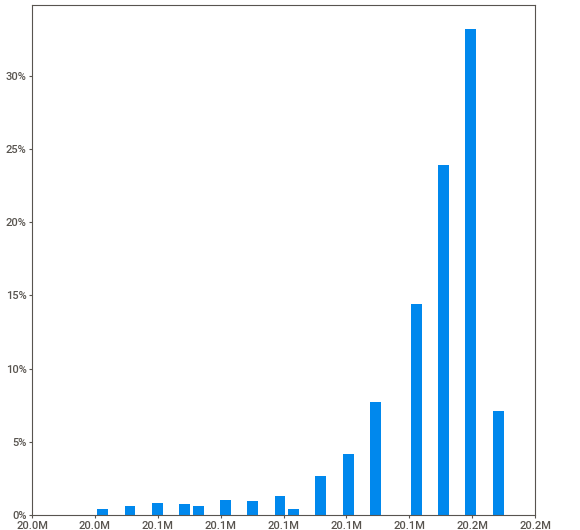
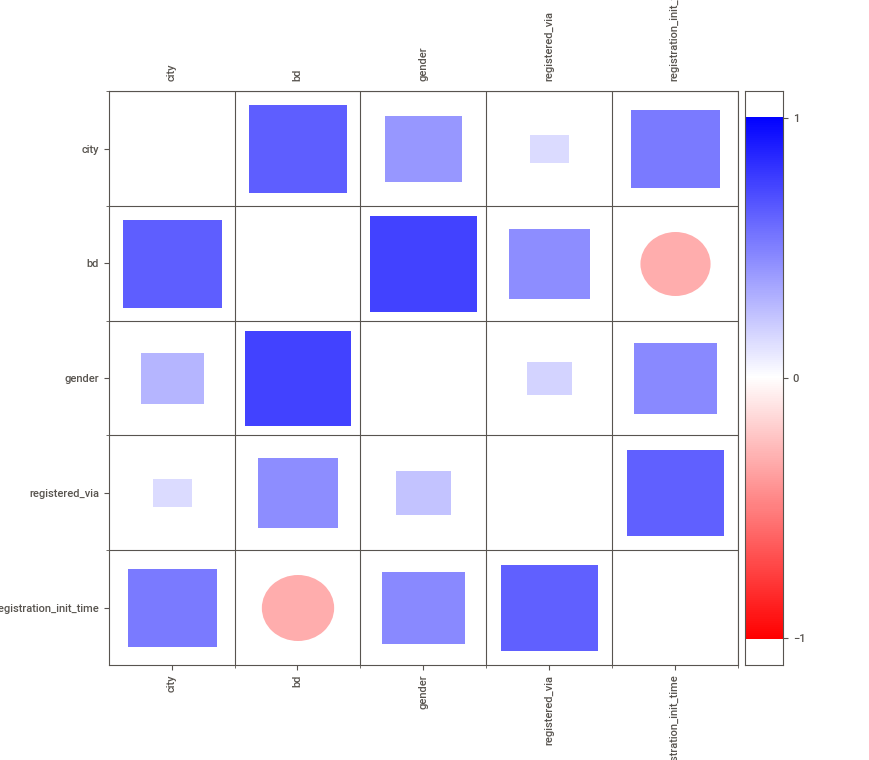
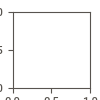

In [ ]:
HTML(filename="SWEETVIZ_REPORT_members.html")



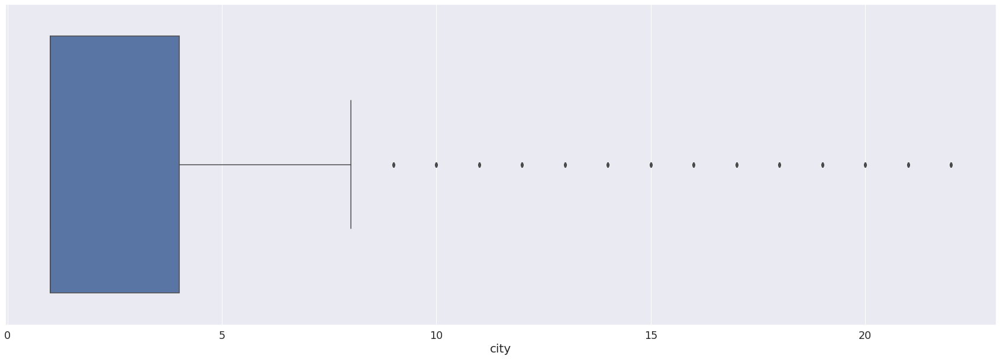

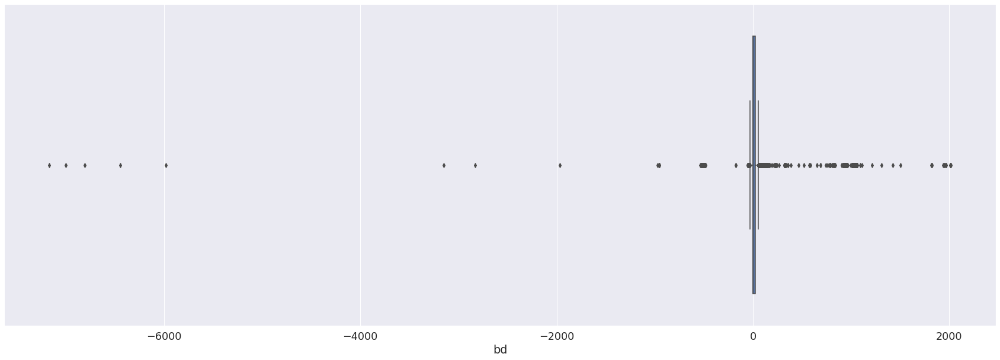

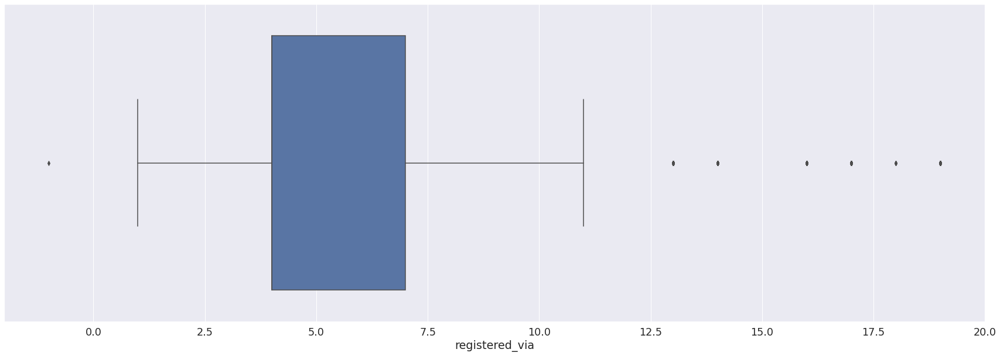

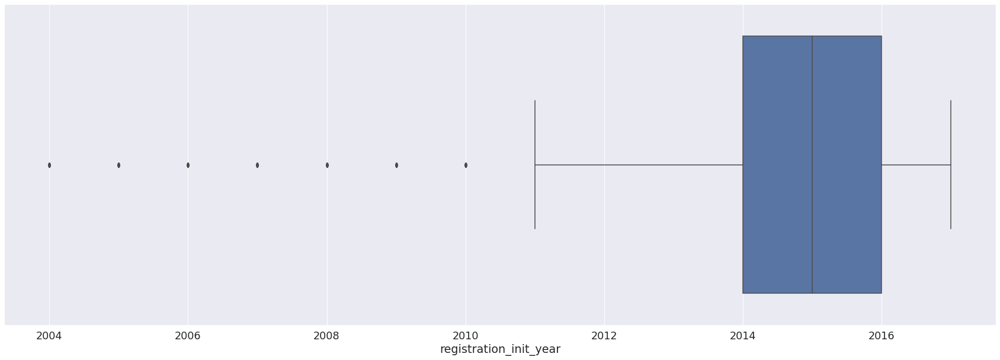

In [ ]:
# Outliers

df = df_members_mod

plt.figure(figsize = (30,10))
sns.boxplot(x="city",  data=df)
plt.xlabel('city', fontsize=20)
plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="bd", data=df)
plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="gender", hue="is_churn", data=df)
#plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="gender_female", data=df)
#plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="gender_male", data=df)
#plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="gender_nan", data=df)
#plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="registered_via", data=df)
plt.show()

#plt.figure(figsize = (30,10))
#sns.boxplot(x="registration_init_time", data=df)
#plt.show()

plt.figure(figsize = (30,10))
sns.boxplot(x="registration_init_year", data=df)
plt.show()

### Resumo Outliers

1.   **city**: Apesar de possuir valores menos frequentes, não são outliers
1.   **bd**: Possui outliers. Há idades negativas, há idades igual a zero e há idades acima de 100 (não impossivel, mas improvavel)
1.   **registered_via**: Apesar de possuir valores menos frequentes, não são outliers
1.   **registration_init_year**: Apesar de parecer haver outliers, a KKBOX foi fundada em 2004 (limite inferior). Logo, não é possivel afirmar que são outliers


### Analise das variaveis de df_members

1.   **msno**: ID dos usuarios
2.   **city**: Apresenta dados muito desbalanceados (a cidade 1 representa 71% dos dados) e "right Skewed"
2.   **bd**: Apresenta dados muito desbalanceados (a idade 0 representa 67% dos dados) e possui valores outliers (Negativos e acima de 100) 
2.   **gender**: Apresenta muitos dados faltantes (65% dos dados) e o restante apresenta uma proporção balanceada
2.   **registered_via**: Apresenta dados muito desbalanceados (o método 4 representa 41%% dos dados) e "right Skewed"
2.   **registration_init_time**: as datas estão bem distribuidas

## Members + Train (Comportamento do Churn)

In [ ]:
df_train_members = pd.merge(df_train, df_members_mod, on='msno', how='left')

In [ ]:
df_train_members.isnull().sum()

msno                           0
is_churn                       0
city                      115770
bd                        115770
registered_via            115770
registration_init_time    115770
registration_init_year    115770
gender_female             115770
gender_male               115770
gender_nan                115770
dtype: int64

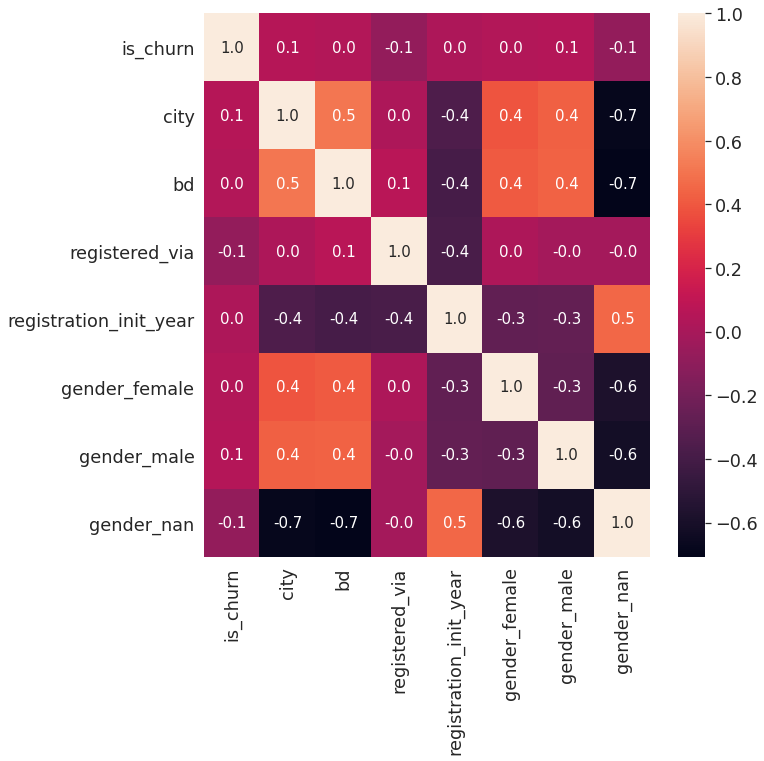

In [ ]:

sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(df_train_members.corr(), annot=True, fmt='.1f', annot_kws={"size": 15})

In [ ]:
splot=sns.countplot(x="is_churn", hue="is_churn", data=df, )
for p in splot.patches:
    splot.annotate(format(p.get_height(), '.1f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 9), 
                   textcoords = 'offset points')

plt.xlabel('is_churn', fontsize=30)
plt.ylabel('count', fontsize=30)


sns.set(font_scale = 2)
ax.yaxis.set_major_formatter(StrMethodFormatter('{x:,}'))

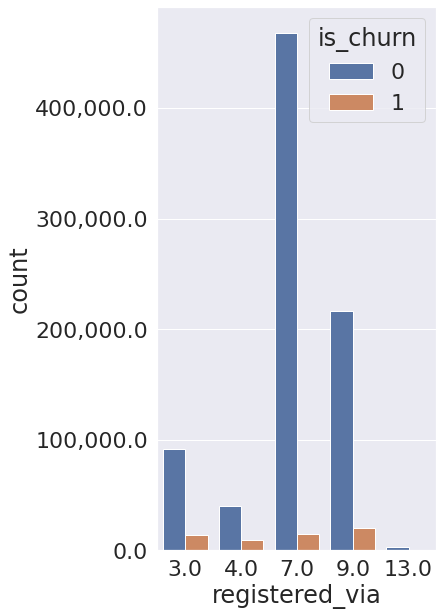

'\nplt.figure(figsize = (30,10))\nsns.countplot(x="registration_init_time", hue="is_churn", data=df)\nplt.show()'

In [ ]:
df = df_train_members
'''
plt.figure(figsize = (30,10))
sns.countplot(x="city", hue="is_churn", data=df)
plt.xlabel('city', fontsize=20)
plt.show()

plt.figure(figsize = (30,10))
sns.countplot(x="bd", hue="is_churn", data=df)
plt.show()

#plt.figure(figsize = (30,10))
#sns.countplot(x="gender", hue="is_churn", data=df)
#plt.show()

plt.figure(figsize = (30,10))
sns.countplot(x="gender_female", hue="is_churn", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.countplot(x="gender_male", hue="is_churn", data=df)
plt.show()

plt.figure(figsize = (30,10))
sns.countplot(x="gender_nan", hue="is_churn", data=df)
plt.show()
'''

fig, ax = plt.subplots(figsize=(5,10)) 
#plt.figure(figsize = (10,10))
ax.yaxis.set_major_formatter(StrMethodFormatter('{x:,}'))
sns.countplot(x="registered_via", hue="is_churn", data=df)


sns.set(font_scale = 2)

plt.show()
'''
plt.figure(figsize = (30,10))
sns.countplot(x="registration_init_time", hue="is_churn", data=df)
plt.show()'''

### Analise das variaveis de df_train_members (comportamento do churn)

**is_churn**: não apresenta forte correlação com as variaveis de df_members. Um ponto de atenção é que há muitos valores faltantes (115.770)ao fazer o "merge" (train + members) logo a base df_members pode estar incompleta/incorreta

Há um forte desbalanceamento entre positivo/negativo churn (1 e 0 respectivamente).

A analise do comportamento de churn em relação as diferentes variaveis de df_members não demonstra uma tendencia "obvia" para algum tipo de padrão de comportamento

## Conclusão sobre df_transaction

1.   Apesar da variavel **gender** apresentar muitos valores faltantes, trabalharemos com a variavel dummy_nan. Dessa forma, não eliminaremos os dados e o modelo pode avaliar o comportamento de churn para 3 variações de "gender" (masculino, feminino e nan).

1.   A variavel **bd** necessita de preprocessing para outliers


## train.csv

In [ ]:
df_train.columns

Index(['msno', 'is_churn'], dtype='object')

In [ ]:
df_train.shape

(992931, 2)

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 992931 entries, 0 to 992930
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   msno      992931 non-null  object
 1   is_churn  992931 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 15.2+ MB


In [ ]:
df_train.head()

,msno,is_churn
0,waLDQMmcOu2jLDaV1ddDkgCrB/jl6sD66Xzs0Vqax1Y=,1
1,QA7uiXy8vIbUSPOkCf9RwQ3FsT8jVq2OxDr8zqa7bRQ=,1
2,fGwBva6hikQmTJzrbz/2Ezjm5Cth5jZUNvXigKK2AFA=,1
3,mT5V8rEpa+8wuqi6x0DoVd3H5icMKkE9Prt49UlmK+4=,1
4,XaPhtGLk/5UvvOYHcONTwsnH97P4eGECeq+BARGItRw=,1


In [ ]:
df_train.tail()

,msno,is_churn
992926,tUM0yxAj50Vc35vQZ++xMlomdyeLJUW9lEcoPnt3H+g=,0
992927,KQS8etmfGgvE/7Y9gK+E9wdLnRTI0lyyPXaXL3I8E4c=,0
992928,8/jDLgNREuWI9hcKVYp8723nmavn01T+AuMWkK3uM7g=,0
992929,iNV99F1Rml7EMndOeLI0Y/iek6aCj/Qp1Z4dZvR+sak=,0
992930,ZoVEIVMCpKT9/MJgqO+fh9xYrNM2vNisLhJ4xY/CVyk=,0


In [ ]:
df_train.describe()

,is_churn
count,992931.000000
mean,0.063923
std,0.244616
min,0.000000
25%,0.000000
50%,0.000000
75%,0.000000
max,1.000000


In [ ]:
df_train.isnull().sum()

msno        0
is_churn    0
dtype: int64

In [ ]:
#my_report = sv.analyze(df_train)
#my_report.show_html()


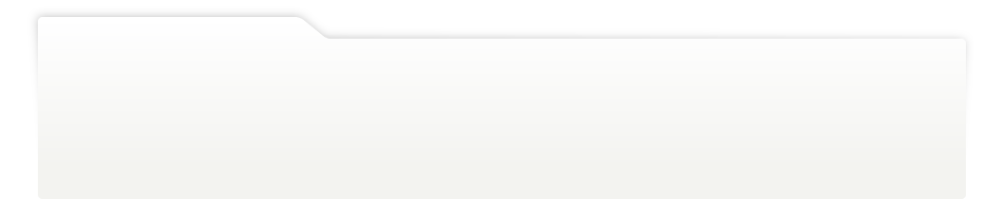
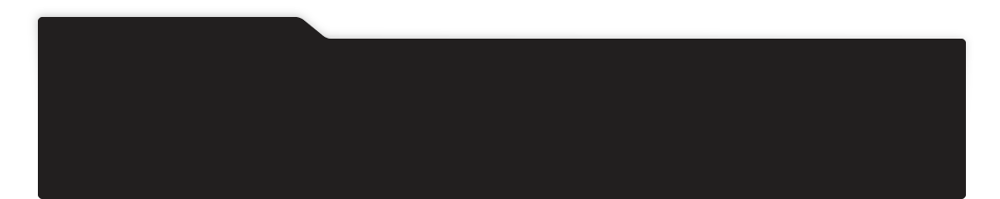
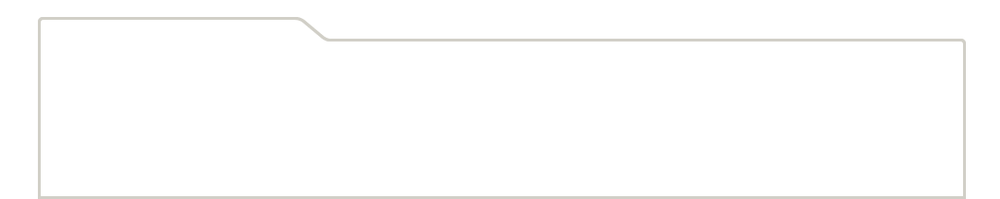
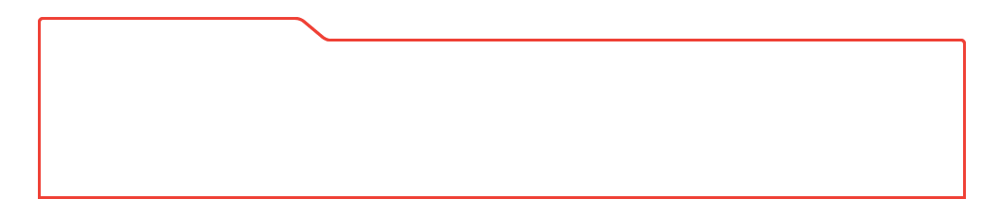
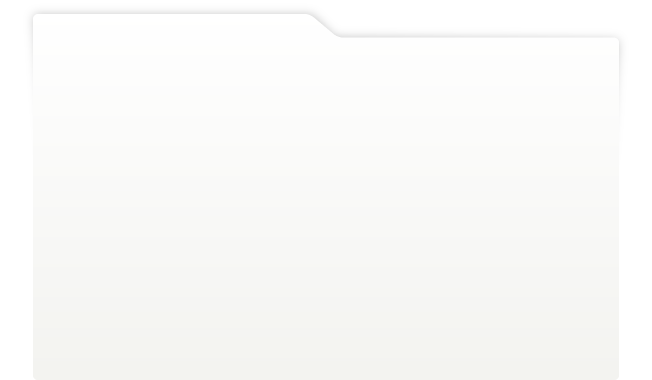
...
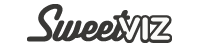
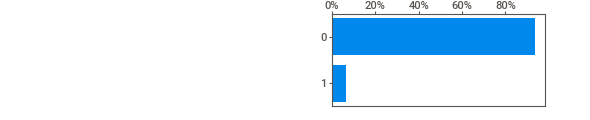
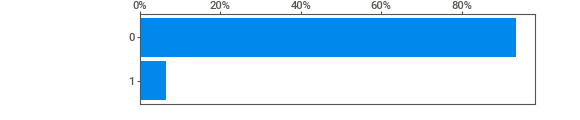
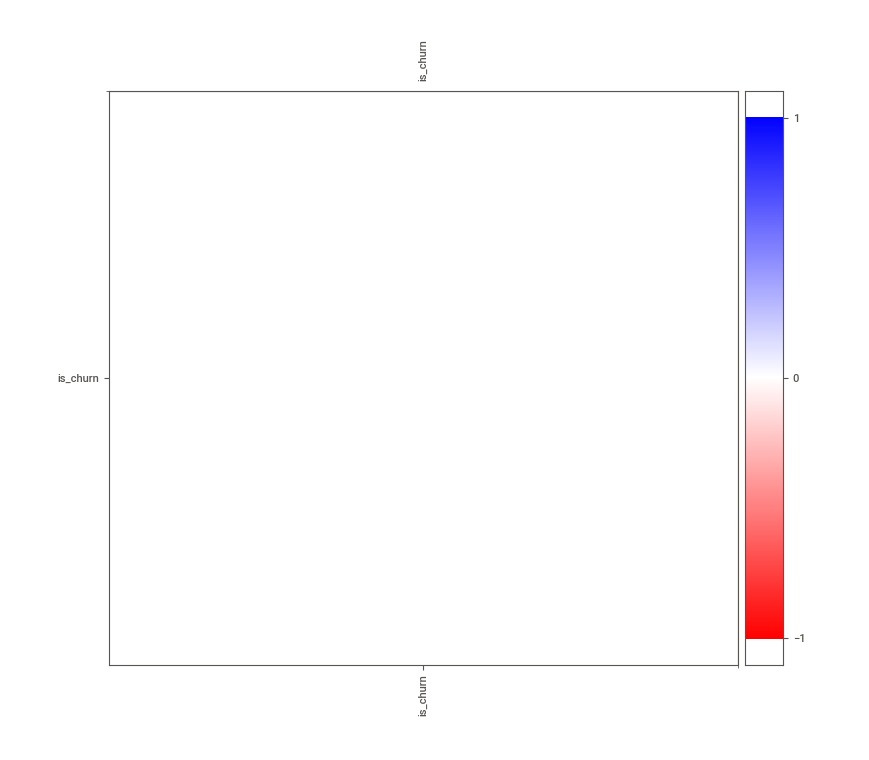
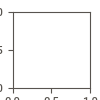

In [ ]:
HTML(filename="SWEETVIZ_REPORT_train.html")



1.   **msno**: ID dos usuarios
1.   **is_churn**: Apresenta dados muito desbalanceados (o "não churn" representa 94% dos dados)

In [ ]:
from matplotlib.ticker import FormatStrFormatter, StrMethodFormatter

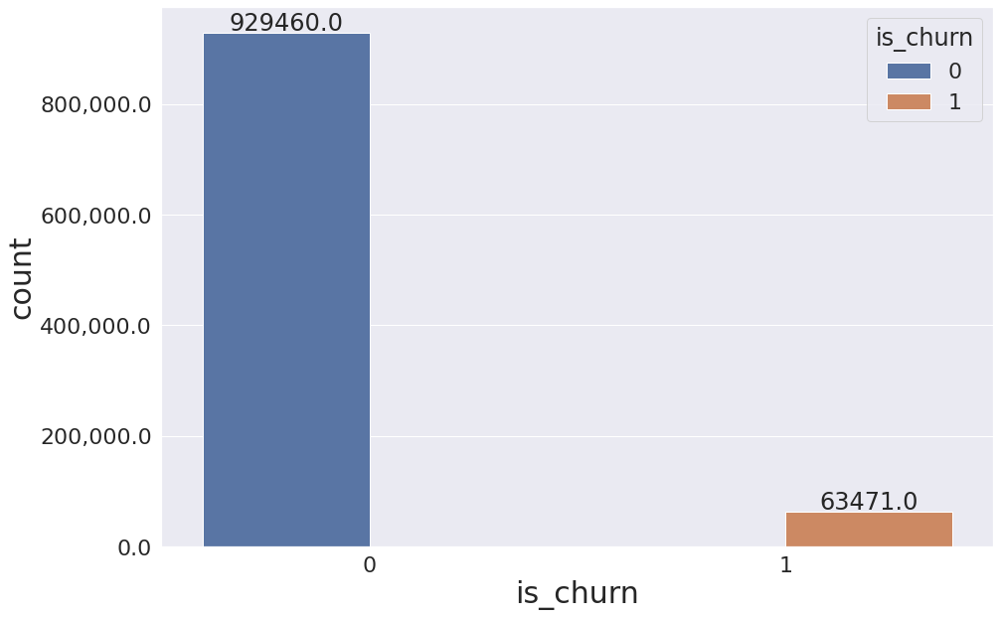

In [ ]:
df = df_train

fig, ax = plt.subplots(figsize=(15,10)) 
#plt.figure(figsize = (15,10))
splot=sns.countplot(x="is_churn", hue="is_churn", data=df, )
for p in splot.patches:
    splot.annotate(format(p.get_height(), '.1f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 9), 
                   textcoords = 'offset points')

plt.xlabel('is_churn', fontsize=30)
plt.ylabel('count', fontsize=30)


sns.set(font_scale = 2)
ax.yaxis.set_major_formatter(StrMethodFormatter('{x:,}'))

plt.show()

# Data Wrangling

## Carregamento dos dados

### Via Colab

In [ ]:
from google.colab import drive 
drive.mount('/content/gdrive')

In [ ]:
df_members = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/members_v3.csv')

In [ ]:
df_transactions = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/transactions.csv')

In [ ]:
df_train = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/train.csv')

In [ ]:
df_user_logs_group_all_final = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/user_logs_group_all_final.csv')

### Via Jupyter

In [ ]:
df_members = pd.read_csv('members_v3.csv')

In [ ]:
df_transactions = pd.read_csv('transactions.csv')

In [ ]:
df_train = pd.read_csv('train.csv')

In [ ]:
df_user_logs = pd.read_csv('user_logs_sample3 (0,1%).csv')

## Preprocessing

## Preprocessing Transactions.csv

In [ ]:
df_transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21547746 entries, 0 to 21547745
Data columns (total 9 columns):
 #   Column                  Dtype 
---  ------                  ----- 
 0   msno                    object
 1   payment_method_id       int64 
 2   payment_plan_days       int64 
 3   plan_list_price         int64 
 4   actual_amount_paid      int64 
 5   is_auto_renew           int64 
 6   transaction_date        int64 
 7   membership_expire_date  int64 
 8   is_cancel               int64 
dtypes: int64(8), object(1)
memory usage: 1.4+ GB


In [ ]:
df_transactions.head()

,msno,payment_method_id,payment_plan_days,plan_list_price,actual_amount_paid,is_auto_renew,transaction_date,membership_expire_date,is_cancel
0,YyO+tlZtAXYXoZhNr3Vg3+dfVQvrBVGO8j1mfqe4ZHc=,41,30,129,129,1,20150930,20151101,0
1,AZtu6Wl0gPojrEQYB8Q3vBSmE2wnZ3hi1FbK1rQQ0A4=,41,30,149,149,1,20150930,20151031,0
2,UkDFI97Qb6+s2LWcijVVv4rMAsORbVDT2wNXF0aVbns=,41,30,129,129,1,20150930,20160427,0
3,M1C56ijxozNaGD0t2h68PnH2xtx5iO5iR2MVYQB6nBI=,39,30,149,149,1,20150930,20151128,0
4,yvj6zyBUaqdbUQSrKsrZ+xNDVM62knauSZJzakS9OW4=,39,30,149,149,1,20150930,20151121,0


In [ ]:
df_transactions_mod = df_transactions.groupby('msno', as_index=False).agg(
                                    transactions_count=('payment_method_id', 'count'), 
                                    first_transactions=('transaction_date', 'min'),                                        
                                    last_transactions=('transaction_date', 'max'),  
                                    payment_method_changes=('payment_method_id', 'nunique'),
                                    payment_plan_days_mean=('payment_plan_days', 'mean'),                                    
                                    payment_plan_days_total=('payment_plan_days', 'sum'),         
                                    payment_plan_days_min=('payment_plan_days', 'min'),       
                                    payment_plan_changes=('payment_plan_days', 'nunique'),                                  
                                    plan_list_price_mean=('plan_list_price', 'mean'),                                    
                                    actual_amount_paid_mean=('actual_amount_paid', 'mean'),                                    
                                    plan_list_price_total=('plan_list_price', 'sum'),                                    
                                    actual_amount_paid_total=('actual_amount_paid', 'sum'),
                                    plan_list_price_changes=('plan_list_price', 'nunique'),                                    
                                    actual_amount_paid_changes=('actual_amount_paid', 'nunique'),

                                    is_auto_renew_max=('is_auto_renew', 'max'),                                    
                                    is_auto_renew_min=('is_auto_renew', 'min'),  
                                    is_cancel_max=('is_cancel', 'max'),  
                                    is_cancel_min=('is_cancel', 'min')
                                    )

In [ ]:
df_transactions_mod.head(20)

,msno,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,is_auto_renew_max,is_auto_renew_min,is_cancel_max,is_cancel_min
0,+++FOrTS7ab3tIgIh8eWwX4FqRv8w/FoiOuyXsFvphY=,1,20160909,20160909,1,7.000000,7,7,1,0.000000,0.000000,0,0,1,1,0,0,0,0
1,+++IZseRRiQS9aaSkH6cMYU6bGDcxUieAi/tH67sC5s=,1,20151121,20151121,1,410.000000,410,410,1,1788.000000,1788.000000,1788,1788,1,1,0,0,0,0
2,+++hVY1rZox/33YtvDgmKA2Frg/2qhkz12B9ylCvh8o=,4,20161116,20170215,1,30.000000,120,30,1,99.000000,99.000000,396,396,1,1,1,1,0,0
3,+++l/EXNMLTijfLBa8p2TUVVVp2aFGSuUI/h7mLmthw=,19,20150131,20170131,1,28.578947,543,0,3,141.157895,149.000000,2682,2831,2,1,1,1,0,0
4,+++snpr7pmobhLKUgSHTv/mpkqgBT0tQJ0zQj6qKrqc=,26,20150126,20170226,1,28.846154,750,0,2,143.269231,149.000000,3725,3874,2,1,1,1,0,0
5,++/9R3sX37CjxbY/AaGvbwr3QkwElKBCtSvVzhCBDOk=,12,20160315,20170215,1,30.000000,360,30,1,149.000000,149.000000,1788,1788,1,1,1,1,0,0
6,++/Gw1B9K+XOlB3hLTloeUK2QlCa2m+BJ8TrzGf7djI=,9,20150113,20150819,2,45.444444,409,0,4,215.222222,231.777778,1937,2086,3,2,1,0,1,0
7,++/TR7WI15q2ZCtOXmoap7jR+kEhbMVE5swOqsfqpqI=,9,20150124,20150826,1,27.000000,243,0,3,132.444444,149.000000,1192,1341,2,1,1,1,1,0
8,++/UDNo9DLrxT8QVGiDi1OnWfczAdEwThaVyD0fXO50=,19,20150131,20170131,1,28.578947,543,0,3,141.157895,149.000000,2682,2831,2,1,1,1,0,0
9,++/ZHqwUNa7U21Qz+zqteiXlZapxey86l6eEorrak/g=,21,20150331,20170131,1,21.428571,450,0,2,106.428571,149.000000,2235,3129,2,1,1,1,0,0


In [ ]:
# Criação da variavel duração = tempo entre a primeira e ultima assinatura

df_transactions_mod['last_transactions_datetime'] =  pd.to_datetime(df_transactions_mod['last_transactions'], format='%Y%m%d')
df_transactions_mod['first_transactions_datetime' ] =  pd.to_datetime(df_transactions_mod['first_transactions'], format='%Y%m%d')

df_transactions_mod["duration"]=df_transactions_mod["last_transactions_datetime"]-df_transactions_mod["first_transactions_datetime"]
df_transactions_mod["duration"] = pd.to_numeric(df_transactions_mod['duration'].dt.days, downcast='integer')

# variação entre pagamento medio

df_transactions_mod["payment_mean_diff"]=df_transactions_mod["plan_list_price_mean"]-df_transactions_mod["actual_amount_paid_mean"]
df_transactions_mod["payment_mean_diff"] = df_transactions_mod["payment_mean_diff"].abs()

# variação entre pagamento total


df_transactions_mod["payment_total_diff"]=df_transactions_mod["plan_list_price_total"]-df_transactions_mod["actual_amount_paid_total"]
df_transactions_mod["payment_total_diff"] = df_transactions_mod["payment_total_diff"].abs()

In [ ]:
''' 
Formula para avaliar o comportamento da variavel is_renew:
  Se o valor máximo e min for igual a 0 = o usuario sempre manteve o is_renew "desligado"
  Se o valor máximo e min for igual a 1 = o usuario sempre manteve o is_renew "ligado"
  Se o valor máximo for diferente do valor min (1 e 0 ou 0 e 1) = o usuario sempre alterou is_renew (porém não definir qual foi a mudança)  
'''
def renew_off (row):
   if row['is_auto_renew_max'] == 0 :
      if row['is_auto_renew_min'] == 0:
        return 1  
   return 0

def renew_on (row):
   if row['is_auto_renew_max'] == 1 :
      if row['is_auto_renew_min'] == 1:
        return 1  
   return 0

def renew_change (row):
   if row['is_auto_renew_max'] != row['is_auto_renew_min'] :
      return 1  
   return 0

df_transactions_mod['auto_renew_off'] = df_transactions_mod.apply(lambda row: renew_off(row), axis=1)
df_transactions_mod['auto_renew_on'] = df_transactions_mod.apply(lambda row: renew_on(row), axis=1)
df_transactions_mod['auto_renew_changed'] = df_transactions_mod.apply(lambda row: renew_change(row), axis=1)


In [ ]:
''' 
Formula para avaliar o comportamento da variavel is_cancel:
  Se o valor máximo e min for igual a 0 = o usuario sempre manteve o is_cancel "desligado"
  Se o valor máximo e min for igual a 1 = o usuario sempre manteve o is_cancel "ligado"
  Se o valor máximo for diferente do valor min (1 e 0 ou 0 e 1) = o usuario sempre alterou is_cancel (porém não definir qual foi a mudança)  
'''


def cancel_off (row):
   if row['is_cancel_max'] == 0 :
      if row['is_cancel_min'] == 0:
        return 1  
   return 0

def cancel_on (row):
   if row['is_cancel_max'] == 1 :
      if row['is_cancel_min'] == 1:
        return 1  
   return 0

def cancel_change (row):
   if row['is_cancel_max'] != row['is_cancel_min'] :
      return 1  
   return 0

df_transactions_mod['cancel_off'] = df_transactions_mod.apply(lambda row: cancel_off(row), axis=1)
df_transactions_mod['cancel_on'] = df_transactions_mod.apply(lambda row: cancel_on(row), axis=1)
df_transactions_mod['cancel_changed'] = df_transactions_mod.apply(lambda row: cancel_change(row), axis=1)

In [ ]:
df_transactions_mod.drop(labels=['is_auto_renew_max', 'is_auto_renew_min', 'is_cancel_max', 'is_cancel_min', 'last_transactions_datetime', 'first_transactions_datetime'],inplace=True,axis=1)

In [ ]:
df_transactions_mod.head(20)

,msno,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed
0,+++FOrTS7ab3tIgIh8eWwX4FqRv8w/FoiOuyXsFvphY=,1,20160909,20160909,1,7.000000,7,7,1,0.000000,0.000000,0,0,1,1,0,0.000000,0,1,0,0,1,0,0
1,+++IZseRRiQS9aaSkH6cMYU6bGDcxUieAi/tH67sC5s=,1,20151121,20151121,1,410.000000,410,410,1,1788.000000,1788.000000,1788,1788,1,1,0,0.000000,0,1,0,0,1,0,0
2,+++hVY1rZox/33YtvDgmKA2Frg/2qhkz12B9ylCvh8o=,4,20161116,20170215,1,30.000000,120,30,1,99.000000,99.000000,396,396,1,1,91,0.000000,0,0,1,0,1,0,0
3,+++l/EXNMLTijfLBa8p2TUVVVp2aFGSuUI/h7mLmthw=,19,20150131,20170131,1,28.578947,543,0,3,141.157895,149.000000,2682,2831,2,1,731,7.842105,149,0,1,0,1,0,0
4,+++snpr7pmobhLKUgSHTv/mpkqgBT0tQJ0zQj6qKrqc=,26,20150126,20170226,1,28.846154,750,0,2,143.269231,149.000000,3725,3874,2,1,762,5.730769,149,0,1,0,1,0,0
5,++/9R3sX37CjxbY/AaGvbwr3QkwElKBCtSvVzhCBDOk=,12,20160315,20170215,1,30.000000,360,30,1,149.000000,149.000000,1788,1788,1,1,337,0.000000,0,0,1,0,1,0,0
6,++/Gw1B9K+XOlB3hLTloeUK2QlCa2m+BJ8TrzGf7djI=,9,20150113,20150819,2,45.444444,409,0,4,215.222222,231.777778,1937,2086,3,2,218,16.555556,149,0,0,1,0,0,1
7,++/TR7WI15q2ZCtOXmoap7jR+kEhbMVE5swOqsfqpqI=,9,20150124,20150826,1,27.000000,243,0,3,132.444444,149.000000,1192,1341,2,1,214,16.555556,149,0,1,0,0,0,1
8,++/UDNo9DLrxT8QVGiDi1OnWfczAdEwThaVyD0fXO50=,19,20150131,20170131,1,28.578947,543,0,3,141.157895,149.000000,2682,2831,2,1,731,7.842105,149,0,1,0,1,0,0
9,++/ZHqwUNa7U21Qz+zqteiXlZapxey86l6eEorrak/g=,21,20150331,20170131,1,21.428571,450,0,2,106.428571,149.000000,2235,3129,2,1,672,42.571429,894,0,1,0,1,0,0


In [ ]:
# Gerar o relatorio HTML abaixo
#my_report = sv.analyze(df_transactions_mod)
#my_report.show_html()

                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



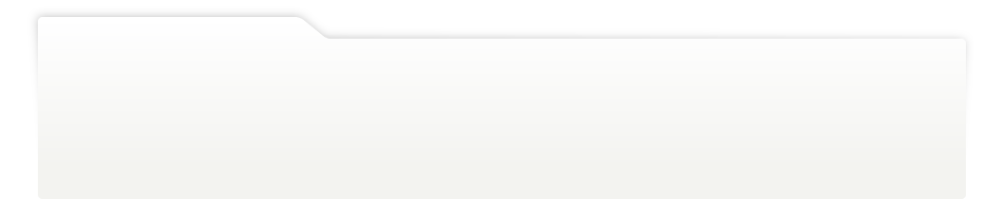
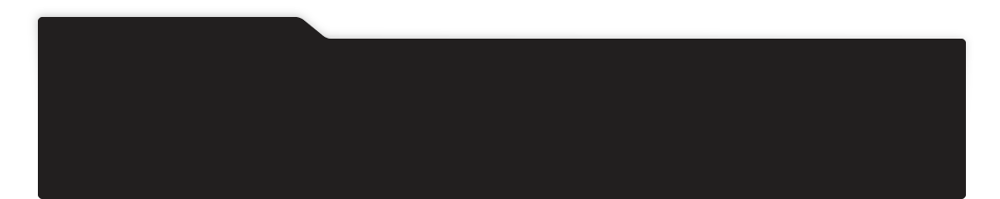
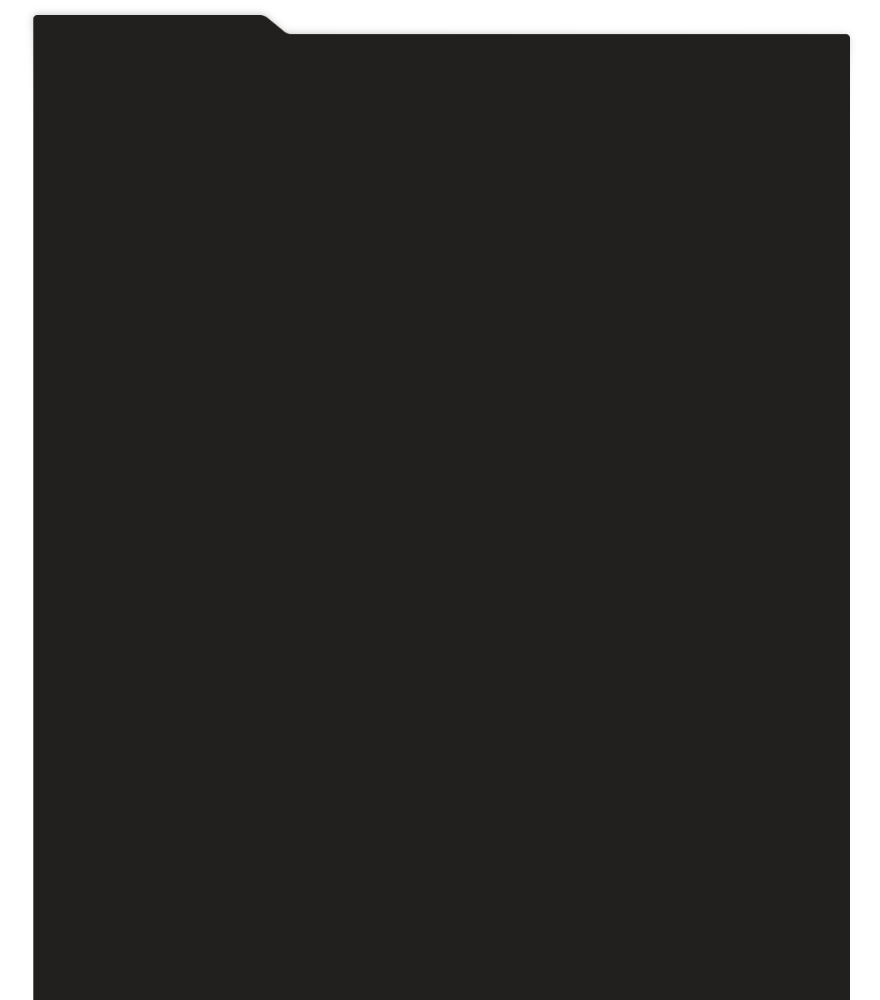
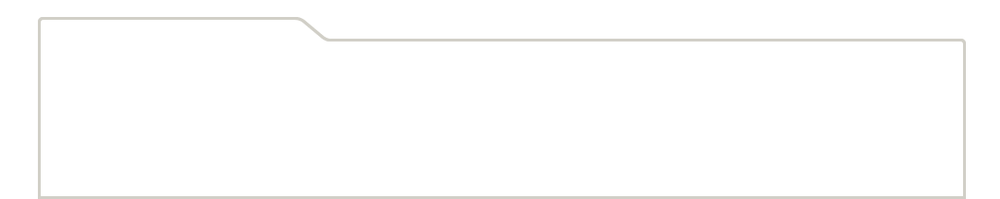
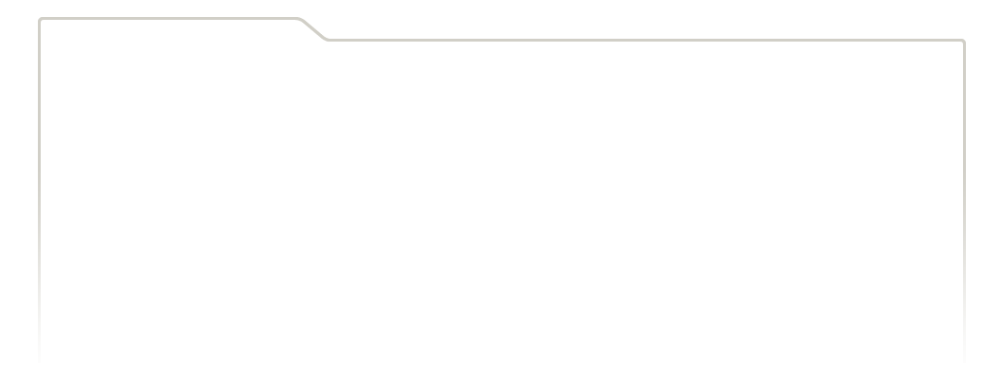
...
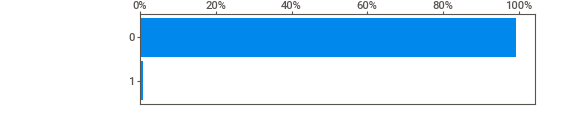
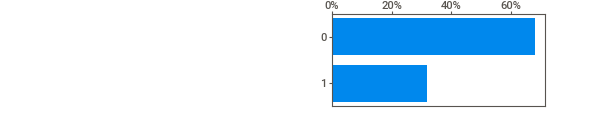
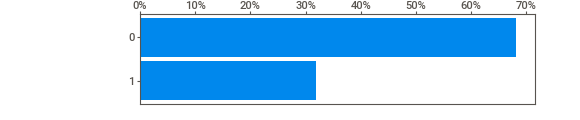
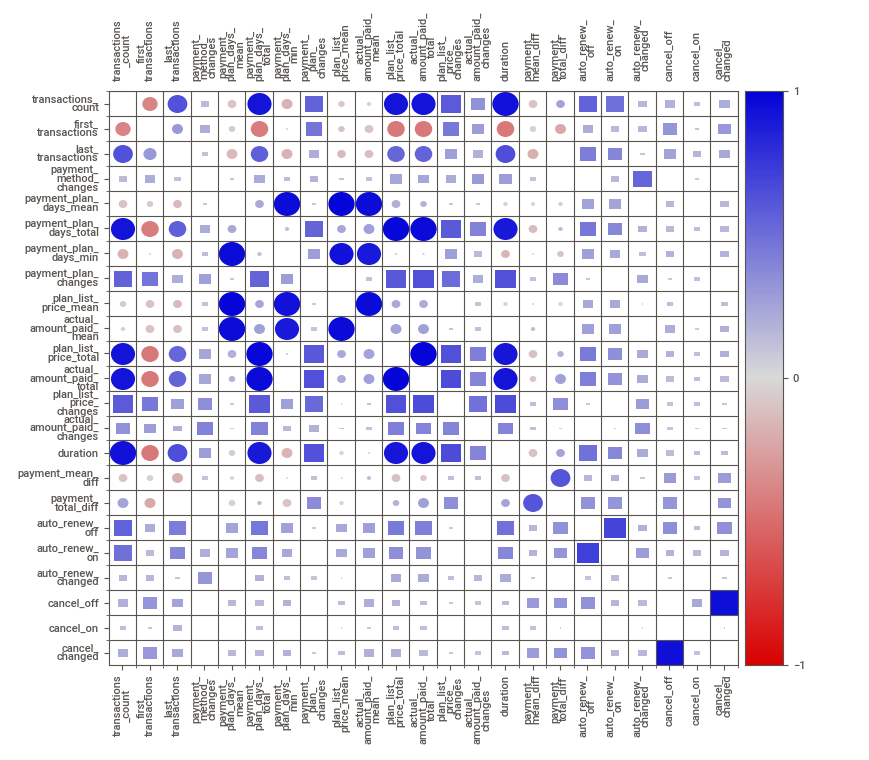
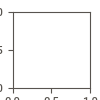

In [ ]:
HTML(filename="SWEETVIZ_REPORT_df_transactions_mod.html")

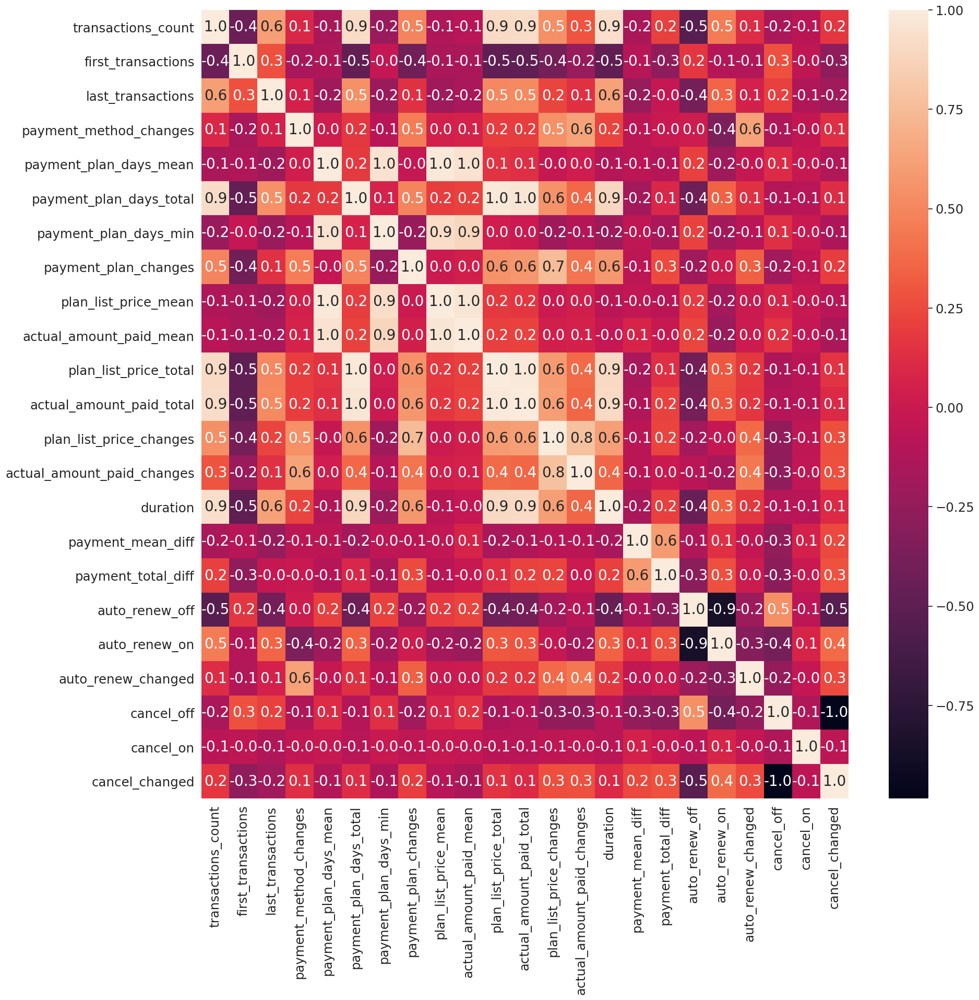

In [ ]:
sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(20,20)) 
sns.heatmap(df_transactions_mod.corr(), annot=True, fmt='.1f', annot_kws={"size": 20})

In [ ]:
#df_transactions_mod.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/transactions_mod.csv', index = False)

## Preprocessing Members.csv

### Variavel **bd** de df_members: utilizaremos a mediana

        Há idades negativas, há idades igual a zero e há idades acima de 100 (não impossivel, mas improvavel)

In [ ]:
# Utilizarei a idade 80 anos como limite máximo e idade minima 10 anos

df_members_out = df_members
df_members_out['bd'] = df_members_out['bd'].apply(lambda x: x if (x < 80.0) and (x > 10.0) else np.nan)


In [ ]:
# Retirar os outliers para verificar a Mediana dos demais valores

df_members_out_drop = df_members_out

df_members_out_drop.dropna(axis = 0, how ='any', inplace = True)

In [ ]:
df_members_out_drop.reset_index(drop=True)

,msno,city,bd,gender,registered_via,registration_init_time
0,WFLY3s7z4EZsieHCt63XrsdtfTEmJ+2PnnKLH5GY4Tk=,6,32.0,female,9,20110915
1,yLkV2gbZ4GLFwqTOXLVHz0VGrMYcgBGgKZ3kj9RiYu8=,4,30.0,male,9,20110916
2,WH5Jq4mgtfUFXh2yz+HrcTXKS4Oess4k4W3qKolAeb0=,5,34.0,male,9,20110916
3,tKmbR4X5VXjHmxERrckawEMZ4znVy1lAQIR1vV5rdNk=,5,19.0,male,9,20110917
4,I0yFvqMoNkM8ZNHb617e1RBzIS/YRKemHO7Wj13EtA0=,13,63.0,male,9,20110918
...,...,...,...,...,...,...
2178141,IwDZCuhB0UP7wrBwuqE1r1jQIA0yFSTqUGlGJnM+hMI=,1,52.0,male,4,20151020
2178142,y0rwiAeU5goDatsiUDulPdiJpohZ15hxUAkSJHccnvY=,8,32.0,female,9,20151020
2178143,2U0grRyv2DB3Pw3crMBhBfsWWq6VkGcK1IGVqmDmK0w=,5,23.0,female,4,20151020
2178144,tyoRqQ72Y2oCcqvdaIxG8T0Hs9DZvuuM8IeTwhxtdBQ=,6,26.0,female,7,20151020


In [ ]:
df_members_out_drop.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2178146 entries, 4 to 6769470
Data columns (total 6 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   msno                    object 
 1   city                    int64  
 2   bd                      float64
 3   gender                  object 
 4   registered_via          int64  
 5   registration_init_time  int64  
dtypes: float64(1), int64(3), object(2)
memory usage: 116.3+ MB


In [ ]:
# Gerar o relatorio HTML abaixo
#my_report = sv.analyze(df_members_out_drop)
#my_report.show_html()

                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



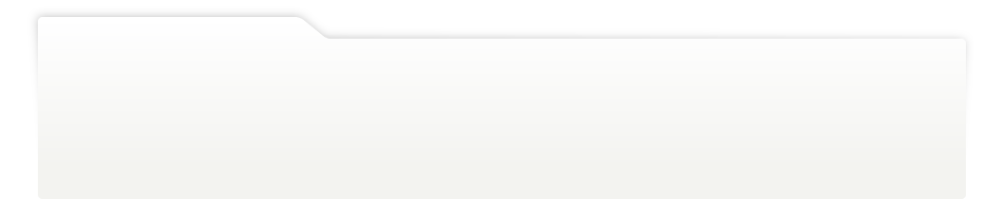
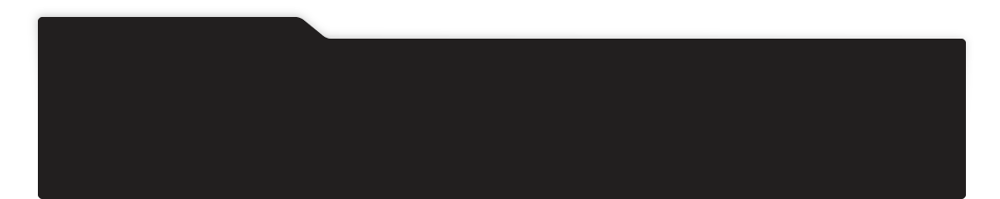
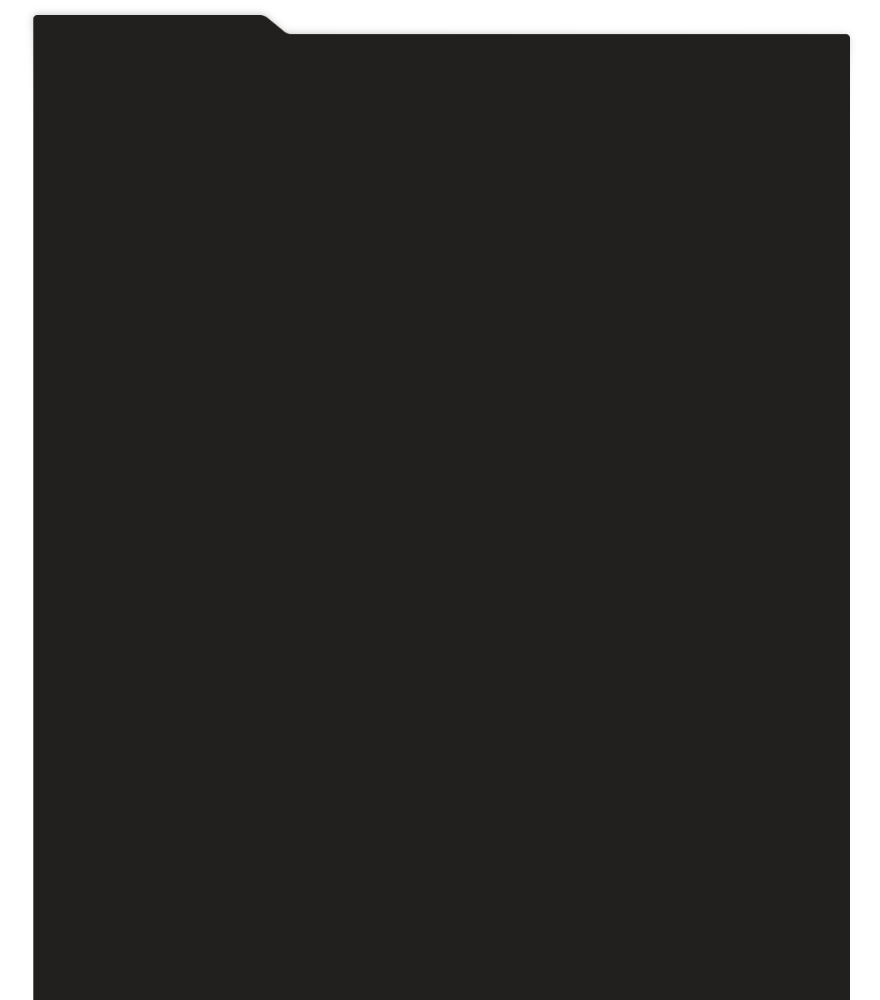
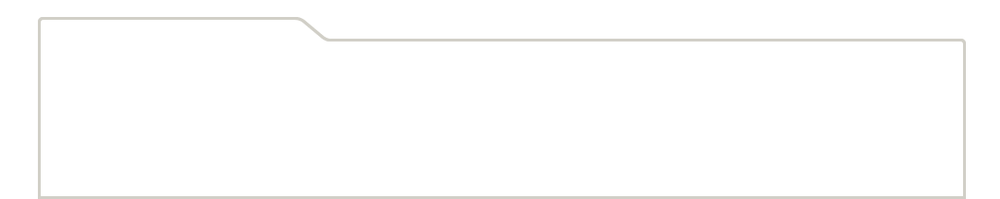
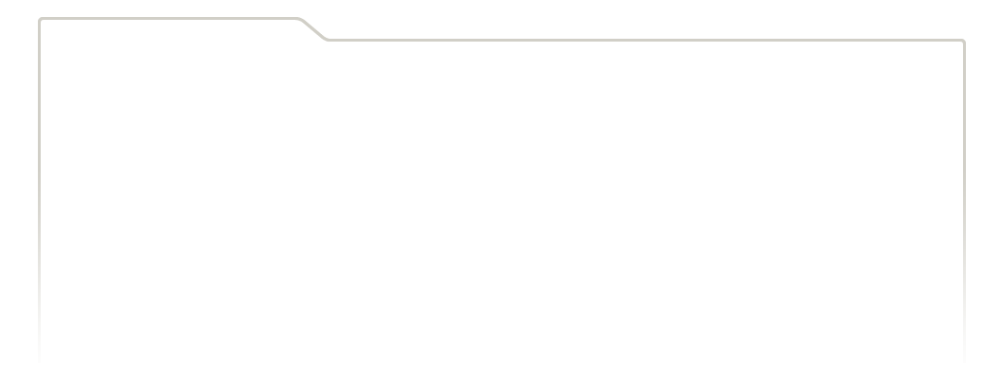
...
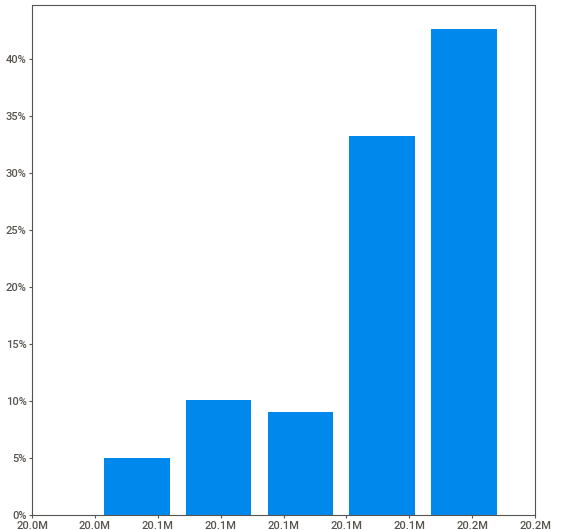
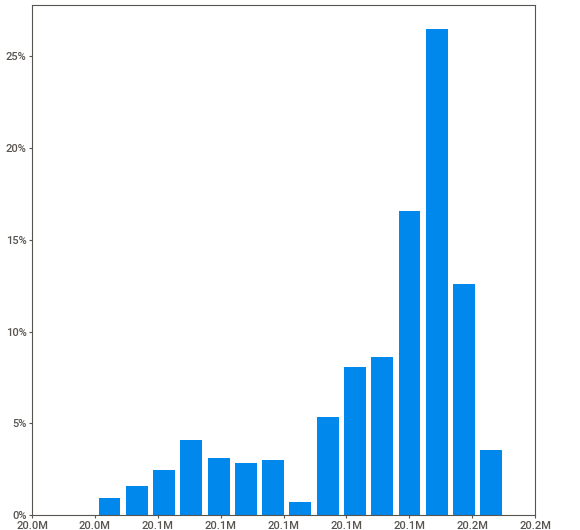
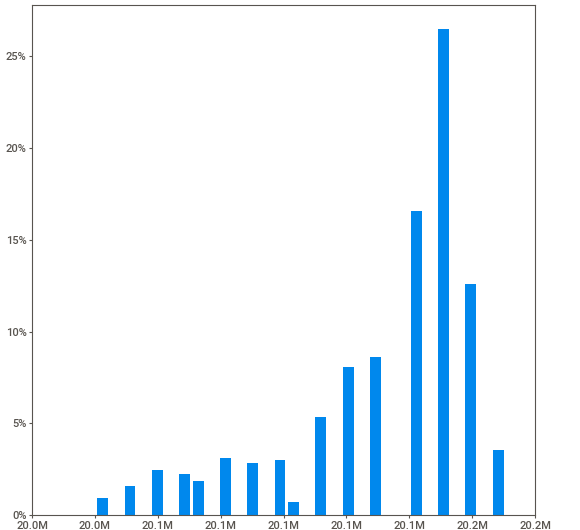
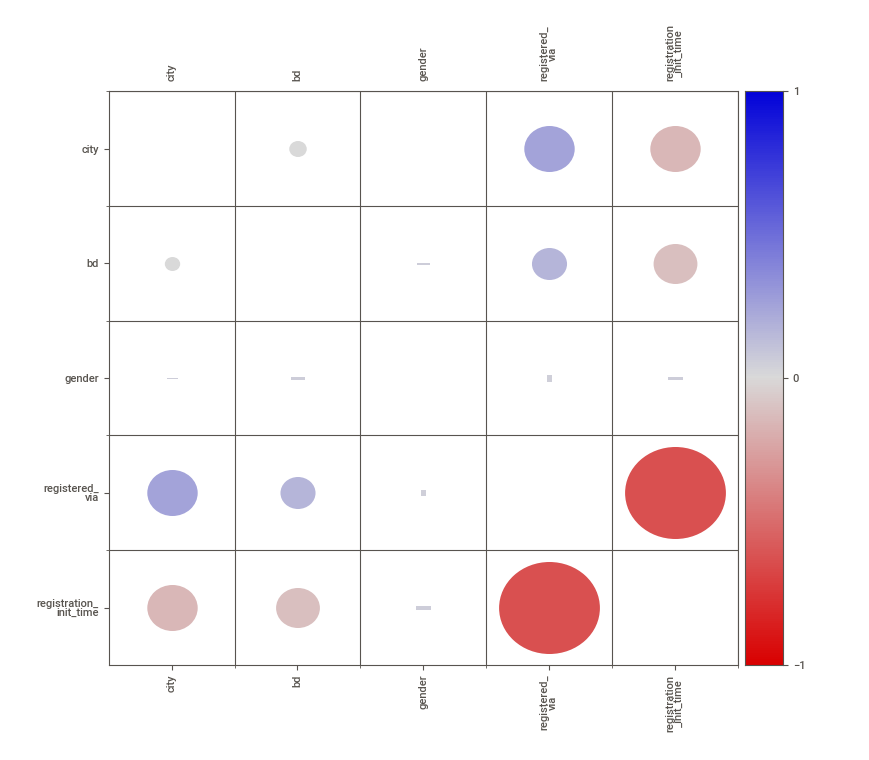
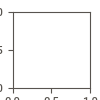

In [ ]:
HTML(filename="SWEETVIZ_REPORT_df_members_out_drop.html")


### Variavel **bd** de df_members: **Mediana = 27**

In [ ]:
# Criar um novo dataset antes da exclusão dos outliers e preencher com a Mediana:

df_members = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/members_v3.csv') #colab
#df_members = pd.read_csv('members_v3.csv') #jupyter
df_members_med = df_members
df_members_med['bd'] = df_members_med['bd'].apply(lambda x: x if (x < 80.0) and (x > 10.0) else np.nan)

df_members_med.isnull().sum()



msno                            0
city                            0
bd                        4550801
gender                    4429505
registered_via                  0
registration_init_time          0
dtype: int64

In [ ]:
# preencher com a Mediana:
df_members_med['bd'] = df_members_med['bd'].fillna(27.0)
df_members_med.isnull().sum()

msno                            0
city                            0
bd                              0
gender                    4429505
registered_via                  0
registration_init_time          0
dtype: int64

In [ ]:
# corrigir a variavel tempo

df_members_med_mod = df_members_med
df_members_med_mod['registration_init_time_format'] =  pd.to_datetime(df_members_med_mod['registration_init_time'], format='%Y%m%d')
df_members_med_mod['registration_init_year'] = pd.DatetimeIndex(df_members_med_mod['registration_init_time_format']).year
df_members_med_mod['registration_init_month'] = pd.DatetimeIndex(df_members_med_mod['registration_init_time_format']).month

df_members_med_mod.drop(labels=['registration_init_time_format'],inplace=True,axis=1)

# criar dummy de genero

df_members_med_mod = pd.get_dummies(data = df_members, columns = ["gender"], dummy_na = True, drop_first = True) 

In [ ]:
df_members_med_mod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6769473 entries, 0 to 6769472
Data columns (total 9 columns):
 #   Column                   Dtype  
---  ------                   -----  
 0   msno                     object 
 1   city                     int64  
 2   bd                       float64
 3   registered_via           int64  
 4   registration_init_time   int64  
 5   registration_init_year   int64  
 6   registration_init_month  int64  
 7   gender_male              uint8  
 8   gender_nan               uint8  
dtypes: float64(1), int64(5), object(1), uint8(2)
memory usage: 374.4+ MB


In [ ]:
df_members_med_mod.head()

,msno,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan
0,Rb9UwLQTrxzBVwCB6+bCcSQWZ9JiNLC9dXtM1oEsZA8=,1,27.0,11,20110911,2011,9,0,1
1,+tJonkh+O1CA796Fm5X60UMOtB6POHAwPjbTRVl/EuU=,1,27.0,7,20110914,2011,9,0,1
2,cV358ssn7a0f7jZOwGNWS07wCKVqxyiImJUX6xcIwKw=,1,27.0,11,20110915,2011,9,0,1
3,9bzDeJP6sQodK73K5CBlJ6fgIQzPeLnRl0p5B77XP+g=,1,27.0,11,20110915,2011,9,0,1
4,WFLY3s7z4EZsieHCt63XrsdtfTEmJ+2PnnKLH5GY4Tk=,6,32.0,9,20110915,2011,9,0,0


In [ ]:
#my_report = sv.analyze(df_members_med_mod)
#my_report.show_html()


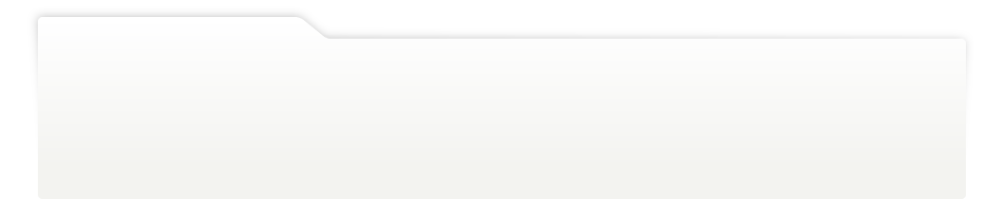
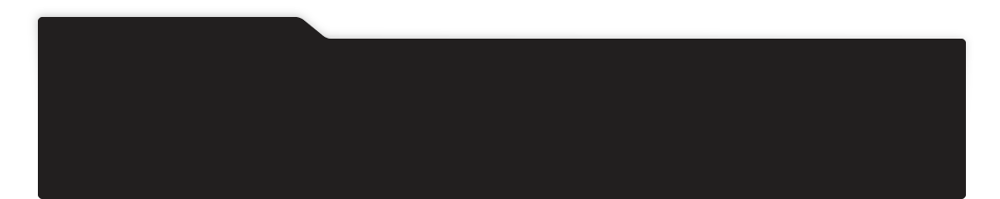
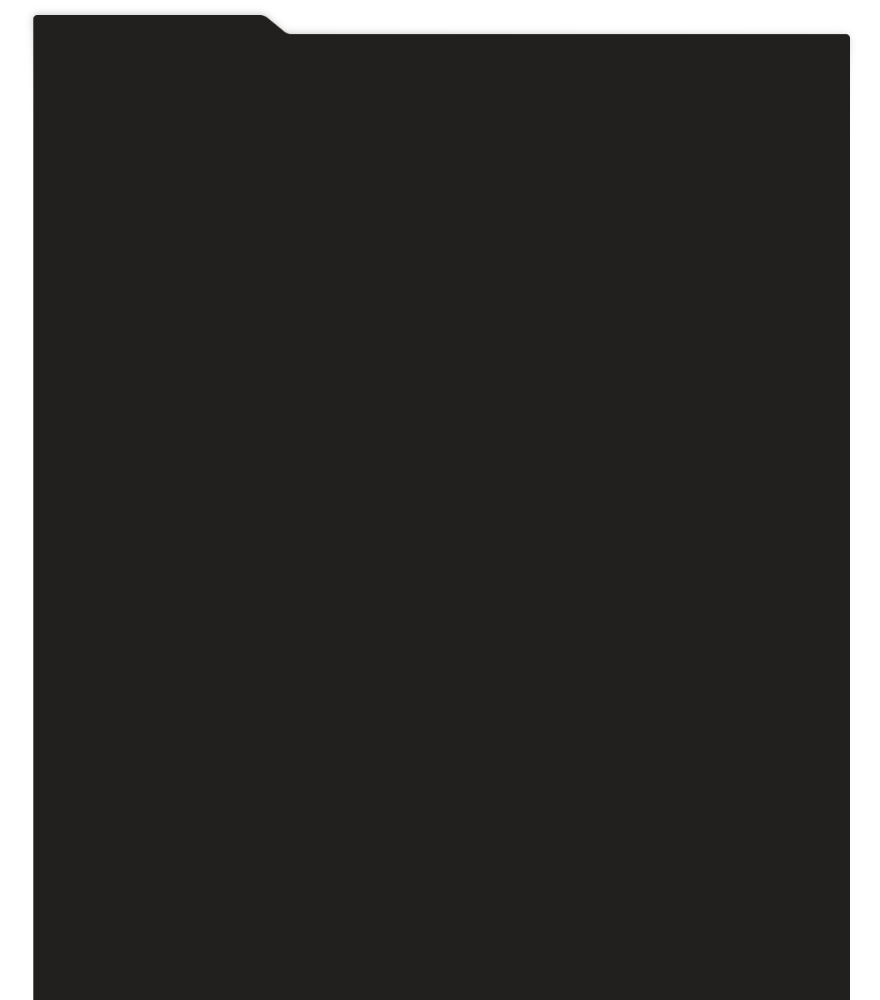
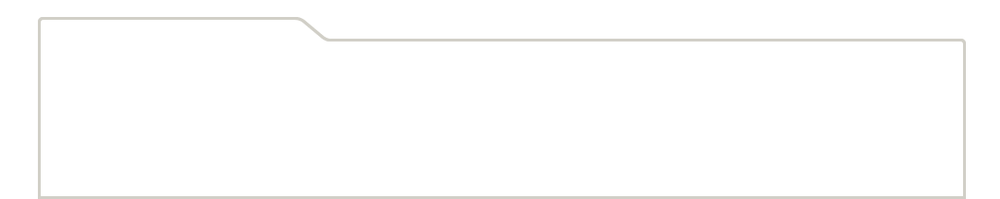
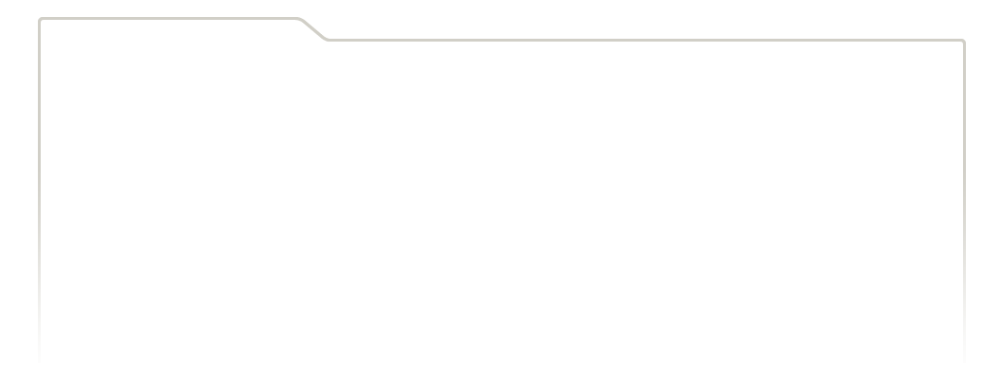
...
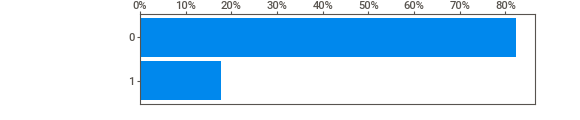
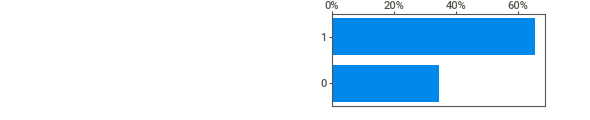
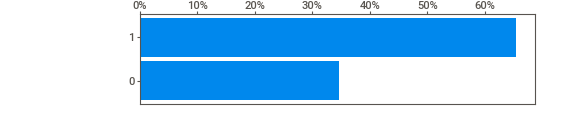
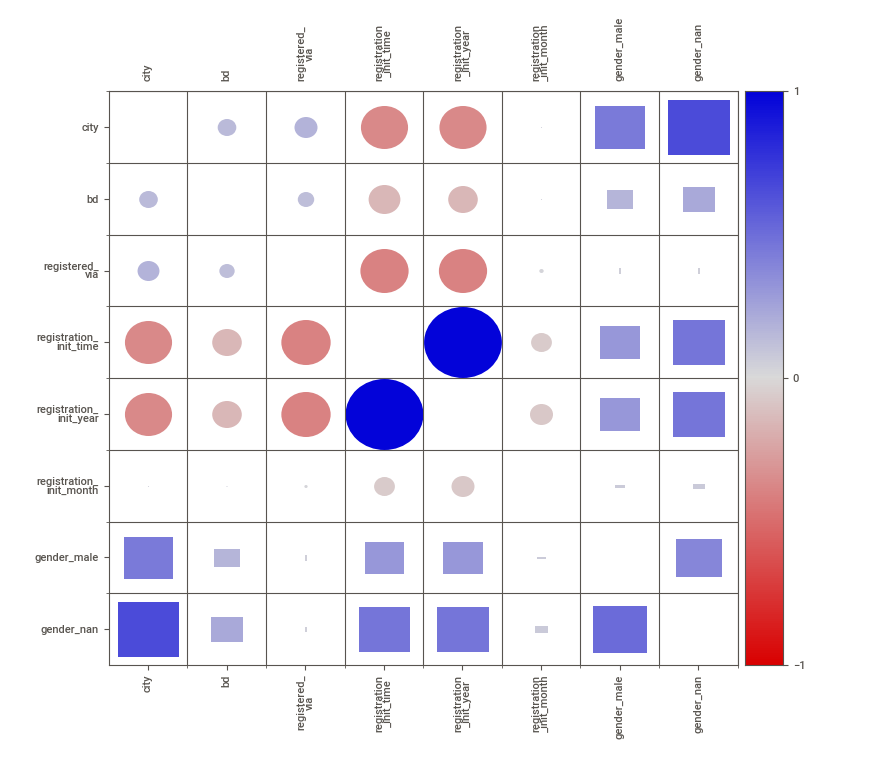
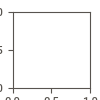

In [ ]:
HTML(filename="SWEETVIZ_REPORT_df_members_med_mod.html")

In [ ]:
df_members_med_mod.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/members_med_mod.csv', index = False)

## Preprocessing User_logs.csv

### Carregar dados

O arquivo é muito grande, precisa fazer o upload do arquivo zipado no colab e dentro do notebook fazer o unzip

In [ ]:
!p7zip -d "/content/gdrive/MyDrive/Colab Notebooks/user_logs.csv.7z"


7-Zip (a) [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,4 CPUs Intel(R) Xeon(R) CPU @ 2.30GHz (306F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/gdrive/MyDrive/Colab Notebooks/                                                  1 file, 7136060375 bytes (6806 MiB)

Extracting archive: /content/gdrive/MyDrive/Colab Notebooks/user_logs.csv.7z
--
Path = /content/gdrive/MyDrive/Colab Notebooks/user_logs.csv.7z
Type = 7z
Physical Size = 7136060375
Headers Size = 130
Method = LZMA2:24
Solid = -
Blocks = 1

  0%      0% - user_logs.csv                      1% - user_logs.csv                      2% - user_logs.csv                      3% - user_logs.csv

### Primeira Carga

In [ ]:
columns1 = ["msno","num_25"]

In [ ]:
df_user_logs = pd.read_csv('user_logs.csv', usecols = columns1)



In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    num_25_sum=('num_25', 'sum'),
)
                                    

In [ ]:
df_user_logs_group1.to_csv('user_logs_group1.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                    num_25_min=('num_25', 'min'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group2.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                                                                                                                                                                                                                                                                                            
                                    num_25_mean=('num_25', 'mean'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group3.csv', index = False)

### Segunda Carga

In [ ]:
columns2 = ["msno","num_50"]

In [ ]:
df_user_logs = pd.read_csv('user_logs.csv', usecols = columns2)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    num_50_sum=('num_50', 'sum'),
)
                                    

In [ ]:
df_user_logs_group1.to_csv('user_logs_group5.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                    num_50_min=('num_50', 'min'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group6.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                                                                                                                                                                                                                                                                                            
                                    num_50_mean=('num_50', 'mean'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group7.csv', index = False)

### Terceira Carga

In [ ]:
columns3 = ["msno","num_985"]

In [ ]:
df_user_logs = pd.read_csv('user_logs.csv', usecols = columns3)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    num_985_sum=('num_985', 'sum'),
)
                                    

In [ ]:
df_user_logs_group1.to_csv('user_logs_group9.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                    num_985_min=('num_985', 'min'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group10.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                                                                                                                                                                                                                                                                                            
                                    num_985_mean=('num_985', 'mean'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group11.csv', index = False)

### Quarta Carga

In [ ]:
columns4 = ["msno","num_100"]

In [ ]:
df_user_logs = pd.read_csv('user_logs.csv', usecols = columns4)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    num_100_sum=('num_100', 'sum'),
)
                                    

In [ ]:
df_user_logs_group1.to_csv('user_logs_group13.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                    num_100_min=('num_100', 'min'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group14.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                                                                                                                                                                                                                                                                                            
                                    num_100_mean=('num_100', 'mean'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group15.csv', index = False)

### Quinta Carga

In [ ]:
columns5 = ["msno","total_secs"]

In [ ]:
df_user_logs = pd.read_csv('user_logs.csv', usecols = columns5)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    total_secs_sum=('total_secs', 'sum'),
)
                                    

In [ ]:
df_user_logs_group1.to_csv('user_logs_group17.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                    total_secs_min=('total_secs', 'min'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group18.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                                                                                                                                                                                                                                                                                            
                                    total_secs_mean=('total_secs', 'mean'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group19.csv', index = False)

### Sexta Carga

In [ ]:
columns6 = ["msno","num_unq"]

In [ ]:
df_user_logs = pd.read_csv('user_logs.csv', usecols = columns6)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    num_unq_sum=('num_unq', 'sum'),
)
                                    

In [ ]:
df_user_logs_group1.to_csv('user_logs_group21.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                    num_unq_min=('num_unq', 'min'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group22.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                                                                                                                                                                                                                                                                                            
                                    num_unq_mean=('num_unq', 'mean'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group23.csv', index = False)

### Sétima Carga

In [ ]:
columns7 = ["msno","date"]

In [ ]:
df_user_logs = pd.read_csv('user_logs.csv', usecols = columns7)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                                                                                                                                                                                                                                                                                            
                                    last_login=('date', 'max'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group24.csv', index = False)

In [ ]:
df_user_logs_group1 = df_user_logs.groupby('msno', as_index=False).agg(
                                    
                                                                                                                                                                                                                                                                                                            
                                    login_count=('date', 'count'))

In [ ]:
df_user_logs_group1.to_csv('user_logs_group25.csv', index = False)

### Fundir as cargas

In [ ]:
df_user_logs1 = pd.read_csv('user_logs_group1.csv')

In [ ]:
df_user_logs2 = pd.read_csv('user_logs_group2.csv')

In [ ]:
df_user_logs_group_all_1 = pd.merge(df_user_logs1, df_user_logs2, on='msno', how='left')

In [ ]:
df_user_logs3 = pd.read_csv('user_logs_group3.csv')

In [ ]:
df_user_logs_group_all_2 = pd.merge(df_user_logs_group_all_1, df_user_logs3, on='msno', how='left')

In [ ]:
df_user_logs5 = pd.read_csv('user_logs_group5.csv')

In [ ]:
df_user_logs_group_all_3 = pd.merge(df_user_logs_group_all_2, df_user_logs5, on='msno', how='left')

In [ ]:
df_user_logs6 = pd.read_csv('user_logs_group6.csv')

In [ ]:
df_user_logs_group_all_4 = pd.merge(df_user_logs_group_all_3, df_user_logs6, on='msno', how='left')

In [ ]:
df_user_logs7 = pd.read_csv('user_logs_group7.csv')

In [ ]:
df_user_logs_group_all_5 = pd.merge(df_user_logs_group_all_4, df_user_logs7, on='msno', how='left')

In [ ]:
df_user_logs9 = pd.read_csv('user_logs_group9.csv')

In [ ]:
df_user_logs_group_all_6 = pd.merge(df_user_logs_group_all_5, df_user_logs9, on='msno', how='left')

In [ ]:
df_user_logs10 = pd.read_csv('user_logs_group10.csv')

In [ ]:
df_user_logs_group_all_7 = pd.merge(df_user_logs_group_all_6, df_user_logs10, on='msno', how='left')

In [ ]:
df_user_logs11 = pd.read_csv('user_logs_group11.csv')

In [ ]:
df_user_logs_group_all_8 = pd.merge(df_user_logs_group_all_7, df_user_logs11, on='msno', how='left')

In [ ]:
df_user_logs13 = pd.read_csv('user_logs_group13.csv')

In [ ]:
df_user_logs_group_all_9 = pd.merge(df_user_logs_group_all_8, df_user_logs13, on='msno', how='left')

In [ ]:
df_user_logs14 = pd.read_csv('user_logs_group14.csv')

In [ ]:
df_user_logs_group_all_10 = pd.merge(df_user_logs_group_all_9, df_user_logs14, on='msno', how='left')

In [ ]:
df_user_logs15 = pd.read_csv('user_logs_group15.csv')

In [ ]:
df_user_logs_group_all_11 = pd.merge(df_user_logs_group_all_10, df_user_logs15, on='msno', how='left')

In [ ]:
df_user_logs17 = pd.read_csv('user_logs_group17.csv')

In [ ]:
df_user_logs_group_all_12 = pd.merge(df_user_logs_group_all_11, df_user_logs17, on='msno', how='left')

In [ ]:
df_user_logs18 = pd.read_csv('user_logs_group18.csv')

In [ ]:
df_user_logs_group_all_13 = pd.merge(df_user_logs_group_all_12, df_user_logs18, on='msno', how='left')

In [ ]:
df_user_logs19 = pd.read_csv('user_logs_group19.csv')

In [ ]:
df_user_logs_group_all_14 = pd.merge(df_user_logs_group_all_13, df_user_logs19, on='msno', how='left')

In [ ]:
df_user_logs21 = pd.read_csv('user_logs_group21.csv')

In [ ]:
df_user_logs_group_all_15 = pd.merge(df_user_logs_group_all_14, df_user_logs21, on='msno', how='left')

In [ ]:
df_user_logs22 = pd.read_csv('user_logs_group22.csv')

In [ ]:
df_user_logs_group_all_16 = pd.merge(df_user_logs_group_all_15, df_user_logs22, on='msno', how='left')

In [ ]:
df_user_logs23 = pd.read_csv('user_logs_group23.csv')

In [ ]:
df_user_logs_group_all_17 = pd.merge(df_user_logs_group_all_16, df_user_logs23, on='msno', how='left')

In [ ]:
df_user_logs24 = pd.read_csv('user_logs_group24.csv')

In [ ]:
df_user_logs_group_all_18 = pd.merge(df_user_logs_group_all_17, df_user_logs24, on='msno', how='left')

In [ ]:
df_user_logs25 = pd.read_csv('user_logs_group25.csv')

In [ ]:
df_user_logs_group_all_19 = pd.merge(df_user_logs_group_all_18, df_user_logs25, on='msno', how='left')

In [ ]:
df_user_logs_group_all_19.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/df_user_logs_group_all_final.csv', index = False)

In [ ]:
df_user_logs_group_all_19.to_csv('user_logs_group_all_final.csv', index = False)

In [ ]:
df_user_logs_group_all_final = pd.read_csv('user_logs_group_all_final.csv')

In [ ]:
df_user_logs_group_all_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5234111 entries, 0 to 5234110
Data columns (total 21 columns):
 #   Column           Dtype  
---  ------           -----  
 0   msno             object 
 1   num_25_sum       int64  
 2   num_25_min       int64  
 3   num_25_mean      float64
 4   num_50_sum       int64  
 5   num_50_min       int64  
 6   num_50_mean      float64
 7   num_985_sum      int64  
 8   num_985_min      int64  
 9   num_985_mean     float64
 10  num_100_sum      int64  
 11  num_100_min      int64  
 12  num_100_mean     float64
 13  total_secs_sum   float64
 14  total_secs_min   float64
 15  total_secs_mean  float64
 16  num_unq_sum      int64  
 17  num_unq_min      int64  
 18  num_unq_mean     float64
 19  last_login       int64  
 20  login_count      int64  
dtypes: float64(8), int64(12), object(1)
memory usage: 838.6+ MB


In [ ]:
df_user_logs_group_all_final.head(20)

,msno,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count
0,+++4vcS9aMH7KWdfh5git6nA5fC5jjisd5H/NcM++WM=,1,1,1.000000,1,1,1.000000,0,0,0.000000,0,0,0.000000,9.741100e+01,97.411,97.411000,2,2,2.000000,20150427,1
1,+++EI4HgyhgcJHIPXk/VRP7bt17+2joG39T6oEfJ+tc=,2,2,2.000000,0,0,0.000000,0,0,0.000000,0,0,0.000000,5.686800e+01,56.868,56.868000,1,1,1.000000,20160420,1
2,+++FOrTS7ab3tIgIh8eWwX4FqRv8w/FoiOuyXsFvphY=,60,0,8.571429,12,0,1.714286,7,0,1.000000,171,3,24.428571,4.999677e+04,834.189,7142.395857,179,2,25.571429,20160915,7
3,+++IZseRRiQS9aaSkH6cMYU6bGDcxUieAi/tH67sC5s=,817,0,1.313505,249,0,0.400322,195,0,0.313505,59354,0,95.424437,1.466484e+07,4.532,23576.915444,53604,1,86.180064,20170227,622
4,+++TipL0Kt3JvgNE9ahuJ8o+drJAnQINtxD4c5GePXI=,3,3,3.000000,3,3,3.000000,1,1,1.000000,14,14,14.000000,3.661527e+03,3661.527,3661.527000,22,22,22.000000,20151230,1
5,+++ceu6HDcfpatMwLD3loHSqgjp1iI4VrnAFTwRqcXw=,0,0,0.000000,0,0,0.000000,0,0,0.000000,100,5,11.111111,2.578429e+04,1258.264,2864.920667,17,1,1.888889,20160517,9
6,+++dz9ZCWE2HB/47pJU82NJXQzQuZDx1Wm50YSk/kKk=,5,0,1.250000,1,0,0.250000,1,0,0.250000,183,38,45.750000,4.673147e+04,9423.595,11682.868500,147,19,36.750000,20160302,4
7,+++hVY1rZox/33YtvDgmKA2Frg/2qhkz12B9ylCvh8o=,572,0,5.553398,289,0,2.805825,504,0,4.893204,2231,1,21.660194,7.198827e+05,643.805,6989.152534,2805,4,27.233010,20170228,103
8,+++l/EXNMLTijfLBa8p2TUVVVp2aFGSuUI/h7mLmthw=,1396,0,2.292282,494,0,0.811166,561,0,0.921182,15572,0,25.569787,4.061563e+06,33.749,6669.232486,15277,1,25.085386,20170228,609
9,+++rMjxjARDHEx9zEFOpvJEDBDhT1ncn0PEnCx3llA0=,10,0,0.625000,8,0,0.500000,6,0,0.375000,14,0,0.875000,5.674617e+03,32.397,354.663562,32,1,2.000000,20160703,16


In [ ]:
df_user_logs_group_all_final['msno'].nunique()

5234111

## Merging the Tables

## dataset

In [ ]:
df_user_logs_group_all_final = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/user_logs_group_all_final.csv')

In [ ]:
df_members_med_mod = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/members_med_mod.csv')


In [ ]:
df_transactions_mod = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/transactions_mod.csv')

In [ ]:
df_train = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/train.csv')

In [ ]:
df_members_med_mod["msno"].nunique()

6769473

In [ ]:
df_user_logs_group_all_final["msno"].nunique()

5234111

In [ ]:
df_transactions_mod["msno"].nunique()

2363626

In [ ]:
df_train["msno"].nunique()

992931

### Ordenação

1.   O dataset **df_train** possui a variavel de interesse. Apesar disso, apresenta o menor número de usuarios ("msno") únicos. Logo, os demais datasets possuem usuarios que "desconhecemos" o comportamento de "churn". Por isso, df_train será o dataset que receberá os dados dos demais datasets

1.   Para evitar que usuarios sem o comportamento de "churn" sejam incluidos no dataset final utilizaremos inner joins

1.   Como utilizamos apenas 0,1% do dataset "df_user_logs" será necessario reavaliar o preprocessing em busca de missing values

1.   Seguiremos com inner joins para evitar missing values


In [ ]:
df_kkbox1 = pd.merge(df_train, df_members_med_mod, on=["msno"])

In [ ]:
df_kkbox2 = pd.merge(df_kkbox1, df_transactions_mod, on=["msno"])

In [ ]:
df_kkbox3 = pd.merge(df_kkbox2, df_user_logs_group_all_final, on=["msno"])

In [ ]:
df_kkbox3.to_csv('kkbox3.csv', index = False)

In [ ]:
df_kkbox3.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox3.csv', index = False)

### Analise do dataset final

In [ ]:
#df_kkbox3 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox3.csv')

In [ ]:
df_kkbox3 = pd.read_csv('kkbox3.csv')

In [ ]:
df_kkbox3.duplicated().value_counts()

False    869900
dtype: int64

In [ ]:
df_kkbox3.drop_duplicates(inplace = True)

In [ ]:
df_kkbox3["msno"].nunique()

869900

In [ ]:
df_kkbox3.columns

Index(['msno', 'is_churn', 'city', 'bd', 'registered_via',
       'registration_init_time', 'registration_init_year',
       'registration_init_month', 'gender_male', 'gender_nan',
       'transactions_count', 'first_transactions', 'last_transactions',
       'payment_method_changes', 'payment_plan_days_mean',
       'payment_plan_days_total', 'payment_plan_days_min',
       'payment_plan_changes', 'plan_list_price_mean',
       'actual_amount_paid_mean', 'plan_list_price_total',
       'actual_amount_paid_total', 'plan_list_price_changes',
       'actual_amount_paid_changes', 'duration', 'payment_mean_diff',
       'payment_total_diff', 'auto_renew_off', 'auto_renew_on',
       'auto_renew_changed', 'cancel_off', 'cancel_on', 'cancel_changed',
       'num_25_sum', 'num_25_min', 'num_25_mean', 'num_50_sum', 'num_50_min',
       'num_50_mean', 'num_985_sum', 'num_985_min', 'num_985_mean',
       'num_100_sum', 'num_100_min', 'num_100_mean', 'total_secs_sum',
       'total_secs_min', 'to

In [ ]:
df_kkbox3.shape

(869900, 53)

In [ ]:
df_kkbox3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 869900 entries, 0 to 869899
Data columns (total 53 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   msno                        869900 non-null  object 
 1   is_churn                    869900 non-null  int64  
 2   city                        869900 non-null  int64  
 3   bd                          869900 non-null  float64
 4   registered_via              869900 non-null  int64  
 5   registration_init_time      869900 non-null  int64  
 6   registration_init_year      869900 non-null  int64  
 7   registration_init_month     869900 non-null  int64  
 8   gender_male                 869900 non-null  int64  
 9   gender_nan                  869900 non-null  int64  
 10  transactions_count          869900 non-null  int64  
 11  first_transactions          869900 non-null  int64  
 12  last_transactions           869900 non-null  int64  
 13  payment_method

In [ ]:
df_kkbox3.head()

,msno,is_churn,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count
0,waLDQMmcOu2jLDaV1ddDkgCrB/jl6sD66Xzs0Vqax1Y=,1,18,36.0,9,20050406,2005,4,0,0,2,20161031,20170107,1,18.500000,37,7,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,0,51,0,1.961538,16,0,0.615385,11,0,0.423077,409,0,15.730769,1.080519e+05,237.205,4155.840538,462,2,17.769231,20170208,26
1,QA7uiXy8vIbUSPOkCf9RwQ3FsT8jVq2OxDr8zqa7bRQ=,1,10,38.0,9,20050407,2005,4,1,0,23,20150131,20170224,2,28.826087,663,0,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,0,1,447,0,0.857965,157,0,0.301344,178,0,0.341651,9942,0,19.082534,2.615312e+06,1.533,5019.792971,7232,1,13.880998,20170215,521
2,fGwBva6hikQmTJzrbz/2Ezjm5Cth5jZUNvXigKK2AFA=,1,11,27.0,9,20051016,2005,10,0,0,10,20160202,20170112,2,30.000000,300,30,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,0,1,1570,0,6.624473,950,0,4.008439,479,0,2.021097,10033,0,42.333333,2.597385e+06,160.104,10959.428928,11533,1,48.662447,20170131,237
3,mT5V8rEpa+8wuqi6x0DoVd3H5icMKkE9Prt49UlmK+4=,1,13,23.0,9,20051102,2005,11,0,0,2,20160104,20160106,2,410.000000,820,410,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,0,7265,0,9.884354,2420,0,3.292517,1634,0,2.223129,18070,0,24.585034,4.945309e+06,2.847,6728.311370,18479,1,25.141497,20170221,735
4,XaPhtGLk/5UvvOYHcONTwsnH97P4eGECeq+BARGItRw=,1,3,27.0,9,20051228,2005,12,1,0,8,20150102,20170128,1,98.125000,785,30,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,0,1389,0,1.832454,714,0,0.941953,3228,0,4.258575,68731,0,90.674142,1.864415e+07,233.000,24596.500005,72674,1,95.875989,20170228,758


In [ ]:
df_kkbox3.tail()

,msno,is_churn,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count
869895,AkluQxz947GHW4Y/kWWgocI04EjDNVQUZpes+5VmWek=,0,8,24.0,7,20170129,2017,1,0,0,2,20170129,20170228,1,30.0,60,30,1,129.0,129.0,258,258,1,1,30,0.0,0,0,1,0,1,0,0,111,0,3.964286,28,0,1.000000,17,0,0.607143,403,1,14.392857,113233.454,566.993,4044.051929,451,4,16.107143,20170227,28
869896,xC4Mahxw+X2H9E5gwE0Bb/c1NliMLT5yAca80U4Hck8=,0,1,27.0,7,20170131,2017,1,0,1,2,20170131,20170228,1,30.0,60,30,1,100.0,100.0,200,200,1,1,28,0.0,0,0,1,0,1,0,0,3,3,3.000000,0,0,0.000000,0,0,0.000000,0,0,0.000000,11.616,11.616,11.616000,3,3,3.000000,20170131,1
869897,tUM0yxAj50Vc35vQZ++xMlomdyeLJUW9lEcoPnt3H+g=,0,12,24.0,4,20170201,2017,2,1,0,2,20170201,20170228,1,30.0,60,30,1,149.0,149.0,298,298,1,1,27,0.0,0,0,1,0,1,0,0,415,0,14.821429,63,0,2.250000,78,0,2.785714,1042,1,37.214286,290993.881,511.205,10392.638607,1222,6,43.642857,20170228,28
869898,KQS8etmfGgvE/7Y9gK+E9wdLnRTI0lyyPXaXL3I8E4c=,0,15,17.0,4,20170210,2017,2,0,0,1,20170219,20170219,1,60.0,60,60,1,0.0,0.0,0,0,1,1,0,0.0,0,1,0,0,1,0,0,14,0,2.800000,10,0,2.000000,0,0,0.000000,20,0,4.000000,6516.941,28.186,1303.388200,45,1,9.000000,20170222,5
869899,iNV99F1Rml7EMndOeLI0Y/iek6aCj/Qp1Z4dZvR+sak=,0,1,27.0,7,20170215,2017,2,0,1,3,20170215,20170215,1,30.0,90,30,1,100.0,100.0,300,300,1,1,0,0.0,0,0,1,0,0,0,1,66,0,7.333333,6,0,0.666667,5,0,0.555556,115,2,12.777778,33399.923,982.362,3711.102556,166,1,18.444444,20170228,9


In [ ]:
df_kkbox3.describe()

,is_churn,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count
count,869900.000000,869900.000000,869900.000000,869900.000000,8.699000e+05,869900.000000,869900.00000,869900.000000,869900.000000,869900.000000,8.699000e+05,8.699000e+05,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,869900.000000,8.699000e+05,8.699000e+05,8.699000e+05,869900.000000,869900.000000,869900.000000,8.699000e+05,869900.000000
mean,0.065693,5.899061,28.298509,6.908681,2.013230e+07,2013.161456,6.65562,0.235972,0.551813,16.280292,2.015432e+07,2.016986e+07,1.196624,34.080867,484.046734,22.230140,1.586123,148.889821,152.185625,2175.988186,2253.250164,1.677295,1.422824,502.037783,5.038343,100.900838,0.111514,0.792201,0.096285,0.756520,0.000018,0.243461,1836.798039,0.095874,5.933748,456.313725,0.017604,1.494287,317.286985,0.004818,0.952889,8644.585835,0.215918,24.593732,-3.600386e+14,-1.734723e+14,-7.073891e+11,8496.983428,1.267485,25.078107,2.016926e+07,282.257566
std,0.247744,6.427362,6.022464,1.908346,2.974381e+04,2.975997,3.60965,0.424605,0.497308,8.365735,5.521591e+03,1.963150e+03,0.502453,33.754735,232.893700,34.779315,0.748953,144.329536,144.469975,1180.122983,1237.853585,0.792991,0.710757,248.555005,13.039688,214.802242,0.314768,0.405732,0.294981,0.429182,0.004289,0.429171,2940.278253,1.584031,6.174718,635.680573,0.385528,1.456457,524.814119,0.116659,1.013337,12682.460529,1.763563,22.164878,4.236002e+15,1.252960e+15,8.647361e+12,10758.837536,2.243422,17.090381,3.339507e+03,224.091863
min,0.000000,1.000000,11.000000,3.000000,2.004033e+07,2004.000000,1.00000,0.000000,0.000000,1.000000,2.015010e+07,2.015010e+07,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-6.271893e+17,-9.223372e+15,-1.537229e+15,1.000000,1.000000,1.000000,2.015010e+07,1.000000
25%,0.000000,1.000000,27.000000,7.000000,2.012021e+07,2012.000000,3.00000,0.000000,0.000000,9.000000,2.015013e+07,2.017020e+07,1.000000,28.846154,300.000000,0.000000,1.000000,99.000000,99.000000,1192.000000,1188.000000,1.000000,1.000000,305.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,279.000000,0.000000,2.581190,76.000000,0.000000,0.700000,48.000000,0.000000,0.462295,1225.000000,0.000000,12.037736,3.006795e+05,4.075000e+00,3.276640e+03,1421.000000,1.000000,14.351852,2.017022e+07,83.000000
50%,0.000000,1.000000,27.000000,7.000000,2.014052e+07,2014.000000,7.00000,0.000000,1.000000,17.000000,2.015081e+07,2.017021e+07,1.000000,30.000000,480.000000,30.000000,1.000000,138.565217,145.000000,2086.000000,2086.000000,2.000000,1.000000,549.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,901.000000,0.000000

In [ ]:
df_kkbox3.isnull().sum()

msno                          0
is_churn                      0
city                          0
bd                            0
registered_via                0
registration_init_time        0
registration_init_year        0
registration_init_month       0
gender_male                   0
gender_nan                    0
transactions_count            0
first_transactions            0
last_transactions             0
payment_method_changes        0
payment_plan_days_mean        0
payment_plan_days_total       0
payment_plan_days_min         0
payment_plan_changes          0
plan_list_price_mean          0
actual_amount_paid_mean       0
plan_list_price_total         0
actual_amount_paid_total      0
plan_list_price_changes       0
actual_amount_paid_changes    0
duration                      0
payment_mean_diff             0
payment_total_diff            0
auto_renew_off                0
auto_renew_on                 0
auto_renew_changed            0
cancel_off                    0
cancel_o

In [ ]:
df_kkbox3.duplicated().value_counts()

False    869900
dtype: int64

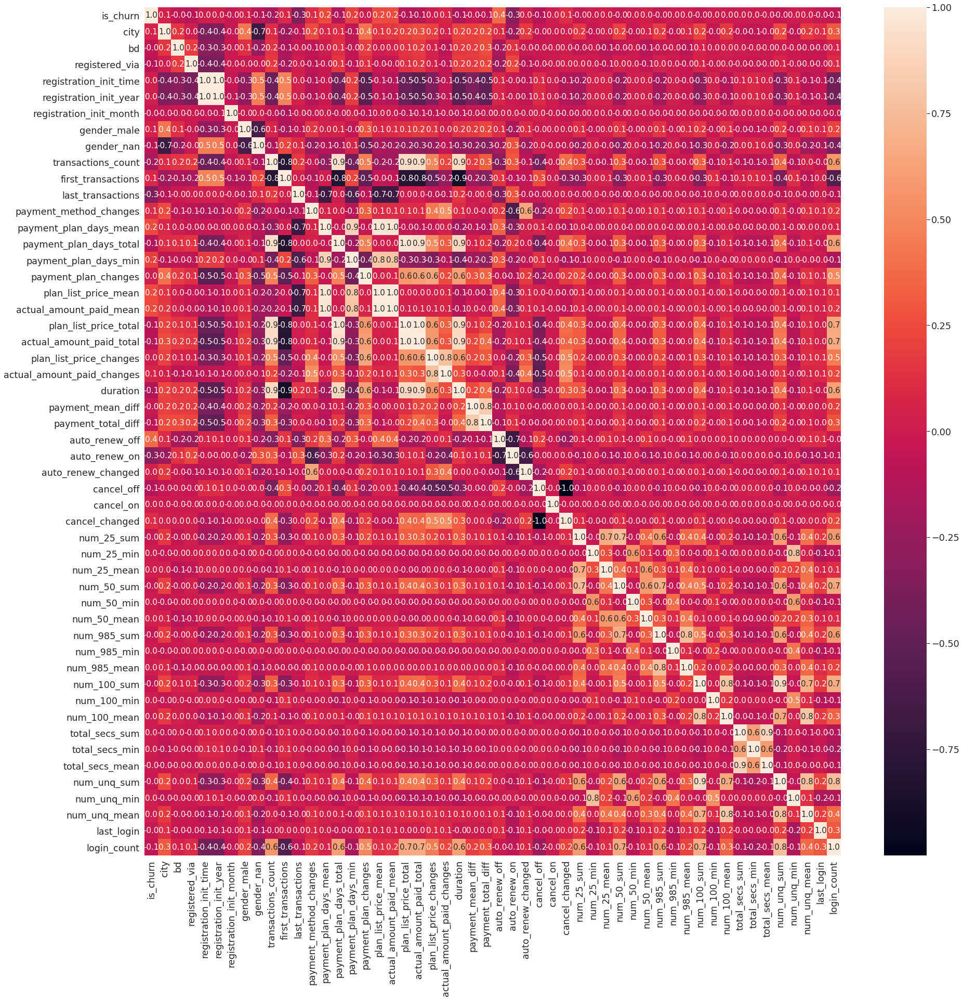

In [ ]:

sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(30,30)) 
sns.heatmap(df_kkbox3.corr(), annot=True, fmt='.1f', annot_kws={"size": 15})

### Resumo Correlação & Null Values: 

1.   **Null values**: Não foram identificados valores nulos
2.   **Correlação**: Além das correlações já identificadas, não foram identificadas novas correlações entre os dataset (joins)


In [ ]:
# Gerar o relatorio HTML abaixo
my_report = sv.analyze(df_kkbox3)
my_report.show_html()

                                             |          | [  0%]   00:00 -> (? left)

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



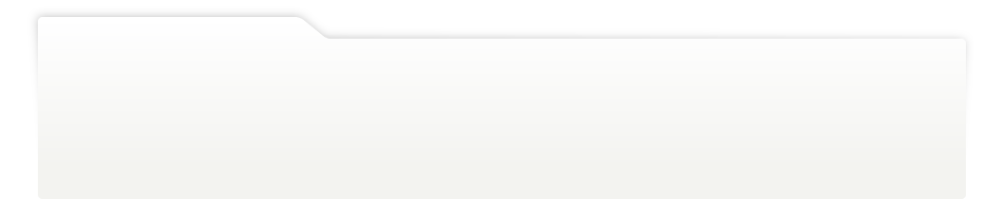
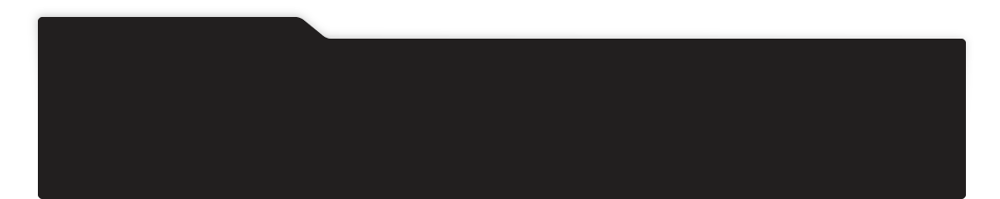
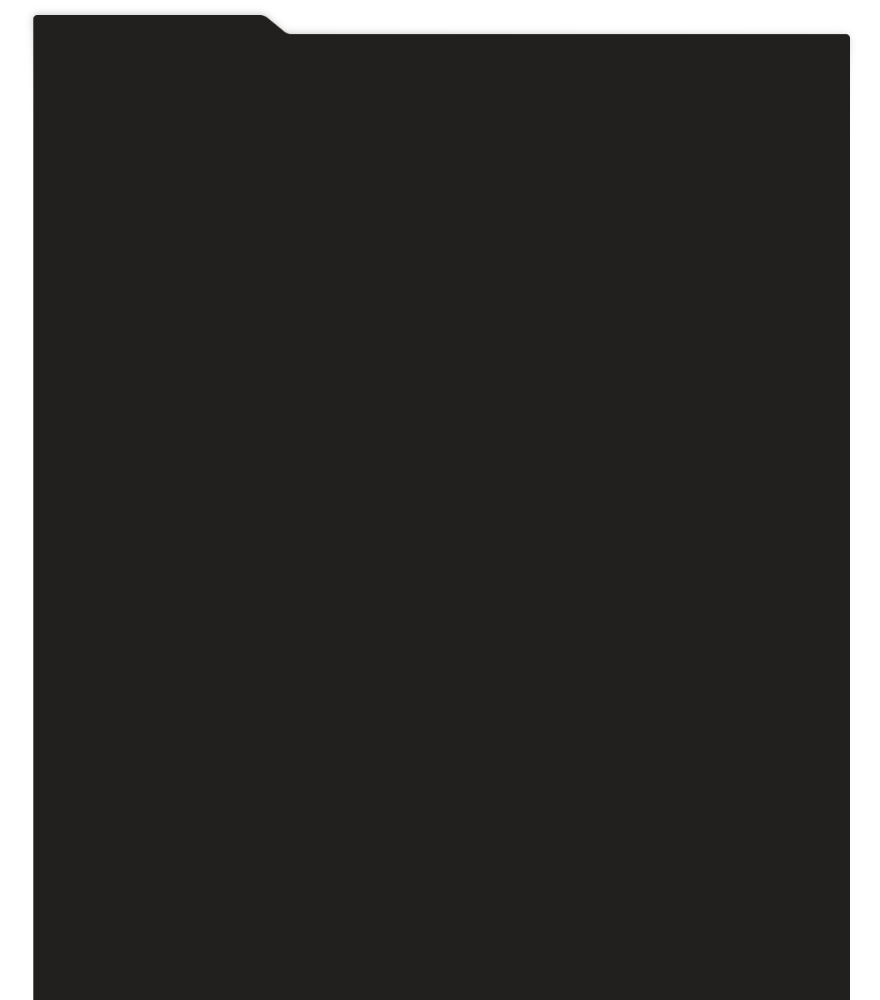
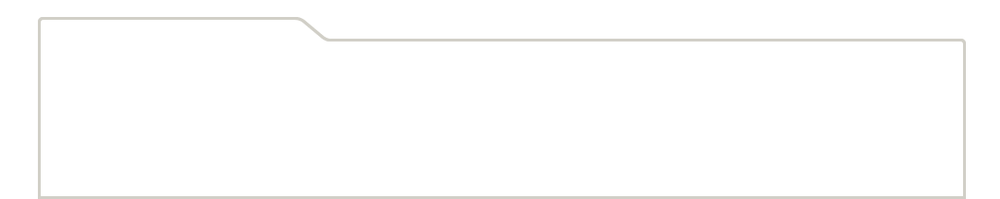
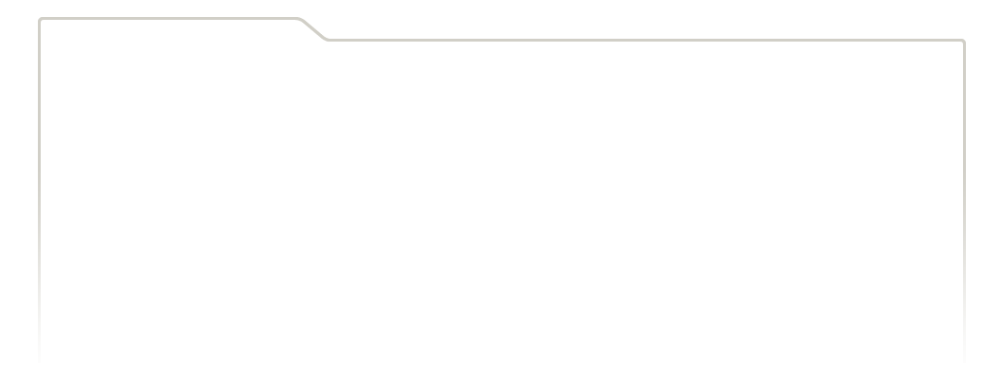
...
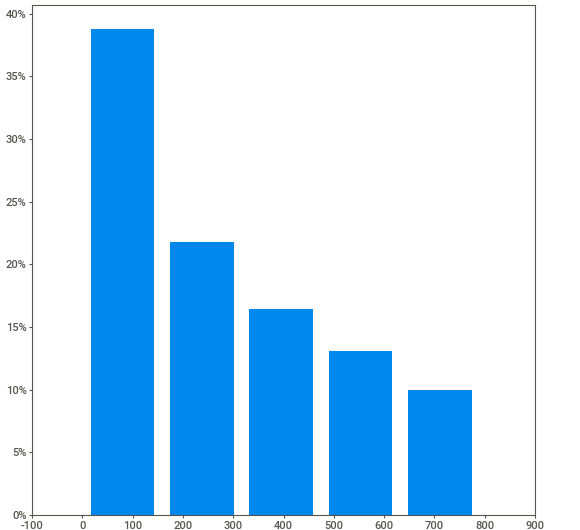
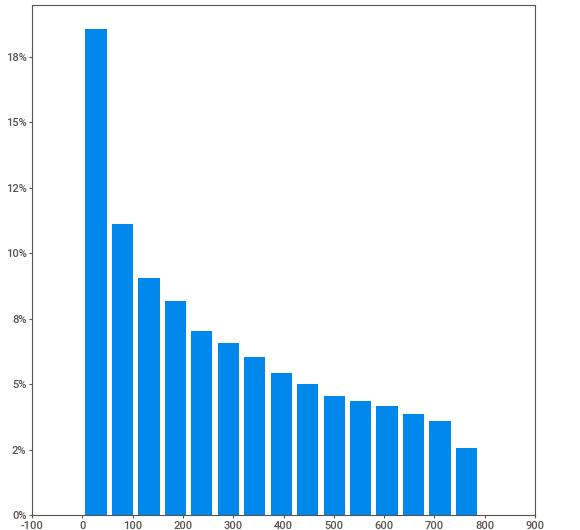
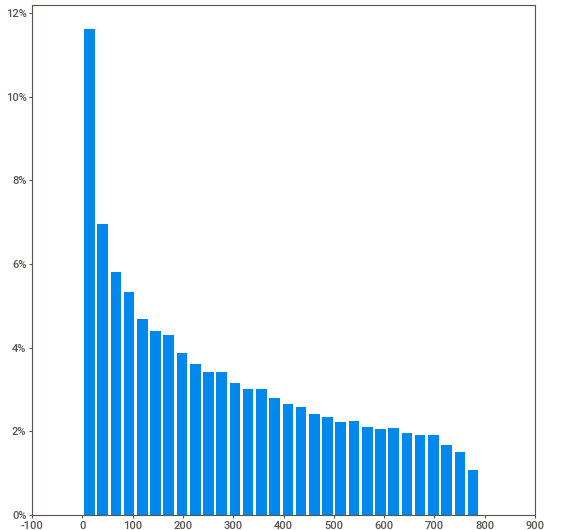
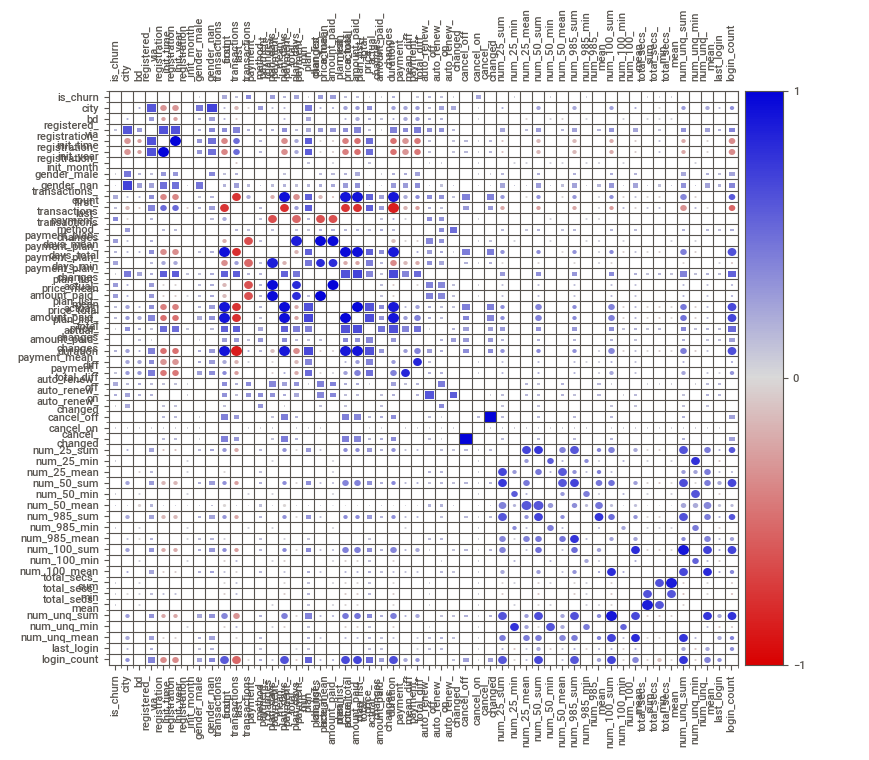
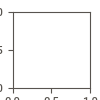

In [ ]:
HTML(filename="SWEETVIZ_REPORT_kkbox3_inner_join.html")



In [ ]:
df_kkbox3.to_csv('kkbox4.csv', index = False)

## Feature Engineering 


Deep feature synthesis (DFS) is an algorithm which enables you to quickly create new variables with varying depth. For example, you can multiply pairs of columns but you can also choose to first multiply Column A with Column B and then add Column C.

In [ ]:
# Create Entity

#es = ft.EntitySet(id = 'churn')
#es.entity_from_dataframe(entity_id = 'kkbox3', dataframe = df_kkbox3, index = 'index')


In [ ]:
# Run deep feature synthesis with transformation primitives
#df_kkbox4, feature_defs = ft.dfs(entityset = es, target_entity = 'kkbox3',
                                      trans_primitives = ['multiply_numeric'],
                                 primitive_options={'multiply_numeric': {'ignore_entities': ['msno']}}                                                              
                                 verbose=True)

In [ ]:
#df_kkbox4

In [ ]:
#fig, ax = plt.subplots(figsize=(10,10)) 
#sns.heatmap(df_kkbox4.corr(), annot=True)

## Padronização / Normalização


In [ ]:
#df_kkbox3 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox3.csv')

In [ ]:
df_kkbox4 = pd.read_csv('kkbox4.csv')

In [ ]:
# reorganizando o dataset

last_column = df_kkbox4.pop('is_churn')

In [ ]:

df_kkbox4.insert(52, 'is_churn', last_column)

In [ ]:
df_kkbox4.head()

,msno,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,waLDQMmcOu2jLDaV1ddDkgCrB/jl6sD66Xzs0Vqax1Y=,18,36.0,9,20050406,2005,4,0,0,2,20161031,20170107,1,18.500000,37,7,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,0,51,0,1.961538,16,0,0.615385,11,0,0.423077,409,0,15.730769,1.080519e+05,237.205,4155.840538,462,2,17.769231,20170208,26,1
1,QA7uiXy8vIbUSPOkCf9RwQ3FsT8jVq2OxDr8zqa7bRQ=,10,38.0,9,20050407,2005,4,1,0,23,20150131,20170224,2,28.826087,663,0,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,0,1,447,0,0.857965,157,0,0.301344,178,0,0.341651,9942,0,19.082534,2.615312e+06,1.533,5019.792971,7232,1,13.880998,20170215,521,1
2,fGwBva6hikQmTJzrbz/2Ezjm5Cth5jZUNvXigKK2AFA=,11,27.0,9,20051016,2005,10,0,0,10,20160202,20170112,2,30.000000,300,30,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,0,1,1570,0,6.624473,950,0,4.008439,479,0,2.021097,10033,0,42.333333,2.597385e+06,160.104,10959.428928,11533,1,48.662447,20170131,237,1
3,mT5V8rEpa+8wuqi6x0DoVd3H5icMKkE9Prt49UlmK+4=,13,23.0,9,20051102,2005,11,0,0,2,20160104,20160106,2,410.000000,820,410,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,0,7265,0,9.884354,2420,0,3.292517,1634,0,2.223129,18070,0,24.585034,4.945309e+06,2.847,6728.311370,18479,1,25.141497,20170221,735,1
4,XaPhtGLk/5UvvOYHcONTwsnH97P4eGECeq+BARGItRw=,3,27.0,9,20051228,2005,12,1,0,8,20150102,20170128,1,98.125000,785,30,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,0,1389,0,1.832454,714,0,0.941953,3228,0,4.258575,68731,0,90.674142,1.864415e+07,233.000,24596.500005,72674,1,95.875989,20170228,758,1


In [ ]:
# Retirando variaveis 
df_kkbox4 = df_kkbox4.drop(labels = ['msno'], axis=1)

#df_kkbox4.reset_index(drop = True)

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,18,36.0,9,20050406,2005,4,0,0,2,20161031,20170107,1,18.500000,37,7,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,0,51,0,1.961538,16,0,0.615385,11,0,0.423077,409,0,15.730769,1.080519e+05,237.205,4155.840538,462,2,17.769231,20170208,26,1
1,10,38.0,9,20050407,2005,4,1,0,23,20150131,20170224,2,28.826087,663,0,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,0,1,447,0,0.857965,157,0,0.301344,178,0,0.341651,9942,0,19.082534,2.615312e+06,1.533,5019.792971,7232,1,13.880998,20170215,521,1
2,11,27.0,9,20051016,2005,10,0,0,10,20160202,20170112,2,30.000000,300,30,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,0,1,1570,0,6.624473,950,0,4.008439,479,0,2.021097,10033,0,42.333333,2.597385e+06,160.104,10959.428928,11533,1,48.662447,20170131,237,1
3,13,23.0,9,20051102,2005,11,0,0,2,20160104,20160106,2,410.000000,820,410,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,0,7265,0,9.884354,2420,0,3.292517,1634,0,2.223129,18070,0,24.585034,4.945309e+06,2.847,6728.311370,18479,1,25.141497,20170221,735,1
4,3,27.0,9,20051228,2005,12,1,0,8,20150102,20170128,1,98.125000,785,30,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,0,1389,0,1.832454,714,0,0.941953,3228,0,4.258575,68731,0,90.674142,1.864415e+07,233.000,24596.500005,72674,1,95.875989,20170228,758,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
869895,8,24.0,7,20170129,2017,1,0,0,2,20170129,20170228,1,30.000000,60,30,1,129.000000,129.000000,258,258,1,1,30,0.000000,0,0,1,0,1,0,0,111,0,3.964286,28,0,1.000000,17,0,0.607143,403,1,14.392857,1.132335e+05,566.993,4044.051929,451,4,16.107143,20170227,28,0
869896,1,27.0,7,20170131,2017,1,0,1,2,20170131,20170228,1,30.000000,60,30,1,100.000000,100.000000,200,200,1,1,28,0.000000,0,0,1,0,1,0,0,3,3,3.000000,0,0,0.000000,0,0,0.000000,0,0,0.000000,1.161600e+01,11.616,11.616000,3,3,3.000000,20170131,1,0
869897,12,24.0,4,20170201,2017,2,1,0,2,20170201,20170228,1,30.000000,60,30,1,149.000000,149.000000,298,298,1,1,27,0.000000,0,0,1,0,1,0,0,415,0,14.821429,63,0,2.250000,78,0,2.785714,1042,1,37.214286,2.909939e+05,511.205,10392.638607,1222,6,43.642857,20170228,28,0
869898,15,17.0,4,20170210,2017,2,0,0,1,20170219,20170219,1,60.000000,60,60,1,0.000000,0.000000,0,0,1,1,0,0.000000,0,1,0,0,1,0,0,14,0,2.800000,10,0,2.000000,0,0,0.000000,20,0,4.000000,6.516941e+03,28.186,1303.388200,45,1,9.000000,20170222,5,0


In [ ]:
df_kkbox4.to_csv('kkbox5.csv', index = False)

## Nova amostragem

In [ ]:
df_kkbox5 = pd.read_csv('kkbox5.csv')

In [ ]:
df_kkbox5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 869900 entries, 0 to 869899
Data columns (total 52 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   city                        869900 non-null  int64  
 1   bd                          869900 non-null  float64
 2   registered_via              869900 non-null  int64  
 3   registration_init_time      869900 non-null  int64  
 4   registration_init_year      869900 non-null  int64  
 5   registration_init_month     869900 non-null  int64  
 6   gender_male                 869900 non-null  int64  
 7   gender_nan                  869900 non-null  int64  
 8   transactions_count          869900 non-null  int64  
 9   first_transactions          869900 non-null  int64  
 10  last_transactions           869900 non-null  int64  
 11  payment_method_changes      869900 non-null  int64  
 12  payment_plan_days_mean      869900 non-null  float64
 13  payment_plan_d

In [ ]:
filename = "kkbox5.csv"

In [ ]:
n = 869899   #number of records in file (excludes header)
s = 86990 #desired sample size
skip = sorted(random.sample(range(1,n+1),n-s)) #the 0-indexed header will not be included in the skip list

In [ ]:
df_kkbox5_sample10 = pd.read_csv(filename, skiprows=skip)

In [ ]:
df_kkbox5_sample10.to_csv('kkbox5_sample1 10%.csv', index = False)

In [ ]:
df_kkbox5_sample10.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample1 10%.csv', index = False)

In [ ]:
df_kkbox5_sample10.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86991 entries, 0 to 86990
Data columns (total 52 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   city                        86991 non-null  int64  
 1   bd                          86991 non-null  float64
 2   registered_via              86991 non-null  int64  
 3   registration_init_time      86991 non-null  int64  
 4   registration_init_year      86991 non-null  int64  
 5   registration_init_month     86991 non-null  int64  
 6   gender_male                 86991 non-null  int64  
 7   gender_nan                  86991 non-null  int64  
 8   transactions_count          86991 non-null  int64  
 9   first_transactions          86991 non-null  int64  
 10  last_transactions           86991 non-null  int64  
 11  payment_method_changes      86991 non-null  int64  
 12  payment_plan_days_mean      86991 non-null  float64
 13  payment_plan_days_total     869

# Teste com 10% do dataset para avaliar diferentes modelos

In [ ]:
df_kkbox5_sample10 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample1 10%.csv')

In [ ]:
df_kkbox5_sample10.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,13,29.0,9,20060406,2006,4,0,0,11,20150815,20170109,1,30.000000,330,30,1,160.909091,160.909091,1770,1770,2,2,513,0.000000,0,1,0,0,1,0,0,432,0,1.870130,56,0,0.242424,42,0,0.181818,12892,0,55.809524,2873030.886,71.007,12437.363143,9261,1,40.090909,20170209,231,1
1,13,26.0,9,20081105,2008,11,1,0,25,20150110,20170118,2,30.000000,750,30,1,149.000000,149.000000,3725,3725,1,1,739,0.000000,0,0,0,1,0,0,1,12117,0,16.091633,2867,0,3.807437,3184,0,4.228420,32896,0,43.686587,9451551.376,35.145,12551.861057,30892,1,41.025232,20170217,753,1
2,22,37.0,9,20090105,2009,1,0,0,24,20150316,20170217,1,30.125000,723,30,2,149.000000,142.791667,3576,3427,1,2,704,6.208333,149,0,1,0,0,0,1,234,0,0.426230,114,0,0.207650,121,0,0.220401,6777,0,12.344262,1706969.350,36.284,3109.233789,6965,1,12.686703,20170124,549,1
3,22,33.0,7,20100421,2010,4,0,0,9,20150113,20170114,1,63.333333,570,0,3,298.000000,314.555556,2682,2831,3,2,732,16.555556,149,1,0,0,1,0,0,2113,0,3.593537,706,0,1.200680,389,0,0.661565,21854,0,37.166667,5708495.744,0.392,9708.326095,20905,1,35.552721,20170214,588,1
4,1,27.0,7,20101205,2010,12,0,1,26,20150112,20160119,1,27.692308,720,0,2,137.538462,138.615385,3576,3604,2,2,372,1.076923,28,0,1,0,0,0,1,563,0,3.909722,113,0,0.784722,69,0,0.479167,4571,0,31.743056,1062897.421,10.671,7381.232090,2438,1,16.930556,20160124,144,1


## Separação dos dados

In [ ]:
X = df_kkbox5_sample10.iloc[:, :-1] 
y = df_kkbox5_sample10['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

## Padronização

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

## Analise exploratória de diferentes modelos

In [ ]:
classifiers = [
    KNeighborsClassifier(),
    GaussianNB(),
    LogisticRegression(dual = False, max_iter = 500000),
    SVC(),
    DecisionTreeClassifier(),
    RandomForestClassifier(),
    GradientBoostingClassifier()
]

for clf in classifiers:

    clf.fit(X_train, y_train)
    # armazenando o nome do modelo na variável name
    name = clf.__class__.__name__
    # imprimindo o nome do modelo
    print("=" * 30)
    print(name)
    # imprimindo os resultados do modelo
    print('****Results****')
    y_pred = clf.predict(X_test)
    print("Accuracy:", metrics.accuracy_score(y_test, 
                                              y_pred
                                             )
         )
    print("Precision:", metrics.precision_score(y_test, 
                                                y_pred
                                               )
         )
    print("Recall:", metrics.recall_score(y_test, 
                                          y_pred
                                         )
         )



KNeighborsClassifier
****Results****
Accuracy: 0.9377730094260096
Precision: 0.5430528375733855
Recall: 0.3241822429906542
GaussianNB
****Results****
Accuracy: 0.9326768334738295
Precision: 0.4774774774774775
Recall: 0.2786214953271028
LogisticRegression
****Results****
Accuracy: 0.9407617441949575
Precision: 0.6347402597402597
Recall: 0.2283878504672897
SVC
****Results****
Accuracy: 0.9421794773545865
Precision: 0.6645056726094003
Recall: 0.23948598130841123
DecisionTreeClassifier
****Results****
Accuracy: 0.9459728714844049
Precision: 0.5842633928571429
Recall: 0.6115654205607477
RandomForestClassifier
****Results****
Accuracy: 0.9638669629856694
Precision: 0.8049167327517843
Recall: 0.592873831775701
GradientBoostingClassifier
****Results****
Accuracy: 0.9622576442639282
Precision: 0.7948094079480941
Recall: 0.572429906542056


In [ ]:
classifiers = [
    KNeighborsClassifier(),
    GaussianNB(),
    LogisticRegression(dual = False, max_iter = 500000),
    SVC(),
    DecisionTreeClassifier(),
    RandomForestClassifier(),
    GradientBoostingClassifier()
]

for clf in classifiers:

    cv = StratifiedKFold(n_splits = 5, shuffle = True)
    scores = cross_validate(clf,X_train,y_train,cv=cv,scoring=['accuracy','precision','recall','f1'])
    # armazenando o nome do modelo na variável name
    #name = clf.__class__.__name__
    # imprimindo o nome do modelo
    print("=" * 30)
    print(clf)
    print("StratifiedKFold(n_splits = 5, shuffle = True)")
    # imprimindo os resultados do modelo
    print('****Results****')
    #y_pred = clf.predict(X_test)
    print("Accuracy:", scores["test_accuracy"].mean()
         )
    print("Precision:", scores["test_precision"].mean()
         )
    print("Recall:", scores["test_recall"].mean()
         )
    print("F1:", scores["test_f1"].mean()
         )



KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')
StratifiedKFold(n_splits = 5, shuffle = True)
****Results****
Accuracy: 0.9382687618401867
Precision: 0.5482899122442955
Recall: 0.32606044597063555
F1: 0.40867933167977355
GaussianNB(priors=None, var_smoothing=1e-09)
StratifiedKFold(n_splits = 5, shuffle = True)
****Results****
Accuracy: 0.9319790947242043
Precision: 0.46568152257690104
Recall: 0.26310946752074665
F1: 0.3361230358793852
LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=500000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
StratifiedKFold(n_splits = 5, shuffle = True)
****Results****
Accuracy: 0.9417010164428671
Pr

# Otimização dos melhores modelos (GridSearchCV and RandomizedSearchCV)


## DecisionTreeClassifier

In [ ]:
df_kkbox5_sample10 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample1 10%.csv')

In [ ]:
df_kkbox5_sample10.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,13,29.0,9,20060406,2006,4,0,0,11,20150815,20170109,1,30.000000,330,30,1,160.909091,160.909091,1770,1770,2,2,513,0.000000,0,1,0,0,1,0,0,432,0,1.870130,56,0,0.242424,42,0,0.181818,12892,0,55.809524,2873030.886,71.007,12437.363143,9261,1,40.090909,20170209,231,1
1,13,26.0,9,20081105,2008,11,1,0,25,20150110,20170118,2,30.000000,750,30,1,149.000000,149.000000,3725,3725,1,1,739,0.000000,0,0,0,1,0,0,1,12117,0,16.091633,2867,0,3.807437,3184,0,4.228420,32896,0,43.686587,9451551.376,35.145,12551.861057,30892,1,41.025232,20170217,753,1
2,22,37.0,9,20090105,2009,1,0,0,24,20150316,20170217,1,30.125000,723,30,2,149.000000,142.791667,3576,3427,1,2,704,6.208333,149,0,1,0,0,0,1,234,0,0.426230,114,0,0.207650,121,0,0.220401,6777,0,12.344262,1706969.350,36.284,3109.233789,6965,1,12.686703,20170124,549,1
3,22,33.0,7,20100421,2010,4,0,0,9,20150113,20170114,1,63.333333,570,0,3,298.000000,314.555556,2682,2831,3,2,732,16.555556,149,1,0,0,1,0,0,2113,0,3.593537,706,0,1.200680,389,0,0.661565,21854,0,37.166667,5708495.744,0.392,9708.326095,20905,1,35.552721,20170214,588,1
4,1,27.0,7,20101205,2010,12,0,1,26,20150112,20160119,1,27.692308,720,0,2,137.538462,138.615385,3576,3604,2,2,372,1.076923,28,0,1,0,0,0,1,563,0,3.909722,113,0,0.784722,69,0,0.479167,4571,0,31.743056,1062897.421,10.671,7381.232090,2438,1,16.930556,20160124,144,1


## Separação dos dados

In [ ]:
X = df_kkbox5_sample10.iloc[:, :-1] 
y = df_kkbox5_sample10['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

## Padronização

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
dtc_model = DecisionTreeClassifier() 

params = {'max_depth' : [2,3,5,7,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'criterion' : ['gini', 'entropy'],
          'splitter' : ['best', 'random']}


In [ ]:
random_dtc = RandomizedSearchCV(dtc_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_dtc.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    4.5s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=None,
       

In [ ]:
random_dtc.best_params_

{'criterion': 'gini',
 'max_depth': 5,
 'min_samples_leaf': 2,
 'min_samples_split': 7,
 'splitter': 'best'}

In [ ]:
random_dtc.best_score_

0.9585009754384869

### Testando log-loss do melhor parametro

In [ ]:
dtc_model_best = DecisionTreeClassifier(splitter= 'best',
                                   min_samples_split= 7,
                                   min_samples_leaf= 2,
                                   max_depth= 5,
                                   criterion= 'gini') 


In [ ]:
dtc_model_best.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=5, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=7,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dtc_model_best_probs = dtc_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, dtc_model_best_probs))

0.11073531634808055


In [ ]:
y_pred = dtc_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98     24386
           1       0.75      0.57      0.65      1712

    accuracy                           0.96     26098
   macro avg       0.86      0.78      0.82     26098
weighted avg       0.96      0.96      0.96     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[24065,   321],
       [  728,   984]])

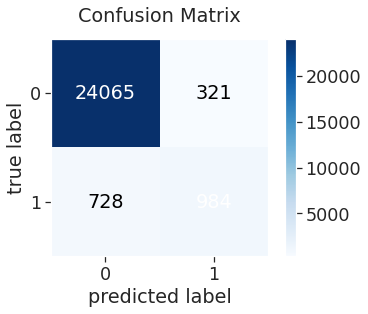

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox5_sample10.columns,dtc_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.0
bd:0.0010521074326403641
registered_via:0.001489154419049697
registration_init_time:0.0029977050223416912
registration_init_year:0.0
registration_init_month:0.0
gender_male:0.0
gender_nan:0.0
transactions_count:0.0
first_transactions:0.009655687023642848
last_transactions:0.5651554903271785
payment_method_changes:0.01368772840071514
payment_plan_days_mean:0.0
payment_plan_days_total:0.0
payment_plan_days_min:0.0
payment_plan_changes:0.0
plan_list_price_mean:0.014038916748600796
actual_amount_paid_mean:0.00022726564522873563
plan_list_price_total:0.0
actual_amount_paid_total:0.0
plan_list_price_changes:0.0
actual_amount_paid_changes:0.054003010199602894
duration:0.0
payment_mean_diff:0.0
payment_total_diff:0.0
auto_renew_off:0.05383829859762197
auto_renew_on:0.01660925546293384
auto_renew_changed:0.0
cancel_off:0.022087608306315107
cancel_on:0.0
cancel_changed:0.0
num_25_sum:0.0026987751945886525
num_25_min:0.0
num_25_mean:0.0
num_50_sum:0.0
num_50_min:0.0
num_50_mean:0.0
num_9

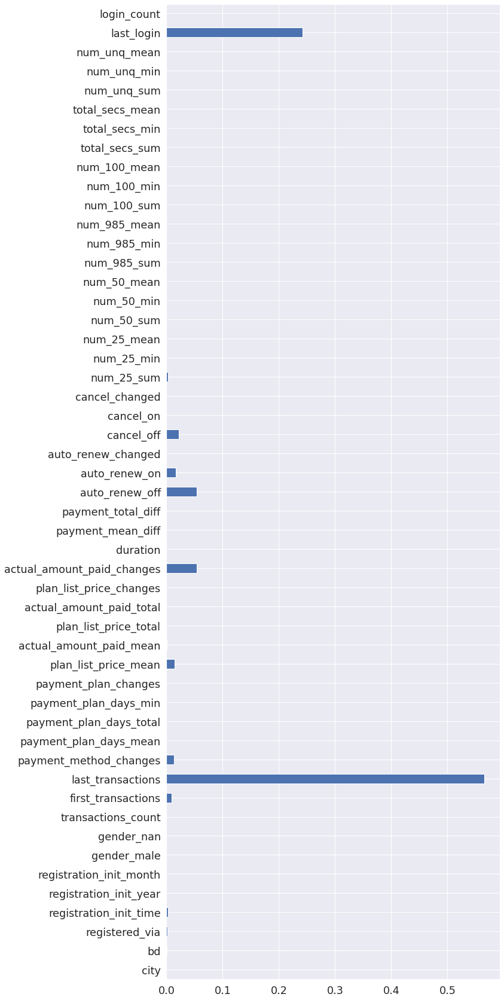

In [ ]:
feat_importances = pd.Series(dtc_model_best.feature_importances_, index=X.columns)


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                          False
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year        False
registration_init_month       False
gender_male                   False
gender_nan                    False
transactions_count            False
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean        False
payment_plan_days_total       False
payment_plan_days_min         False
payment_plan_changes          False
plan_list_price_mean           True
actual_amount_paid_mean       False
plan_list_price_total         False
actual_amount_paid_total      False
plan_list_price_changes       False
actual_amount_paid_changes     True
duration                      False
payment_mean_diff             False
payment_total_diff            False
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_dtc_drop = ['city','registration_init_year','registration_init_month','gender_male','gender_nan','transactions_count',
'payment_plan_days_mean','payment_plan_days_total','payment_plan_days_min',
'payment_plan_changes',
'plan_list_price_mean',
'actual_amount_paid_mean',

'actual_amount_paid_total',
'plan_list_price_changes',

'duration',
'payment_mean_diff',
'payment_total_diff',

'auto_renew_changed',
'cancel_off',
'cancel_on',
'cancel_changed',

'num_25_min',
'num_25_mean',
'num_50_sum',
'num_50_min',
'num_50_mean',
'num_985_sum' ,
'num_985_min' ,
'num_985_mean',
'num_100_sum',
'num_100_min',
'num_100_mean',
'total_secs_sum',
'total_secs_min',
'total_secs_mean',
'num_unq_sum',
'num_unq_min',
'num_unq_mean',

'login_count' ]


In [ ]:

df_kkbox5_sample10_dtc = df_kkbox5_sample10.drop(labels = labels_dtc_drop, axis=1)

In [ ]:
df_kkbox5_sample10_dtc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86991 entries, 0 to 86990
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   bd                          86991 non-null  float64
 1   registered_via              86991 non-null  int64  
 2   registration_init_time      86991 non-null  int64  
 3   first_transactions          86991 non-null  int64  
 4   last_transactions           86991 non-null  int64  
 5   payment_method_changes      86991 non-null  int64  
 6   plan_list_price_total       86991 non-null  int64  
 7   actual_amount_paid_changes  86991 non-null  int64  
 8   auto_renew_off              86991 non-null  int64  
 9   auto_renew_on               86991 non-null  int64  
 10  num_25_sum                  86991 non-null  int64  
 11  last_login                  86991 non-null  int64  
 12  is_churn                    86991 non-null  int64  
dtypes: float64(1), int64(12)
memory

In [ ]:
#df_kkbox5_sample10_dtc.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample10_dtc.csv', index = False)

In [ ]:
df_kkbox5_sample10_dtc = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample10_dtc.csv')

In [ ]:
df_kkbox5_sample10_dtc.head()

,bd,registered_via,registration_init_time,first_transactions,last_transactions,payment_method_changes,plan_list_price_total,actual_amount_paid_changes,auto_renew_off,auto_renew_on,num_25_sum,last_login,is_churn
0,29.0,9,20060406,20150815,20170109,1,1770,2,1,0,432,20170209,1
1,26.0,9,20081105,20150110,20170118,2,3725,1,0,0,12117,20170217,1
2,37.0,9,20090105,20150316,20170217,1,3576,2,0,1,234,20170124,1
3,33.0,7,20100421,20150113,20170114,1,2682,2,1,0,2113,20170214,1
4,27.0,7,20101205,20150112,20160119,1,3576,2,0,1,563,20160124,1


In [ ]:
X = df_kkbox5_sample10_dtc.iloc[:, :-1] 
y = df_kkbox5_sample10_dtc['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
dtc_model_feature = DecisionTreeClassifier() 

params = {'max_depth' : [2,3,5,7,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'criterion' : ['gini', 'entropy'],
          'splitter' : ['best', 'random']}


In [ ]:
random_dtc_feature = RandomizedSearchCV(dtc_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_dtc_feature.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=None,
       

In [ ]:
random_dtc_feature.best_params_

{'criterion': 'gini',
 'max_depth': 5,
 'min_samples_leaf': 1,
 'min_samples_split': 3,
 'splitter': 'best'}

In [ ]:
random_dtc_feature.best_score_

0.9549209267987804

In [ ]:
dtc_feature_model_best = DecisionTreeClassifier(splitter= 'best',
                                   min_samples_split= 3,
                                   min_samples_leaf= 1,
                                   max_depth= 5,
                                   criterion= 'gini') 


In [ ]:
dtc_feature_model_best.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=5, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=3,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dtc_feature_model_best_probs = dtc_feature_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, dtc_feature_model_best_probs))

0.1393814038955882


In [ ]:
y_pred = dtc_feature_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.96      0.99      0.98     24386
           1       0.78      0.45      0.57      1712

    accuracy                           0.96     26098
   macro avg       0.87      0.72      0.77     26098
weighted avg       0.95      0.96      0.95     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[24164,   222],
       [  939,   773]])

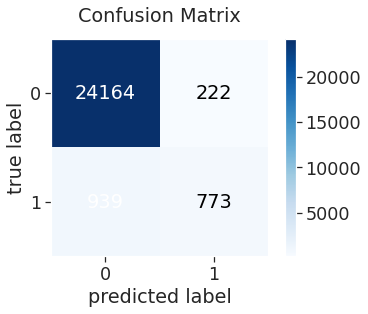

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

## RandomForestClassifier

In [ ]:
df_kkbox5_sample10 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample1 10%.csv')

In [ ]:
df_kkbox5_sample10.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,13,29.0,9,20060406,2006,4,0,0,11,20150815,20170109,1,30.000000,330,30,1,160.909091,160.909091,1770,1770,2,2,513,0.000000,0,1,0,0,1,0,0,432,0,1.870130,56,0,0.242424,42,0,0.181818,12892,0,55.809524,2873030.886,71.007,12437.363143,9261,1,40.090909,20170209,231,1
1,13,26.0,9,20081105,2008,11,1,0,25,20150110,20170118,2,30.000000,750,30,1,149.000000,149.000000,3725,3725,1,1,739,0.000000,0,0,0,1,0,0,1,12117,0,16.091633,2867,0,3.807437,3184,0,4.228420,32896,0,43.686587,9451551.376,35.145,12551.861057,30892,1,41.025232,20170217,753,1
2,22,37.0,9,20090105,2009,1,0,0,24,20150316,20170217,1,30.125000,723,30,2,149.000000,142.791667,3576,3427,1,2,704,6.208333,149,0,1,0,0,0,1,234,0,0.426230,114,0,0.207650,121,0,0.220401,6777,0,12.344262,1706969.350,36.284,3109.233789,6965,1,12.686703,20170124,549,1
3,22,33.0,7,20100421,2010,4,0,0,9,20150113,20170114,1,63.333333,570,0,3,298.000000,314.555556,2682,2831,3,2,732,16.555556,149,1,0,0,1,0,0,2113,0,3.593537,706,0,1.200680,389,0,0.661565,21854,0,37.166667,5708495.744,0.392,9708.326095,20905,1,35.552721,20170214,588,1
4,1,27.0,7,20101205,2010,12,0,1,26,20150112,20160119,1,27.692308,720,0,2,137.538462,138.615385,3576,3604,2,2,372,1.076923,28,0,1,0,0,0,1,563,0,3.909722,113,0,0.784722,69,0,0.479167,4571,0,31.743056,1062897.421,10.671,7381.232090,2438,1,16.930556,20160124,144,1


## Separação dos dados

In [ ]:
X = df_kkbox5_sample10.iloc[:, :-1] 
y = df_kkbox5_sample10['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

## Padronização

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
rf_model = RandomForestClassifier()

params = {'n_estimators' : [100,200,500,1000,2000],
          'max_features' : ['auto', 'sqrt'],
          'max_depth' : [2,3,5,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'bootstrap' : [True, False]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_rf = RandomizedSearchCV(rf_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_rf.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   13.4s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   13.4s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   13.5s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   13.7s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   23.1s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   23.3s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   23.8s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   26.7s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   33.0s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   33.3s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   57.4s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  1.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
random_rf.best_params_

{'bootstrap': True,
 'max_depth': 15,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 7,
 'n_estimators': 200}

In [ ]:
random_rf.best_score_

0.9610793024956428

### Testando log-loss do melhor parametro

In [ ]:
rf_model_best = RandomForestClassifier(n_estimators= 200,
                                       min_samples_split= 7,
                                       min_samples_leaf= 1,
                                       max_features= 'sqrt',
                                       max_depth= 15,
                                       bootstrap= True)

In [ ]:
rf_model_best.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=15, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=7,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf_model_best_probs = rf_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, rf_model_best_probs))

0.09564333263433371


In [ ]:
y_pred = rf_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98     24386
           1       0.81      0.58      0.68      1712

    accuracy                           0.96     26098
   macro avg       0.89      0.79      0.83     26098
weighted avg       0.96      0.96      0.96     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[24149,   237],
       [  714,   998]])

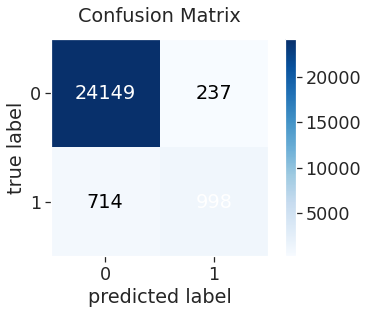

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox5_sample10.columns,rf_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.00791886716684787
bd:0.011423211142227196
registered_via:0.006893386701941819
registration_init_time:0.017025489352927164
registration_init_year:0.006816623844086756
registration_init_month:0.008191955902530282
gender_male:0.0016561458245137972
gender_nan:0.0017409489442625008
transactions_count:0.026310681958561878
first_transactions:0.02126489542913277
last_transactions:0.1991726080082846
payment_method_changes:0.008134566729816934
payment_plan_days_mean:0.01922549769981274
payment_plan_days_total:0.018240832362111457
payment_plan_days_min:0.008789150237658132
payment_plan_changes:0.0033795863096944224
plan_list_price_mean:0.029774753492265646
actual_amount_paid_mean:0.025797160429143758
plan_list_price_total:0.02445527163273575
actual_amount_paid_total:0.022579737682072304
plan_list_price_changes:0.010529270562961162
actual_amount_paid_changes:0.013467455767580487
duration:0.043242468726080306
payment_mean_diff:0.006685037487011551
payment_total_diff:0.003983213627390331
auto

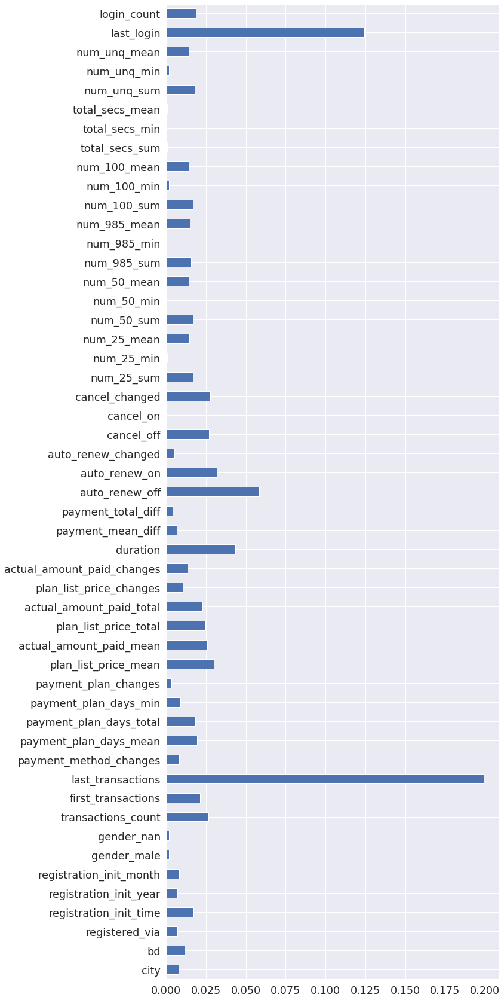

In [ ]:
feat_importances = pd.Series(rf_model_best.feature_importances_, index=X.columns)


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year         True
registration_init_month        True
gender_male                    True
gender_nan                     True
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total        True
payment_plan_days_min          True
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean        True
plan_list_price_total          True
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff              True
payment_total_diff             True
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_rf_drop = [


'cancel_on',                     

'num_25_min',                    

'num_50_min',                    

'num_985_min',                   

'total_secs_sum',                
'total_secs_min',                
'total_secs_mean'               
                

                   
 ]


In [ ]:

df_kkbox5_sample10_rf = df_kkbox5_sample10.drop(labels = labels_rf_drop, axis=1)

In [ ]:
df_kkbox5_sample10_rf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86991 entries, 0 to 86990
Data columns (total 45 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   city                        86991 non-null  int64  
 1   bd                          86991 non-null  float64
 2   registered_via              86991 non-null  int64  
 3   registration_init_time      86991 non-null  int64  
 4   registration_init_year      86991 non-null  int64  
 5   registration_init_month     86991 non-null  int64  
 6   gender_male                 86991 non-null  int64  
 7   gender_nan                  86991 non-null  int64  
 8   transactions_count          86991 non-null  int64  
 9   first_transactions          86991 non-null  int64  
 10  last_transactions           86991 non-null  int64  
 11  payment_method_changes      86991 non-null  int64  
 12  payment_plan_days_mean      86991 non-null  float64
 13  payment_plan_days_total     869

In [ ]:
#df_kkbox5_sample10_rf.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample10_rf.csv', index = False)

In [ ]:
df_kkbox5_sample10_rf = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample10_dtc.csv')

In [ ]:
df_kkbox5_sample10_rf.head()

,bd,registered_via,registration_init_time,first_transactions,last_transactions,payment_method_changes,plan_list_price_total,actual_amount_paid_changes,auto_renew_off,auto_renew_on,num_25_sum,last_login,is_churn
0,29.0,9,20060406,20150815,20170109,1,1770,2,1,0,432,20170209,1
1,26.0,9,20081105,20150110,20170118,2,3725,1,0,0,12117,20170217,1
2,37.0,9,20090105,20150316,20170217,1,3576,2,0,1,234,20170124,1
3,33.0,7,20100421,20150113,20170114,1,2682,2,1,0,2113,20170214,1
4,27.0,7,20101205,20150112,20160119,1,3576,2,0,1,563,20160124,1


In [ ]:
X = df_kkbox5_sample10_rf.iloc[:, :-1] 
y = df_kkbox5_sample10_rf['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
rf_model_feature = RandomForestClassifier()

params = {'n_estimators' : [100,200,500,1000,2000],
          'max_features' : ['auto', 'sqrt'],
          'max_depth' : [2,3,5,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'bootstrap' : [True, False]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_rf_feature = RandomizedSearchCV(rf_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_rf_feature.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    7.3s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  1.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
random_rf_feature.best_params_

{'bootstrap': True,
 'max_depth': 10,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 100}

In [ ]:
random_rf_feature.best_score_

0.9562347242400815

In [ ]:
rf_feature_model_best = RandomForestClassifier(n_estimators= 100,
                                       min_samples_split= 2,
                                       min_samples_leaf= 1,
                                       max_features= 'sqrt',
                                       max_depth= 10,
                                       bootstrap= True)

In [ ]:
rf_feature_model_best.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=10, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf_feature_model_best_probs = rf_feature_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, rf_feature_model_best_probs))

0.12392567384647335


In [ ]:
y_pred = rf_feature_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.96      0.99      0.98     24386
           1       0.81      0.45      0.58      1712

    accuracy                           0.96     26098
   macro avg       0.89      0.72      0.78     26098
weighted avg       0.95      0.96      0.95     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[24208,   178],
       [  942,   770]])

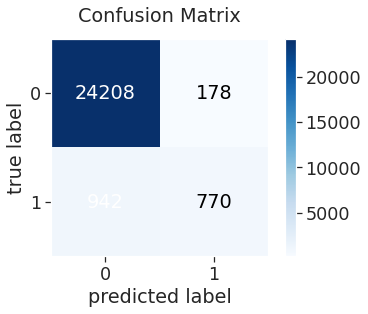

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

## GradientBoostingClassifier

In [ ]:
df_kkbox5_sample10 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample1 10%.csv')

In [ ]:
df_kkbox5_sample10.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,13,29.0,9,20060406,2006,4,0,0,11,20150815,20170109,1,30.000000,330,30,1,160.909091,160.909091,1770,1770,2,2,513,0.000000,0,1,0,0,1,0,0,432,0,1.870130,56,0,0.242424,42,0,0.181818,12892,0,55.809524,2873030.886,71.007,12437.363143,9261,1,40.090909,20170209,231,1
1,13,26.0,9,20081105,2008,11,1,0,25,20150110,20170118,2,30.000000,750,30,1,149.000000,149.000000,3725,3725,1,1,739,0.000000,0,0,0,1,0,0,1,12117,0,16.091633,2867,0,3.807437,3184,0,4.228420,32896,0,43.686587,9451551.376,35.145,12551.861057,30892,1,41.025232,20170217,753,1
2,22,37.0,9,20090105,2009,1,0,0,24,20150316,20170217,1,30.125000,723,30,2,149.000000,142.791667,3576,3427,1,2,704,6.208333,149,0,1,0,0,0,1,234,0,0.426230,114,0,0.207650,121,0,0.220401,6777,0,12.344262,1706969.350,36.284,3109.233789,6965,1,12.686703,20170124,549,1
3,22,33.0,7,20100421,2010,4,0,0,9,20150113,20170114,1,63.333333,570,0,3,298.000000,314.555556,2682,2831,3,2,732,16.555556,149,1,0,0,1,0,0,2113,0,3.593537,706,0,1.200680,389,0,0.661565,21854,0,37.166667,5708495.744,0.392,9708.326095,20905,1,35.552721,20170214,588,1
4,1,27.0,7,20101205,2010,12,0,1,26,20150112,20160119,1,27.692308,720,0,2,137.538462,138.615385,3576,3604,2,2,372,1.076923,28,0,1,0,0,0,1,563,0,3.909722,113,0,0.784722,69,0,0.479167,4571,0,31.743056,1062897.421,10.671,7381.232090,2438,1,16.930556,20160124,144,1


## Separação dos dados

In [ ]:
X = df_kkbox5_sample10.iloc[:, :-1] 
y = df_kkbox5_sample10['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

## Padronização

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
gb_model = GradientBoostingClassifier() 

params = {'max_depth':[2,3,5,7,10,15],
          'min_samples_split':[2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'learning_rate' : [0.02,0.05,0.07]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_gb = RandomizedSearchCV(gb_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_gb.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  4.3min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  4.3min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  4.3min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  4.4min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  5.9min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  5.9min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  6.0min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  7.5min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  7.6min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  7.6min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  8.4min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  9.1min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  9.2min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  9.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                        criterion='friedman_mse',
                                                        init=None,
                                                        learning_rate=0.1,
                                                        loss='deviance',
                                                        max_depth=3,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                 

In [ ]:
random_gb.best_params_

{'learning_rate': 0.05,
 'max_depth': 5,
 'min_samples_leaf': 2,
 'min_samples_split': 7}

In [ ]:
random_gb.best_score_

0.960997169675621

### Testando log-loss do melhor parametro

In [ ]:
gb_model_best = GradientBoostingClassifier(min_samples_split= 5,
                                           min_samples_leaf= 2,
                                           max_depth= 7,
                                           learning_rate= 0.05) 

In [ ]:
gb_model_best.fit(X_train, y_train)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.05, loss='deviance', max_depth=7,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=2, min_samples_split=5,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [ ]:
gb_model_best_probs = gb_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, gb_model_best_probs))

0.09388118124082151


In [ ]:
y_pred = gb_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98     24386
           1       0.77      0.62      0.69      1712

    accuracy                           0.96     26098
   macro avg       0.87      0.81      0.83     26098
weighted avg       0.96      0.96      0.96     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[24061,   325],
       [  642,  1070]])

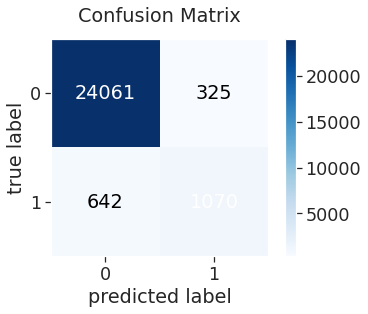

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox5_sample10.columns,gb_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.004280622691908495
bd:0.006757140579223761
registered_via:0.0037028665976684733
registration_init_time:0.014339419881291598
registration_init_year:0.0010082295123926732
registration_init_month:0.004264255969810328
gender_male:0.001308278947524145
gender_nan:0.0005806562189462376
transactions_count:0.006758550924733608
first_transactions:0.011744024111724611
last_transactions:0.43721728625070644
payment_method_changes:0.010398855070440124
payment_plan_days_mean:0.007446557699968742
payment_plan_days_total:0.01029721019721094
payment_plan_days_min:0.0014470419288759237
payment_plan_changes:0.0022550825003491504
plan_list_price_mean:0.01629640096873851
actual_amount_paid_mean:0.006962084885863745
plan_list_price_total:0.010315883265894867
actual_amount_paid_total:0.010278985820537183
plan_list_price_changes:0.0029168414615846783
actual_amount_paid_changes:0.04004553104580777
duration:0.018758983419927572
payment_mean_diff:0.0035824763668359278
payment_total_diff:0.00150916384438516

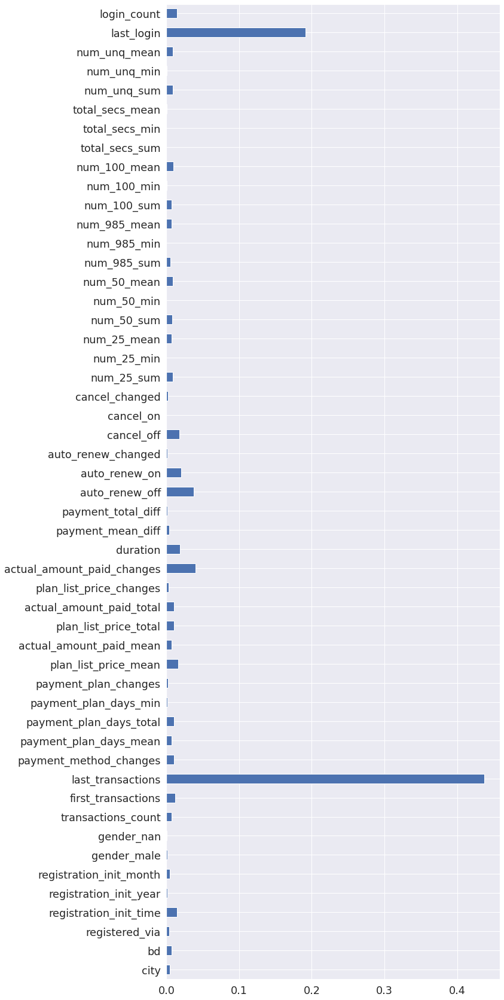

In [ ]:
feat_importances = pd.Series(gb_model_best.feature_importances_, index=X.columns)

sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year         True
registration_init_month        True
gender_male                    True
gender_nan                    False
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total        True
payment_plan_days_min          True
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean        True
plan_list_price_total          True
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff              True
payment_total_diff             True
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_gb_drop = [


'gender_nan',                    

'cancel_on',                     

'num_25_min',                    

'num_50_min',                    

'num_985_min',                   

'num_100_min',                   

'total_secs_sum',                
'total_secs_min',                
'total_secs_mean' ,              

'num_unq_min'                   

                   
 ]


In [ ]:

df_kkbox5_sample10_gb = df_kkbox5_sample10.drop(labels = labels_gb_drop, axis=1)

In [ ]:
df_kkbox5_sample10_gb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86991 entries, 0 to 86990
Data columns (total 42 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   city                        86991 non-null  int64  
 1   bd                          86991 non-null  float64
 2   registered_via              86991 non-null  int64  
 3   registration_init_time      86991 non-null  int64  
 4   registration_init_year      86991 non-null  int64  
 5   registration_init_month     86991 non-null  int64  
 6   gender_male                 86991 non-null  int64  
 7   transactions_count          86991 non-null  int64  
 8   first_transactions          86991 non-null  int64  
 9   last_transactions           86991 non-null  int64  
 10  payment_method_changes      86991 non-null  int64  
 11  payment_plan_days_mean      86991 non-null  float64
 12  payment_plan_days_total     86991 non-null  int64  
 13  payment_plan_days_min       869

In [ ]:
#df_kkbox5_sample10_gb.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample10_gb.csv', index = False)

In [ ]:
df_kkbox5_sample10_gb = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample10_gb.csv')

In [ ]:
df_kkbox5_sample10_gb.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,num_25_sum,num_25_mean,num_50_sum,num_50_mean,num_985_sum,num_985_mean,num_100_sum,num_100_mean,num_unq_sum,num_unq_mean,last_login,login_count,is_churn
0,13,29.0,9,20060406,2006,4,0,11,20150815,20170109,1,30.000000,330,30,1,160.909091,160.909091,1770,1770,2,2,513,0.000000,0,1,0,0,1,0,432,1.870130,56,0.242424,42,0.181818,12892,55.809524,9261,40.090909,20170209,231,1
1,13,26.0,9,20081105,2008,11,1,25,20150110,20170118,2,30.000000,750,30,1,149.000000,149.000000,3725,3725,1,1,739,0.000000,0,0,0,1,0,1,12117,16.091633,2867,3.807437,3184,4.228420,32896,43.686587,30892,41.025232,20170217,753,1
2,22,37.0,9,20090105,2009,1,0,24,20150316,20170217,1,30.125000,723,30,2,149.000000,142.791667,3576,3427,1,2,704,6.208333,149,0,1,0,0,1,234,0.426230,114,0.207650,121,0.220401,6777,12.344262,6965,12.686703,20170124,549,1
3,22,33.0,7,20100421,2010,4,0,9,20150113,20170114,1,63.333333,570,0,3,298.000000,314.555556,2682,2831,3,2,732,16.555556,149,1,0,0,1,0,2113,3.593537,706,1.200680,389,0.661565,21854,37.166667,20905,35.552721,20170214,588,1
4,1,27.0,7,20101205,2010,12,0,26,20150112,20160119,1,27.692308,720,0,2,137.538462,138.615385,3576,3604,2,2,372,1.076923,28,0,1,0,0,1,563,3.909722,113,0.784722,69,0.479167,4571,31.743056,2438,16.930556,20160124,144,1


In [ ]:
X = df_kkbox5_sample10_gb.iloc[:, :-1] 
y = df_kkbox5_sample10_gb['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
gb_model_feature = GradientBoostingClassifier() 

params = {'max_depth':[2,3,5,7,10,15],
          'min_samples_split':[2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'learning_rate' : [0.02,0.05,0.07]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_gb_feature = RandomizedSearchCV(gb_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_gb_feature.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  4.1min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  6.0min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  6.1min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  6.2min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  8.1min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 10.0min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 10.1min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 10.2min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 11.7min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed: 12.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                        criterion='friedman_mse',
                                                        init=None,
                                                        learning_rate=0.1,
                                                        loss='deviance',
                                                        max_depth=3,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                 

In [ ]:
random_gb_feature.best_params_

{'learning_rate': 0.07,
 'max_depth': 5,
 'min_samples_leaf': 2,
 'min_samples_split': 3}

In [ ]:
random_gb_feature.best_score_

0.9613256106079874

In [ ]:
gb_feature_model_best = GradientBoostingClassifier(min_samples_split= 3,
                                           min_samples_leaf= 2,
                                           max_depth= 5,
                                           learning_rate= 0.07) 

In [ ]:
gb_feature_model_best.fit(X_train, y_train)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.07, loss='deviance', max_depth=5,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=2, min_samples_split=3,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [ ]:
gb_feature_model_best_probs = gb_feature_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, gb_feature_model_best_probs))

0.09559414447427846


In [ ]:
y_pred = gb_feature_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98     24386
           1       0.78      0.62      0.69      1712

    accuracy                           0.96     26098
   macro avg       0.87      0.80      0.83     26098
weighted avg       0.96      0.96      0.96     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[24082,   304],
       [  659,  1053]])

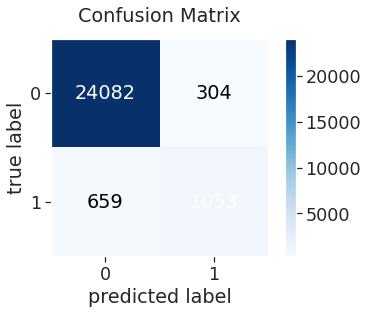

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

# Balanceamento de dados com SMOTE (10% do dataset)

## Hyperparameter tuning with GridSearchCV and RandomizedSearchCV


## DecisionTreeClassifier

### Preparação

In [ ]:
df_kkbox6 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample1 10%.csv')

In [ ]:
#df_kkbox6 = pd.read_csv('kkbox5_sample1 10%.csv')

In [ ]:
X = df_kkbox6.iloc[:, :-1] 
y = df_kkbox6['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

### Balancing data Using SMOTE

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 3987
Before OverSampling, counts of label '0': 56906 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (113812, 51)
After OverSampling, the shape of train_y: (113812,) 

After OverSampling, counts of label '1': 56906
After OverSampling, counts of label '0': 56906


### Padronização

In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
dtc_model = DecisionTreeClassifier() 

params = {'max_depth' : [2,3,5,7,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'criterion' : ['gini', 'entropy'],
          'splitter' : ['best', 'random']}


In [ ]:
random_dtc = RandomizedSearchCV(dtc_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_dtc.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    4.4s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=None,
       

In [ ]:
random_dtc.best_params_

{'criterion': 'entropy',
 'max_depth': 15,
 'min_samples_leaf': 1,
 'min_samples_split': 10,
 'splitter': 'best'}

In [ ]:
random_dtc.best_score_

0.9655048657675847

### Testando log-loss do melhor parametro

In [ ]:
dtc_model_best = DecisionTreeClassifier(splitter= 'best',
                                   min_samples_split= 10,
                                   min_samples_leaf= 1,
                                   max_depth= 15,
                                   criterion= 'entropy') 


In [ ]:
dtc_model_best.fit(X_train_res, y_train_res)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=15, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=10,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dtc_model_best_probs = dtc_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, dtc_model_best_probs))

17.157530833842852


In [ ]:
y_pred = dtc_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.48      0.65     24386
           1       0.12      0.99      0.21      1712

    accuracy                           0.51     26098
   macro avg       0.56      0.73      0.43     26098
weighted avg       0.94      0.51      0.62     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[11635, 12751],
       [   19,  1693]])

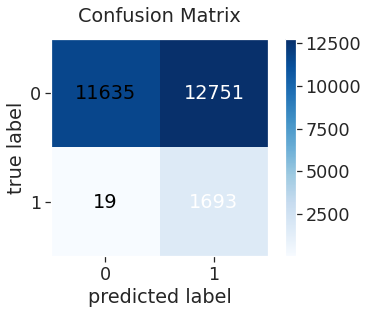

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox6.columns,dtc_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.002353993950308948
bd:0.0019321206577660628
registered_via:0.008125148317560086
registration_init_time:0.003842288588970202
registration_init_year:0.0007644681346772819
registration_init_month:0.0023994803591959406
gender_male:0.0032310786368668536
gender_nan:0.0030039701062818764
transactions_count:0.001198855523124001
first_transactions:0.004082020736894126
last_transactions:0.1403664857831473
payment_method_changes:0.006197754572463211
payment_plan_days_mean:0.0012862960224248052
payment_plan_days_total:0.002277930880392377
payment_plan_days_min:0.0007918060222176887
payment_plan_changes:0.0005362063015982022
plan_list_price_mean:0.003919089541605897
actual_amount_paid_mean:0.001869946203093667
plan_list_price_total:0.001356690358191027
actual_amount_paid_total:0.0031057221765888932
plan_list_price_changes:0.00218310006118699
actual_amount_paid_changes:0.029257977170944877
duration:0.004284011804609644
payment_mean_diff:0.0008743257396621167
payment_total_diff:0.0009173289374

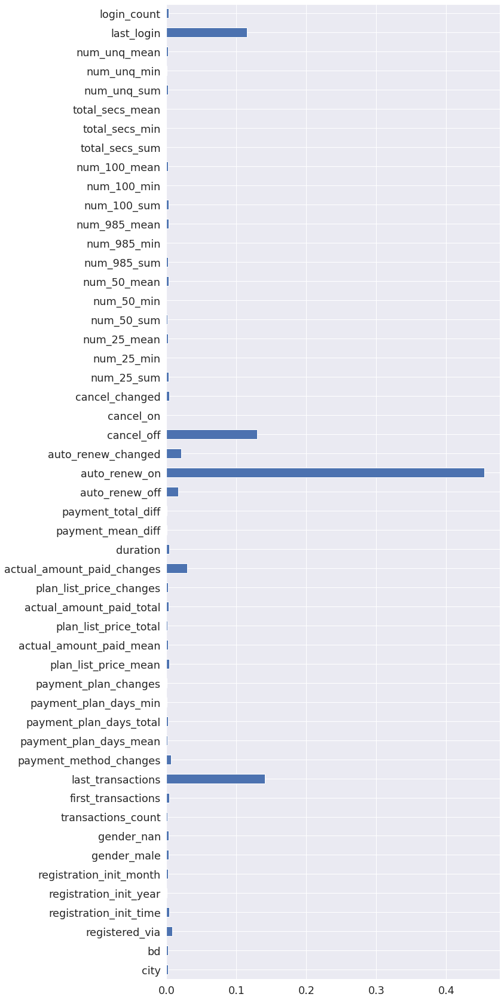

In [ ]:
feat_importances = pd.Series(dtc_model_best.feature_importances_, index=X.columns)


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year        False
registration_init_month        True
gender_male                    True
gender_nan                     True
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total        True
payment_plan_days_min         False
payment_plan_changes          False
plan_list_price_mean           True
actual_amount_paid_mean        True
plan_list_price_total          True
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff             False
payment_total_diff            False
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_dtc_drop = [
                   

'registration_init_year',        

'payment_plan_days_min',         
'payment_plan_changes',          

'payment_mean_diff' ,            
'payment_total_diff' ,           

'cancel_on' ,                    

'num_25_min',                    

'num_50_min',                    

'num_985_min',                   

'num_100_min' ,                  

'total_secs_sum' ,               
'total_secs_min'  ,              
'total_secs_mean' ,              

'num_unq_min'                   



 ]


In [ ]:

df_kkbox6_dtc = df_kkbox6.drop(labels = labels_dtc_drop, axis=1)

In [ ]:
df_kkbox6_dtc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86991 entries, 0 to 86990
Data columns (total 38 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   city                        86991 non-null  int64  
 1   bd                          86991 non-null  float64
 2   registered_via              86991 non-null  int64  
 3   registration_init_time      86991 non-null  int64  
 4   registration_init_month     86991 non-null  int64  
 5   gender_male                 86991 non-null  int64  
 6   gender_nan                  86991 non-null  int64  
 7   transactions_count          86991 non-null  int64  
 8   first_transactions          86991 non-null  int64  
 9   last_transactions           86991 non-null  int64  
 10  payment_method_changes      86991 non-null  int64  
 11  payment_plan_days_mean      86991 non-null  float64
 12  payment_plan_days_total     86991 non-null  int64  
 13  plan_list_price_mean        869

In [ ]:
#df_kkbox6_dtc.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox6_sample10_dtc.csv', index = False)

In [ ]:
df_kkbox6_dtc = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox6_sample10_dtc.csv')

In [ ]:
df_kkbox6_dtc.head()

,city,bd,registered_via,registration_init_time,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,num_25_sum,num_25_mean,num_50_sum,num_50_mean,num_985_sum,num_985_mean,num_100_sum,num_100_mean,num_unq_sum,num_unq_mean,last_login,login_count,is_churn
0,13,29.0,9,20060406,4,0,0,11,20150815,20170109,1,30.000000,330,160.909091,160.909091,1770,1770,2,2,513,1,0,0,1,0,432,1.870130,56,0.242424,42,0.181818,12892,55.809524,9261,40.090909,20170209,231,1
1,13,26.0,9,20081105,11,1,0,25,20150110,20170118,2,30.000000,750,149.000000,149.000000,3725,3725,1,1,739,0,0,1,0,1,12117,16.091633,2867,3.807437,3184,4.228420,32896,43.686587,30892,41.025232,20170217,753,1
2,22,37.0,9,20090105,1,0,0,24,20150316,20170217,1,30.125000,723,149.000000,142.791667,3576,3427,1,2,704,0,1,0,0,1,234,0.426230,114,0.207650,121,0.220401,6777,12.344262,6965,12.686703,20170124,549,1
3,22,33.0,7,20100421,4,0,0,9,20150113,20170114,1,63.333333,570,298.000000,314.555556,2682,2831,3,2,732,1,0,0,1,0,2113,3.593537,706,1.200680,389,0.661565,21854,37.166667,20905,35.552721,20170214,588,1
4,1,27.0,7,20101205,12,0,1,26,20150112,20160119,1,27.692308,720,137.538462,138.615385,3576,3604,2,2,372,0,1,0,0,1,563,3.909722,113,0.784722,69,0.479167,4571,31.743056,2438,16.930556,20160124,144,1


In [ ]:
X = df_kkbox6_dtc.iloc[:, :-1] 
y = df_kkbox6_dtc['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 3987
Before OverSampling, counts of label '0': 56906 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (113812, 37)
After OverSampling, the shape of train_y: (113812,) 

After OverSampling, counts of label '1': 56906
After OverSampling, counts of label '0': 56906


In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
dtc_model_feature = DecisionTreeClassifier() 

params = {'max_depth' : [2,3,5,7,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'criterion' : ['gini', 'entropy'],
          'splitter' : ['best', 'random']}


In [ ]:
random_dtc_feature = RandomizedSearchCV(dtc_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_dtc_feature.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    6.9s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    7.2s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    7.2s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    8.7s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    8.7s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    9.2s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:   1

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=None,
       

In [ ]:
random_dtc_feature.best_params_

{'criterion': 'entropy',
 'max_depth': 15,
 'min_samples_leaf': 2,
 'min_samples_split': 7,
 'splitter': 'best'}

In [ ]:
random_dtc_feature.best_score_

0.9665504148189002

In [ ]:
dtc_feature_model_best = DecisionTreeClassifier(splitter= 'best',
                                   min_samples_split= 7,
                                   min_samples_leaf= 2,
                                   max_depth= 15,
                                   criterion= 'entropy') 


In [ ]:
dtc_feature_model_best.fit(X_train_res, y_train_res)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=15, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=7,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dtc_feature_model_best_probs = dtc_feature_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, dtc_feature_model_best_probs))

31.863513541538858


In [ ]:
y_pred = dtc_feature_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.66      0.01      0.03     24386
           1       0.06      0.90      0.11      1712

    accuracy                           0.07     26098
   macro avg       0.36      0.46      0.07     26098
weighted avg       0.62      0.07      0.03     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[  321, 24065],
       [  166,  1546]])

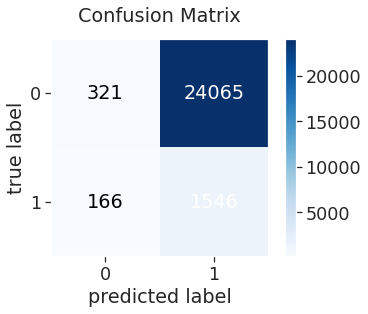

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

## RandomForestClassifier

### Preparação

In [ ]:
df_kkbox6 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample1 10%.csv')

In [ ]:
#df_kkbox6 = pd.read_csv('kkbox5_sample1 10%.csv')

In [ ]:
X = df_kkbox6.iloc[:, :-1] 
y = df_kkbox6['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

### Balancing data Using SMOTE

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 3987
Before OverSampling, counts of label '0': 56906 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (113812, 51)
After OverSampling, the shape of train_y: (113812,) 

After OverSampling, counts of label '1': 56906
After OverSampling, counts of label '0': 56906


### Padronização

In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
rf_model = RandomForestClassifier()

params = {'n_estimators' : [100,200,500,1000,2000],
          'max_features' : ['auto', 'sqrt'],
          'max_depth' : [2,3,5,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'bootstrap' : [True, False]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_rf = RandomizedSearchCV(rf_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_rf.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   53.5s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   53.8s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   54.0s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   54.5s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  5.1min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  5.2min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  5.8min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  5.

/usr/local/lib/python3.7/dist-packages/joblib/externals/loky/process_executor.py:691: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  "timeout or by a memory leak.", UserWarning


[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed: 49.3min
[Parallel(n_jobs=-1)]: Done  38 tasks      | elapsed: 50.0min
[Parallel(n_jobs=-1)]: Done  39 tasks      | elapsed: 50.6min
[Parallel(n_jobs=-1)]: Done  40 tasks      | elapsed: 51.2min
[Parallel(n_jobs=-1)]: Done  41 tasks      | elapsed: 51.3min
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed: 51.7min
[Parallel(n_jobs=-1)]: Done  43 tasks      | elapsed: 51.8min
[Parallel(n_jobs=-1)]: Done  45 out of  50 | elapsed: 54.0min remaining:  6.0min
[Parallel(n_jobs=-1)]: Done  47 out of  50 | elapsed: 54.2min remaining:  3.5min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed: 67.2min finished


RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
random_rf.best_params_

{'bootstrap': False,
 'max_depth': 15,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 2000}

In [ ]:
random_rf.best_score_

0.9731754117989135

### Testando log-loss do melhor parametro

In [ ]:
rf_model_best = RandomForestClassifier(n_estimators= 2000,
                                       min_samples_split= 2,
                                       min_samples_leaf= 1,
                                       max_features= 'sqrt',
                                       max_depth= 15,
                                       bootstrap= False)

In [ ]:
rf_model_best.fit(X_train_res, y_train_res)

RandomForestClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=15, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=2000,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf_model_best_probs = rf_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, rf_model_best_probs))

0.10025884527592972


In [ ]:
y_pred = rf_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98     24386
           1       0.70      0.70      0.70      1712

    accuracy                           0.96     26098
   macro avg       0.84      0.84      0.84     26098
weighted avg       0.96      0.96      0.96     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[23865,   521],
       [  507,  1205]])

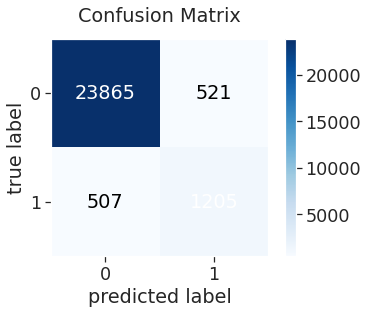

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox6.columns,rf_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.008403109443787006
bd:0.005300001828857898
registered_via:0.018775208292468207
registration_init_time:0.0036515809721403645
registration_init_year:0.0023255904489924346
registration_init_month:0.002803655640711017
gender_male:0.007236670638489862
gender_nan:0.015109514713868516
transactions_count:0.014672497036035792
first_transactions:0.007559882443447014
last_transactions:0.14083721488221002
payment_method_changes:0.025067673377061988
payment_plan_days_mean:0.021809589182993246
payment_plan_days_total:0.008902385902231332
payment_plan_days_min:0.013071076214814865
payment_plan_changes:0.008417451266648134
plan_list_price_mean:0.028468300866690555
actual_amount_paid_mean:0.03048133519981606
plan_list_price_total:0.005967067563177689
actual_amount_paid_total:0.006587230545553595
plan_list_price_changes:0.016173836443436933
actual_amount_paid_changes:0.028299514643053473
duration:0.016956248329216845
payment_mean_diff:0.003992006321212869
payment_total_diff:0.007205013398428813
a

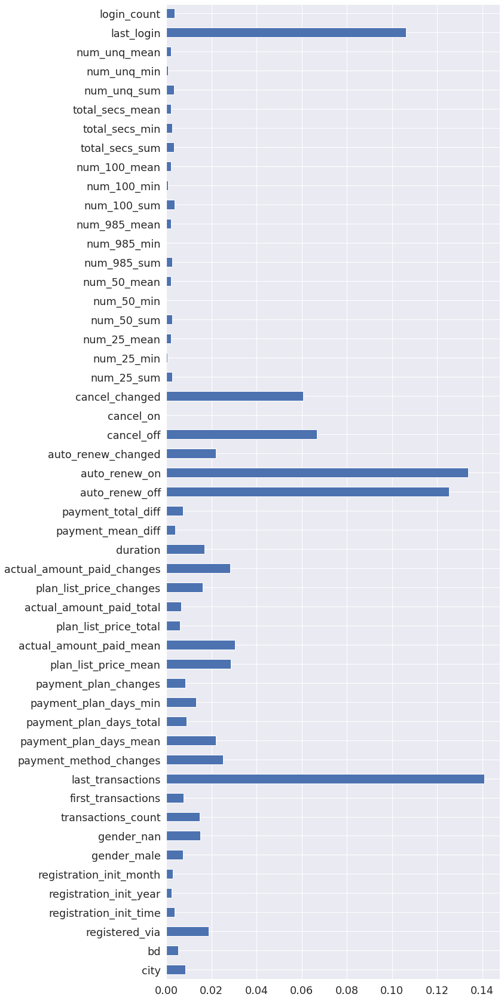

In [ ]:
feat_importances = pd.Series(rf_model_best.feature_importances_, index=X.columns)


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year         True
registration_init_month        True
gender_male                    True
gender_nan                     True
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total        True
payment_plan_days_min          True
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean        True
plan_list_price_total          True
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff              True
payment_total_diff             True
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_rf_drop = [

'cancel_on',                     

'num_25_min',                    

'num_50_min',                    

'num_985_min' ,                  

'num_100_min' ,                  

'num_unq_min',                   
              

                   
 ]


In [ ]:

df_kkbox6_rf = df_kkbox6.drop(labels = labels_rf_drop, axis=1)

In [ ]:
df_kkbox6_rf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86991 entries, 0 to 86990
Data columns (total 46 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   city                        86991 non-null  int64  
 1   bd                          86991 non-null  float64
 2   registered_via              86991 non-null  int64  
 3   registration_init_time      86991 non-null  int64  
 4   registration_init_year      86991 non-null  int64  
 5   registration_init_month     86991 non-null  int64  
 6   gender_male                 86991 non-null  int64  
 7   gender_nan                  86991 non-null  int64  
 8   transactions_count          86991 non-null  int64  
 9   first_transactions          86991 non-null  int64  
 10  last_transactions           86991 non-null  int64  
 11  payment_method_changes      86991 non-null  int64  
 12  payment_plan_days_mean      86991 non-null  float64
 13  payment_plan_days_total     869

In [ ]:
#df_kkbox6_rf.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox6_rf.csv', index = False)

In [ ]:
df_kkbox6_rf = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox6_rf.csv')

In [ ]:
df_kkbox6_rf.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,num_25_sum,num_25_mean,num_50_sum,num_50_mean,num_985_sum,num_985_mean,num_100_sum,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_mean,last_login,login_count,is_churn
0,13,29.0,9,20060406,2006,4,0,0,11,20150815,20170109,1,30.000000,330,30,1,160.909091,160.909091,1770,1770,2,2,513,0.000000,0,1,0,0,1,0,432,1.870130,56,0.242424,42,0.181818,12892,55.809524,2873030.886,71.007,12437.363143,9261,40.090909,20170209,231,1
1,13,26.0,9,20081105,2008,11,1,0,25,20150110,20170118,2,30.000000,750,30,1,149.000000,149.000000,3725,3725,1,1,739,0.000000,0,0,0,1,0,1,12117,16.091633,2867,3.807437,3184,4.228420,32896,43.686587,9451551.376,35.145,12551.861057,30892,41.025232,20170217,753,1
2,22,37.0,9,20090105,2009,1,0,0,24,20150316,20170217,1,30.125000,723,30,2,149.000000,142.791667,3576,3427,1,2,704,6.208333,149,0,1,0,0,1,234,0.426230,114,0.207650,121,0.220401,6777,12.344262,1706969.350,36.284,3109.233789,6965,12.686703,20170124,549,1
3,22,33.0,7,20100421,2010,4,0,0,9,20150113,20170114,1,63.333333,570,0,3,298.000000,314.555556,2682,2831,3,2,732,16.555556,149,1,0,0,1,0,2113,3.593537,706,1.200680,389,0.661565,21854,37.166667,5708495.744,0.392,9708.326095,20905,35.552721,20170214,588,1
4,1,27.0,7,20101205,2010,12,0,1,26,20150112,20160119,1,27.692308,720,0,2,137.538462,138.615385,3576,3604,2,2,372,1.076923,28,0,1,0,0,1,563,3.909722,113,0.784722,69,0.479167,4571,31.743056,1062897.421,10.671,7381.232090,2438,16.930556,20160124,144,1


In [ ]:
X = df_kkbox6_rf.iloc[:, :-1] 
y = df_kkbox6_rf['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 3987
Before OverSampling, counts of label '0': 56906 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (113812, 45)
After OverSampling, the shape of train_y: (113812,) 

After OverSampling, counts of label '1': 56906
After OverSampling, counts of label '0': 56906


In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
rf_model_feature = RandomForestClassifier()

params = {'n_estimators' : [100,200,500,1000,2000],
          'max_features' : ['auto', 'sqrt'],
          'max_depth' : [2,3,5,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'bootstrap' : [True, False]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_rf_feature = RandomizedSearchCV(rf_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_rf_feature.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   58.8s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.

/usr/local/lib/python3.7/dist-packages/joblib/externals/loky/process_executor.py:691: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  "timeout or by a memory leak.", UserWarning


[Parallel(n_jobs=-1)]: Done  35 tasks      | elapsed: 12.7min
[Parallel(n_jobs=-1)]: Done  36 tasks      | elapsed: 12.8min
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed: 13.0min
[Parallel(n_jobs=-1)]: Done  38 tasks      | elapsed: 13.4min
[Parallel(n_jobs=-1)]: Done  39 tasks      | elapsed: 13.5min
[Parallel(n_jobs=-1)]: Done  40 tasks      | elapsed: 13.8min
[Parallel(n_jobs=-1)]: Done  41 tasks      | elapsed: 14.2min
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed: 14.3min
[Parallel(n_jobs=-1)]: Done  43 tasks      | elapsed: 14.7min
[Parallel(n_jobs=-1)]: Done  45 out of  50 | elapsed: 19.1min remaining:  2.1min
[Parallel(n_jobs=-1)]: Done  47 out of  50 | elapsed: 22.9min remaining:  1.5min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed: 28.6min finished


RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
random_rf_feature.best_params_

{'bootstrap': True,
 'max_depth': 15,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 1000}

In [ ]:
random_rf_feature.best_score_

0.9734829025206784

In [ ]:
rf_feature_model_best = RandomForestClassifier(n_estimators= 1000,
                                       min_samples_split= 2,
                                       min_samples_leaf= 1,
                                       max_features= 'sqrt',
                                       max_depth= 15,
                                       bootstrap= True)

In [ ]:
rf_feature_model_best.fit(X_train_res, y_train_res)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=15, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=1000,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf_feature_model_best_probs = rf_feature_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, rf_feature_model_best_probs))

0.10157651260396135


In [ ]:
y_pred = rf_feature_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98     24386
           1       0.69      0.72      0.70      1712

    accuracy                           0.96     26098
   macro avg       0.84      0.85      0.84     26098
weighted avg       0.96      0.96      0.96     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[23834,   552],
       [  483,  1229]])

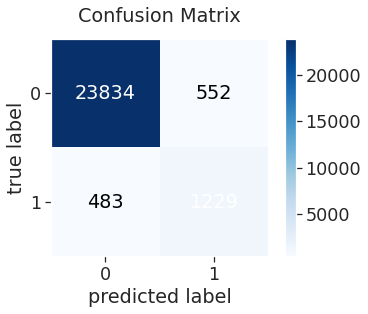

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

## GradientBoostingClassifier

### Preparação

In [ ]:
df_kkbox6 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_sample1 10%.csv')

In [ ]:
#df_kkbox6 = pd.read_csv('kkbox5_sample1 10%.csv')

In [ ]:
X = df_kkbox6.iloc[:, :-1] 
y = df_kkbox6['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

### Balancing data Using SMOTE

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 3987
Before OverSampling, counts of label '0': 56906 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (113812, 51)
After OverSampling, the shape of train_y: (113812,) 

After OverSampling, counts of label '1': 56906
After OverSampling, counts of label '0': 56906


### Padronização

In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
gb_model = GradientBoostingClassifier() 

params = {'max_depth':[2,3,5,7,10,15],
          'min_samples_split':[2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'learning_rate' : [0.02,0.05,0.07]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_gb = RandomizedSearchCV(gb_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_gb.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  4.9min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  5.0min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  5.0min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  5.8min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  6.9min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  7.0min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  9.8min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 10.5min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 11.6min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed: 11.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                        criterion='friedman_mse',
                                                        init=None,
                                                        learning_rate=0.1,
                                                        loss='deviance',
                                                        max_depth=3,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                 

In [ ]:
random_gb.best_params_

{'learning_rate': 0.05,
 'max_depth': 7,
 'min_samples_leaf': 2,
 'min_samples_split': 5}

In [ ]:
random_gb.best_score_

0.9707328067274116

### Testando log-loss do melhor parametro

In [ ]:
gb_model_best = GradientBoostingClassifier(min_samples_split= 5,
                                           min_samples_leaf= 2,
                                           max_depth= 7,
                                           learning_rate= 0.05) 

In [ ]:
gb_model_best.fit(X_train_res, y_train_res)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.05, loss='deviance', max_depth=7,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=2, min_samples_split=5,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [ ]:
gb_model_best_probs = gb_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, gb_model_best_probs))

0.10377059317432626


In [ ]:
y_pred = gb_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98     24386
           1       0.69      0.71      0.70      1712

    accuracy                           0.96     26098
   macro avg       0.83      0.84      0.84     26098
weighted avg       0.96      0.96      0.96     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[23837,   549],
       [  493,  1219]])

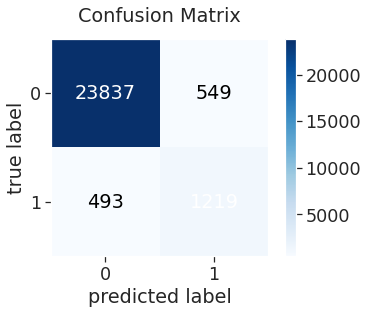

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox5_sample10.columns,gb_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.0010902543857921833
bd:0.0008377375112388098
registered_via:0.005118810569452003
registration_init_time:0.0011863140853672228
registration_init_year:0.0004051030202333545
registration_init_month:0.0009728163731119675
gender_male:0.002466154110887308
gender_nan:0.0019053026811712236
transactions_count:0.0019401767862185651
first_transactions:0.0018928956831362749
last_transactions:0.17130201497493389
payment_method_changes:0.0057491099063478645
payment_plan_days_mean:0.001265334843698487
payment_plan_days_total:0.0006952568474527713
payment_plan_days_min:0.001158345025674226
payment_plan_changes:0.0019139289751353432
plan_list_price_mean:0.0018306935960960774
actual_amount_paid_mean:0.0009456078524134309
plan_list_price_total:0.0005679360662528167
actual_amount_paid_total:0.0019120829752565975
plan_list_price_changes:0.003203249071531551
actual_amount_paid_changes:0.02113812535931667
duration:0.0036404993273626124
payment_mean_diff:0.0004216875884046514
payment_total_diff:0.00046

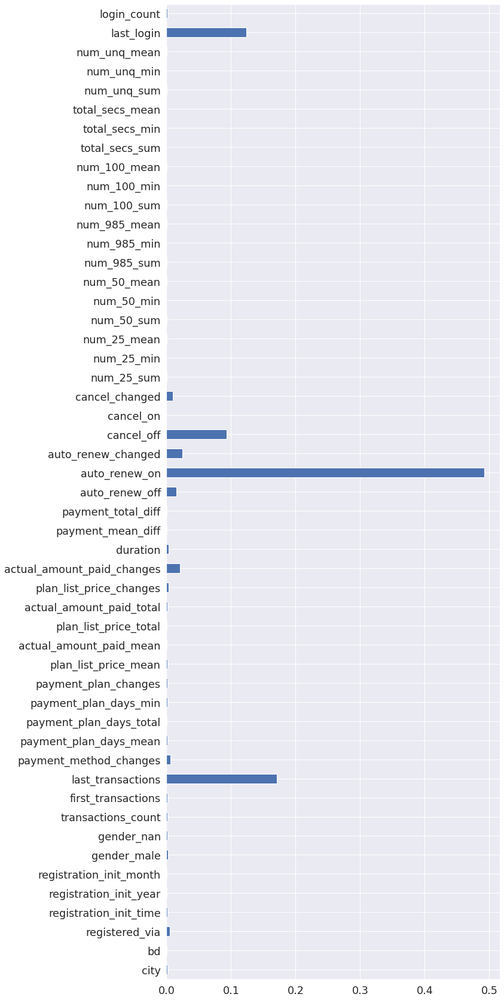

In [ ]:
feat_importances = pd.Series(gb_model_best.feature_importances_, index=X.columns)

sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                            False
registered_via                 True
registration_init_time         True
registration_init_year        False
registration_init_month       False
gender_male                    True
gender_nan                     True
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total       False
payment_plan_days_min          True
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean       False
plan_list_price_total         False
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff             False
payment_total_diff            False
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_gb_drop = [


'bd'    ,                        

'registration_init_year'   ,     
'registration_init_month'  ,     

'payment_plan_days_total'  ,     

'actual_amount_paid_mean'   ,    
'plan_list_price_total'     ,    

'payment_mean_diff'  ,           
'payment_total_diff' ,           


'cancel_on'      ,               

'num_25_sum'     ,               
'num_25_min'     ,               
'num_25_mean'    ,               
'num_50_sum'     ,               
'num_50_min'      ,              
'num_50_mean'    ,               
'num_985_sum'      ,             
'num_985_min'    ,               
'num_985_mean'     ,             
'num_100_sum'    ,               
'num_100_min'      ,             
'num_100_mean'    ,              
'total_secs_sum'      ,          
'total_secs_min'     ,           
'total_secs_mean'     ,          
'num_unq_sum'        ,           
'num_unq_min'        ,           
'num_unq_mean'               


                   
 ]


In [ ]:

df_kkbox6_gb = df_kkbox6.drop(labels = labels_gb_drop, axis=1)

In [ ]:
df_kkbox6_gb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86991 entries, 0 to 86990
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   city                        86991 non-null  int64  
 1   registered_via              86991 non-null  int64  
 2   registration_init_time      86991 non-null  int64  
 3   gender_male                 86991 non-null  int64  
 4   gender_nan                  86991 non-null  int64  
 5   transactions_count          86991 non-null  int64  
 6   first_transactions          86991 non-null  int64  
 7   last_transactions           86991 non-null  int64  
 8   payment_method_changes      86991 non-null  int64  
 9   payment_plan_days_mean      86991 non-null  float64
 10  payment_plan_days_min       86991 non-null  int64  
 11  payment_plan_changes        86991 non-null  int64  
 12  plan_list_price_mean        86991 non-null  float64
 13  actual_amount_paid_total    869

In [ ]:
#df_kkbox6_gb.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox6_gb.csv', index = False)

In [ ]:
df_kkbox6_gb = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox6_gb.csv')

In [ ]:
df_kkbox6_gb.head()

,city,registered_via,registration_init_time,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,last_login,login_count,is_churn
0,13,9,20060406,0,0,11,20150815,20170109,1,30.000000,30,1,160.909091,1770,2,2,513,1,0,0,1,0,20170209,231,1
1,13,9,20081105,1,0,25,20150110,20170118,2,30.000000,30,1,149.000000,3725,1,1,739,0,0,1,0,1,20170217,753,1
2,22,9,20090105,0,0,24,20150316,20170217,1,30.125000,30,2,149.000000,3427,1,2,704,0,1,0,0,1,20170124,549,1
3,22,7,20100421,0,0,9,20150113,20170114,1,63.333333,0,3,298.000000,2831,3,2,732,1,0,0,1,0,20170214,588,1
4,1,7,20101205,0,1,26,20150112,20160119,1,27.692308,0,2,137.538462,3604,2,2,372,0,1,0,0,1,20160124,144,1


In [ ]:
X = df_kkbox6_gb.iloc[:, :-1] 
y = df_kkbox6_gb['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 3987
Before OverSampling, counts of label '0': 56906 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (113812, 24)
After OverSampling, the shape of train_y: (113812,) 

After OverSampling, counts of label '1': 56906
After OverSampling, counts of label '0': 56906


In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
gb_model_feature = GradientBoostingClassifier() 

params = {'max_depth':[2,3,5,7,10,15],
          'min_samples_split':[2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'learning_rate' : [0.02,0.05,0.07]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_gb_feature = RandomizedSearchCV(gb_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_gb_feature.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  4.5min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  4.5min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  4.6min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  5.7min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  7.7min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  7.8min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  7.8min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  8.8min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  9.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                        criterion='friedman_mse',
                                                        init=None,
                                                        learning_rate=0.1,
                                                        loss='deviance',
                                                        max_depth=3,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                 

In [ ]:
random_gb_feature.best_params_

{'learning_rate': 0.05,
 'max_depth': 10,
 'min_samples_leaf': 3,
 'min_samples_split': 5}

In [ ]:
random_gb_feature.best_score_

0.973272055236119

In [ ]:
gb_feature_model_best = GradientBoostingClassifier(min_samples_split= 5,
                                           min_samples_leaf= 3,
                                           max_depth= 10,
                                           learning_rate= 0.05) 

In [ ]:
gb_feature_model_best.fit(X_train_res, y_train_res)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.05, loss='deviance', max_depth=10,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=3, min_samples_split=5,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [ ]:
gb_feature_model_best_probs = gb_feature_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, gb_feature_model_best_probs))

0.10203516702813999


In [ ]:
y_pred = gb_feature_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98     24386
           1       0.70      0.70      0.70      1712

    accuracy                           0.96     26098
   macro avg       0.84      0.84      0.84     26098
weighted avg       0.96      0.96      0.96     26098



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[23865,   521],
       [  522,  1190]])

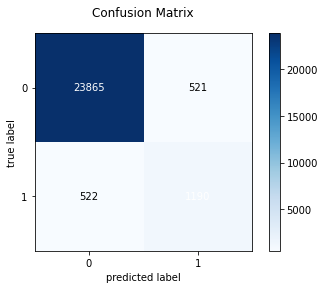

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

# Base Completa

In [ ]:
df_kkbox5 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5.csv')

In [ ]:
df_kkbox5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 869900 entries, 0 to 869899
Data columns (total 52 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   city                        869900 non-null  int64  
 1   bd                          869900 non-null  float64
 2   registered_via              869900 non-null  int64  
 3   registration_init_time      869900 non-null  int64  
 4   registration_init_year      869900 non-null  int64  
 5   registration_init_month     869900 non-null  int64  
 6   gender_male                 869900 non-null  int64  
 7   gender_nan                  869900 non-null  int64  
 8   transactions_count          869900 non-null  int64  
 9   first_transactions          869900 non-null  int64  
 10  last_transactions           869900 non-null  int64  
 11  payment_method_changes      869900 non-null  int64  
 12  payment_plan_days_mean      869900 non-null  float64
 13  payment_plan_d

In [ ]:
df_kkbox5.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,18,36.0,9,20050406,2005,4,0,0,2,20161031,20170107,1,18.500000,37,7,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,0,51,0,1.961538,16,0,0.615385,11,0,0.423077,409,0,15.730769,1.080519e+05,237.205,4155.840538,462,2,17.769231,20170208,26,1
1,10,38.0,9,20050407,2005,4,1,0,23,20150131,20170224,2,28.826087,663,0,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,0,1,447,0,0.857965,157,0,0.301344,178,0,0.341651,9942,0,19.082534,2.615312e+06,1.533,5019.792971,7232,1,13.880998,20170215,521,1
2,11,27.0,9,20051016,2005,10,0,0,10,20160202,20170112,2,30.000000,300,30,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,0,1,1570,0,6.624473,950,0,4.008439,479,0,2.021097,10033,0,42.333333,2.597385e+06,160.104,10959.428928,11533,1,48.662447,20170131,237,1
3,13,23.0,9,20051102,2005,11,0,0,2,20160104,20160106,2,410.000000,820,410,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,0,7265,0,9.884354,2420,0,3.292517,1634,0,2.223129,18070,0,24.585034,4.945309e+06,2.847,6728.311370,18479,1,25.141497,20170221,735,1
4,3,27.0,9,20051228,2005,12,1,0,8,20150102,20170128,1,98.125000,785,30,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,0,1389,0,1.832454,714,0,0.941953,3228,0,4.258575,68731,0,90.674142,1.864415e+07,233.000,24596.500005,72674,1,95.875989,20170228,758,1


## Separação dos dados

In [ ]:
X = df_kkbox5.iloc[:, :-1] 
y = df_kkbox5['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

## Padronização

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

## Analise exploratória de diferentes modelos

In [ ]:
classifiers = [
    KNeighborsClassifier(),
    GaussianNB(),
    LogisticRegression(dual = False, max_iter = 500000),
    SVC(),
    DecisionTreeClassifier(),
    RandomForestClassifier(),
    GradientBoostingClassifier()
]

for clf in classifiers:

    clf.fit(X_train, y_train)
    # armazenando o nome do modelo na variável name
    name = clf.__class__.__name__
    # imprimindo o nome do modelo
    print("=" * 30)
    print(name)
    # imprimindo os resultados do modelo
    print('****Results****')
    y_pred = clf.predict(X_test)
    print("Accuracy:", metrics.accuracy_score(y_test, 
                                              y_pred
                                             )
         )
    print("Precision:", metrics.precision_score(y_test, 
                                                y_pred
                                               )
         )
    print("Recall:", metrics.recall_score(y_test, 
                                          y_pred
                                         )
         )



KNeighborsClassifier
****Results****
Accuracy: 0.9413993945664253
Precision: 0.5734008283479061
Recall: 0.3689009947891994
GaussianNB
****Results****
Accuracy: 0.9220025290263248
Precision: 0.38410108979073343
Recall: 0.34018237801989576
LogisticRegression
****Results****
Accuracy: 0.9417212706441354
Precision: 0.6376455156583046
Recall: 0.23028185693983894
SVC
****Results****
Accuracy: 0.9465992259646703
Precision: 0.685427135678392
Recall: 0.3230696352439602
DecisionTreeClassifier
****Results****
Accuracy: 0.9500134115032379
Precision: 0.6093438798156262
Recall: 0.6340596873519659
RandomForestClassifier
****Results****
Accuracy: 0.9662566578533931
Precision: 0.8035150968904912
Recall: 0.6334675509237329
GradientBoostingClassifier
****Results****
Accuracy: 0.9632256581216232
Precision: 0.7882046011542414
Recall: 0.5903600189483657


## Hyperparameter tuning with GridSearchCV and RandomizedSearchCV


## DecisionTreeClassifier

In [ ]:
dtc_model = DecisionTreeClassifier() 

params = {'max_depth' : [2,3,5,7,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'criterion' : ['gini', 'entropy'],
          'splitter' : ['best', 'random']}


In [ ]:
random_dtc = RandomizedSearchCV(dtc_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_dtc.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   10.8s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   14.6s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   22.8s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:   22.9s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:   26.5s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:   2

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=None,
       

In [ ]:
random_dtc.best_params_

{'criterion': 'gini',
 'max_depth': 15,
 'min_samples_leaf': 3,
 'min_samples_split': 10,
 'splitter': 'best'}

In [ ]:
random_dtc.best_score_

0.9602203865797382

### Testando log-loss do melhor parametro

In [ ]:
dtc_model_best = DecisionTreeClassifier(splitter= 'best',
                                   min_samples_split= 10,
                                   min_samples_leaf= 3,
                                   max_depth= 15,
                                   criterion= 'gini') 


In [ ]:
dtc_model_best.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=15, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=10,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dtc_model_best_probs = dtc_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, dtc_model_best_probs))

0.31964837788948797


In [ ]:
y_pred = dtc_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98    244082
           1       0.76      0.61      0.67     16888

    accuracy                           0.96    260970
   macro avg       0.87      0.80      0.83    260970
weighted avg       0.96      0.96      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[240798,   3284],
       [  6617,  10271]])

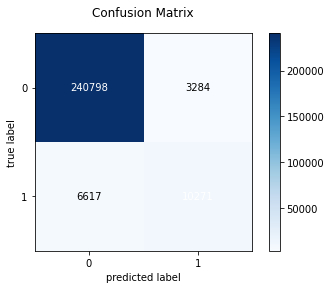

In [ ]:
fig, ax = plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox5.columns,dtc_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.004195254245838872
bd:0.004573205204862009
registered_via:0.003633043308658051
registration_init_time:0.008553186067693692
registration_init_year:0.000567019688397478
registration_init_month:0.003457822970383232
gender_male:0.0007281245638609983
gender_nan:0.0005063598143969993
transactions_count:0.01218924657653811
first_transactions:0.014128546979096318
last_transactions:0.44411381713425296
payment_method_changes:0.014148697675270676
payment_plan_days_mean:0.004648982091887146
payment_plan_days_total:0.015096468476804388
payment_plan_days_min:0.0002361580110572545
payment_plan_changes:0.0015721309968987588
plan_list_price_mean:0.01856433490700477
actual_amount_paid_mean:0.0048360478329469575
plan_list_price_total:0.006407633693588807
actual_amount_paid_total:0.009895137345889147
plan_list_price_changes:0.0017913570289761062
actual_amount_paid_changes:0.04459355525772432
duration:0.027308928182643223
payment_mean_diff:0.0028338419647494285
payment_total_diff:0.00186726635477892

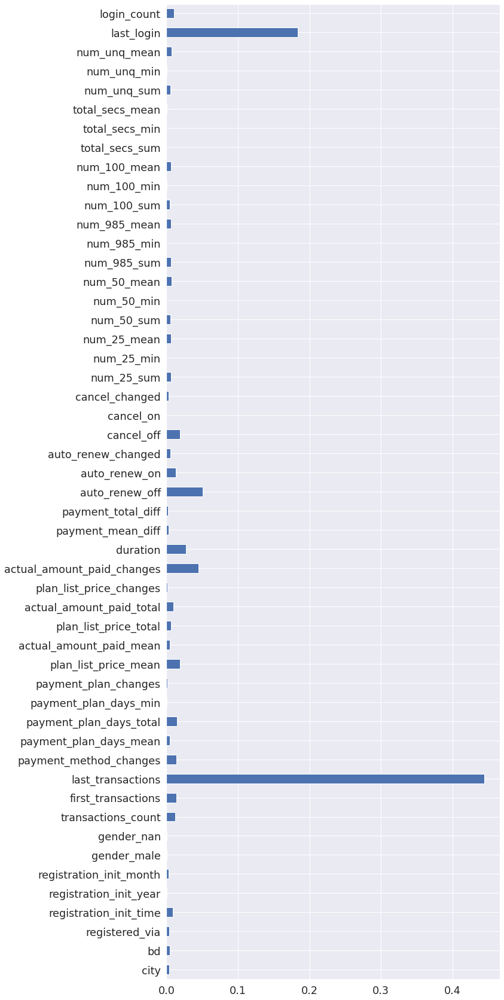

In [ ]:
feat_importances = pd.Series(dtc_model_best.feature_importances_, index=X.columns)


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year        False
registration_init_month        True
gender_male                   False
gender_nan                    False
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total        True
payment_plan_days_min         False
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean        True
plan_list_price_total          True
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff              True
payment_total_diff             True
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_dtc_drop = [


'registration_init_year'        ,

'gender_male'                   ,
'gender_nan'                    ,

'payment_plan_days_min'         ,

'cancel_on'                   ,  

'num_25_min'   ,                 

'num_50_min'  ,                  

'num_985_min' ,                  

'num_100_min'  ,                 

'total_secs_sum' ,               
'total_secs_min'  ,              
'total_secs_mean' ,              

'num_unq_min'                   

                   
 ]


In [ ]:

df_kkbox5_dtc_full = df_kkbox5.drop(labels = labels_dtc_drop, axis=1)

In [ ]:
df_kkbox5_dtc_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 869900 entries, 0 to 869899
Data columns (total 39 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   city                        869900 non-null  int64  
 1   bd                          869900 non-null  float64
 2   registered_via              869900 non-null  int64  
 3   registration_init_time      869900 non-null  int64  
 4   registration_init_month     869900 non-null  int64  
 5   transactions_count          869900 non-null  int64  
 6   first_transactions          869900 non-null  int64  
 7   last_transactions           869900 non-null  int64  
 8   payment_method_changes      869900 non-null  int64  
 9   payment_plan_days_mean      869900 non-null  float64
 10  payment_plan_days_total     869900 non-null  int64  
 11  payment_plan_changes        869900 non-null  int64  
 12  plan_list_price_mean        869900 non-null  float64
 13  actual_amount_

In [ ]:
#df_kkbox5_dtc_full.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_dtc_full.csv', index = False)

In [ ]:
df_kkbox5_dtc_full = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_dtc_full.csv')

In [ ]:
df_kkbox5_dtc_full.head()

,city,bd,registered_via,registration_init_time,registration_init_month,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,num_25_sum,num_25_mean,num_50_sum,num_50_mean,num_985_sum,num_985_mean,num_100_sum,num_100_mean,num_unq_sum,num_unq_mean,last_login,login_count,is_churn
0,18,36.0,9,20050406,4,2,20161031,20170107,1,18.500000,37,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,51,1.961538,16,0.615385,11,0.423077,409,15.730769,462,17.769231,20170208,26,1
1,10,38.0,9,20050407,4,23,20150131,20170224,2,28.826087,663,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,1,447,0.857965,157,0.301344,178,0.341651,9942,19.082534,7232,13.880998,20170215,521,1
2,11,27.0,9,20051016,10,10,20160202,20170112,2,30.000000,300,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,1,1570,6.624473,950,4.008439,479,2.021097,10033,42.333333,11533,48.662447,20170131,237,1
3,13,23.0,9,20051102,11,2,20160104,20160106,2,410.000000,820,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,7265,9.884354,2420,3.292517,1634,2.223129,18070,24.585034,18479,25.141497,20170221,735,1
4,3,27.0,9,20051228,12,8,20150102,20170128,1,98.125000,785,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,1389,1.832454,714,0.941953,3228,4.258575,68731,90.674142,72674,95.875989,20170228,758,1


In [ ]:
X = df_kkbox5_dtc_full.iloc[:, :-1] 
y = df_kkbox5_dtc_full['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
dtc_model_full = DecisionTreeClassifier() 

params = {'max_depth' : [2,3,5,7,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'criterion' : ['gini', 'entropy'],
          'splitter' : ['best', 'random']}


In [ ]:
random_dtc_full = RandomizedSearchCV(dtc_model_full, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_dtc_full.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    9.0s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    9.1s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    9.1s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    9.2s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   16.2s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   16.2s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   16.9s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   23.0s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   23.1s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   29.5s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:   29.7s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:   36.0s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:   3

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=None,
       

In [ ]:
random_dtc_full.best_params_

{'criterion': 'gini',
 'max_depth': 10,
 'min_samples_leaf': 2,
 'min_samples_split': 5,
 'splitter': 'best'}

In [ ]:
random_dtc_full.best_score_

0.962486656922799

### Testando log-loss do melhor parametro

In [ ]:
dtc_model_full_best = DecisionTreeClassifier(splitter= 'best',
                                   min_samples_split= 5,
                                   min_samples_leaf= 2,
                                   max_depth= 10,
                                   criterion= 'gini') 


In [ ]:
dtc_model_full_best.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=10, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dtc_model_full_best_probs = dtc_model_full_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, dtc_model_full_best_probs))

0.11631471403636873


In [ ]:
y_pred = dtc_model_full_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98    244082
           1       0.78      0.61      0.69     16888

    accuracy                           0.96    260970
   macro avg       0.88      0.80      0.83    260970
weighted avg       0.96      0.96      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[241134,   2948],
       [  6508,  10380]])

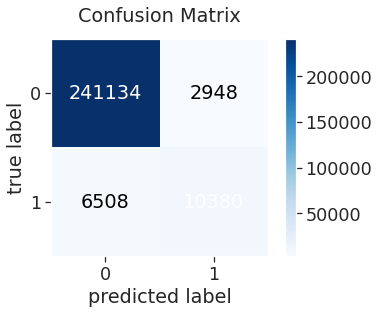

In [ ]:
fig, ax = plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

## RandomForestClassifier

In [ ]:
df_kkbox5 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5.csv')

In [ ]:
df_kkbox5.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,18,36.0,9,20050406,2005,4,0,0,2,20161031,20170107,1,18.500000,37,7,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,0,51,0,1.961538,16,0,0.615385,11,0,0.423077,409,0,15.730769,1.080519e+05,237.205,4155.840538,462,2,17.769231,20170208,26,1
1,10,38.0,9,20050407,2005,4,1,0,23,20150131,20170224,2,28.826087,663,0,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,0,1,447,0,0.857965,157,0,0.301344,178,0,0.341651,9942,0,19.082534,2.615312e+06,1.533,5019.792971,7232,1,13.880998,20170215,521,1
2,11,27.0,9,20051016,2005,10,0,0,10,20160202,20170112,2,30.000000,300,30,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,0,1,1570,0,6.624473,950,0,4.008439,479,0,2.021097,10033,0,42.333333,2.597385e+06,160.104,10959.428928,11533,1,48.662447,20170131,237,1
3,13,23.0,9,20051102,2005,11,0,0,2,20160104,20160106,2,410.000000,820,410,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,0,7265,0,9.884354,2420,0,3.292517,1634,0,2.223129,18070,0,24.585034,4.945309e+06,2.847,6728.311370,18479,1,25.141497,20170221,735,1
4,3,27.0,9,20051228,2005,12,1,0,8,20150102,20170128,1,98.125000,785,30,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,0,1389,0,1.832454,714,0,0.941953,3228,0,4.258575,68731,0,90.674142,1.864415e+07,233.000,24596.500005,72674,1,95.875989,20170228,758,1


## Separação dos dados

In [ ]:
X = df_kkbox5.iloc[:, :-1] 
y = df_kkbox5['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

## Padronização

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
rf_model = RandomForestClassifier()

params = {'n_estimators' : [100,200,500,1000,2000],
          'max_features' : ['auto', 'sqrt'],
          'max_depth' : [2,3,5,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'bootstrap' : [True, False]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_rf = RandomizedSearchCV(rf_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_rf.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed: 12.7min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed: 13.0min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed: 13.1min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed: 13.1min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 18.8min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed: 18.8min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed: 19.0min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed: 24.4min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed: 24.4min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 24.8min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 25.9min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 30.3min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 30.3min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed: 30.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
random_rf.best_params_

{'bootstrap': False,
 'max_depth': 10,
 'max_features': 'sqrt',
 'min_samples_leaf': 3,
 'min_samples_split': 7,
 'n_estimators': 100}

In [ ]:
random_rf.best_score_

0.9618839603895356

### Testando log-loss do melhor parametro

In [ ]:
rf_full_model_best = RandomForestClassifier(n_estimators= 100,
                                       min_samples_split= 7,
                                       min_samples_leaf= 3,
                                       max_features= 'sqrt',
                                       max_depth= 10,
                                       bootstrap= False)

In [ ]:
rf_full_model_best.fit(X_train, y_train)

RandomForestClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=10, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=7,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf_full_model_best_probs = rf_full_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, rf_full_model_best_probs))

0.09721650730775314


In [ ]:
y_pred = rf_full_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98    244082
           1       0.83      0.54      0.65     16888

    accuracy                           0.96    260970
   macro avg       0.90      0.77      0.82    260970
weighted avg       0.96      0.96      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[242165,   1917],
       [  7774,   9114]])

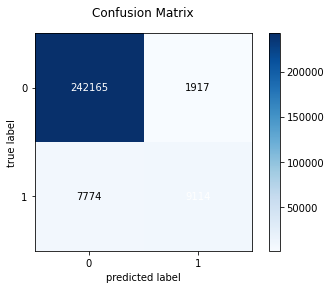

In [ ]:
fig, ax = plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox5.columns,rf_full_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.0023199809167593543
bd:0.0028346027963171098
registered_via:0.006309327325814466
registration_init_time:0.0032495472829669626
registration_init_year:0.00223788086066216
registration_init_month:0.0015647631662843453
gender_male:8.272569123537568e-05
gender_nan:0.0011504427829066271
transactions_count:0.03096235344441587
first_transactions:0.011439250501359988
last_transactions:0.26868596102265296
payment_method_changes:0.008571055957096244
payment_plan_days_mean:0.02691311186535409
payment_plan_days_total:0.01850537557322804
payment_plan_days_min:0.014513877494155492
payment_plan_changes:0.0033582148278992335
plan_list_price_mean:0.03014006370685743
actual_amount_paid_mean:0.02555070350647156
plan_list_price_total:0.023733717533294913
actual_amount_paid_total:0.021399846827303053
plan_list_price_changes:0.013770887823504933
actual_amount_paid_changes:0.01667884400922952
duration:0.051320057983482326
payment_mean_diff:0.004441722528085851
payment_total_diff:0.0023772986906376225
a

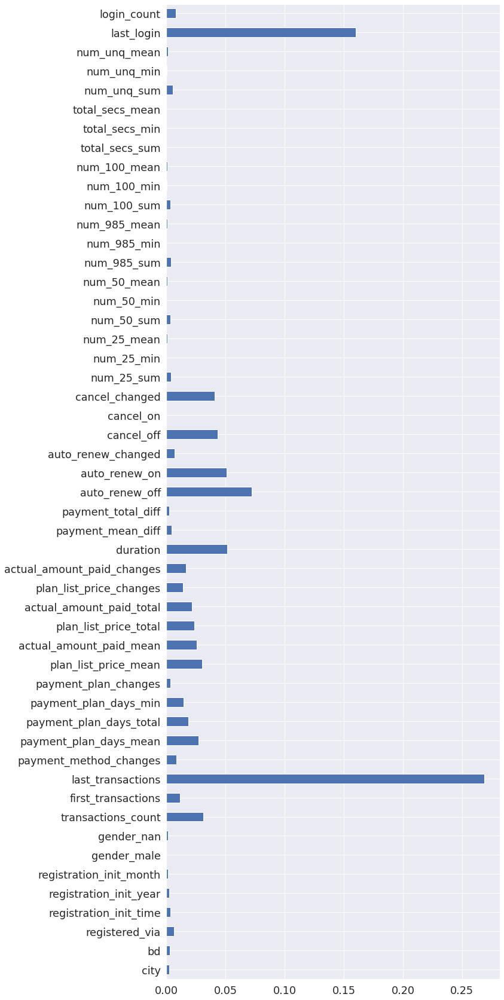

In [ ]:
feat_importances = pd.Series(rf_full_model_best.feature_importances_, index=X.columns)


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year         True
registration_init_month        True
gender_male                   False
gender_nan                     True
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total        True
payment_plan_days_min          True
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean        True
plan_list_price_total          True
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff              True
payment_total_diff             True
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_rf_drop = [


'gender_male'           ,        

'cancel_on'  ,                   

'num_25_min'  ,                  

'num_50_min'   ,                 
'num_50_mean'  ,                 

'num_985_min'  ,                 
'num_985_mean',                  

'num_100_min'  ,                 

'total_secs_sum' ,               
'total_secs_min'  ,              
'total_secs_mean'  ,             

'num_unq_min'                   
                   
 ]


In [ ]:

df_kkbox5_full_rf = df_kkbox5.drop(labels = labels_rf_drop, axis=1)

In [ ]:
df_kkbox5_full_rf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 869900 entries, 0 to 869899
Data columns (total 40 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   city                        869900 non-null  int64  
 1   bd                          869900 non-null  float64
 2   registered_via              869900 non-null  int64  
 3   registration_init_time      869900 non-null  int64  
 4   registration_init_year      869900 non-null  int64  
 5   registration_init_month     869900 non-null  int64  
 6   gender_nan                  869900 non-null  int64  
 7   transactions_count          869900 non-null  int64  
 8   first_transactions          869900 non-null  int64  
 9   last_transactions           869900 non-null  int64  
 10  payment_method_changes      869900 non-null  int64  
 11  payment_plan_days_mean      869900 non-null  float64
 12  payment_plan_days_total     869900 non-null  int64  
 13  payment_plan_d

In [ ]:
#df_kkbox5_full_rf.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_full_rf.csv', index = False)

In [ ]:
df_kkbox5_full_rf = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_full_rf.csv')

In [ ]:
df_kkbox5_full_rf.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,num_25_sum,num_25_mean,num_50_sum,num_985_sum,num_100_sum,num_100_mean,num_unq_sum,num_unq_mean,last_login,login_count,is_churn
0,18,36.0,9,20050406,2005,4,0,2,20161031,20170107,1,18.500000,37,7,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,51,1.961538,16,11,409,15.730769,462,17.769231,20170208,26,1
1,10,38.0,9,20050407,2005,4,0,23,20150131,20170224,2,28.826087,663,0,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,1,447,0.857965,157,178,9942,19.082534,7232,13.880998,20170215,521,1
2,11,27.0,9,20051016,2005,10,0,10,20160202,20170112,2,30.000000,300,30,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,1,1570,6.624473,950,479,10033,42.333333,11533,48.662447,20170131,237,1
3,13,23.0,9,20051102,2005,11,0,2,20160104,20160106,2,410.000000,820,410,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,7265,9.884354,2420,1634,18070,24.585034,18479,25.141497,20170221,735,1
4,3,27.0,9,20051228,2005,12,0,8,20150102,20170128,1,98.125000,785,30,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,1389,1.832454,714,3228,68731,90.674142,72674,95.875989,20170228,758,1


In [ ]:
X = df_kkbox5_full_rf.iloc[:, :-1] 
y = df_kkbox5_full_rf['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
rf_model_full_feature = RandomForestClassifier()

params = {'n_estimators' : [100,200,500,1000,2000],
          'max_features' : ['auto', 'sqrt'],
          'max_depth' : [2,3,5,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'bootstrap' : [True, False]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_rf_full_feature = RandomizedSearchCV(rf_model_full_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_rf_full_feature.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  5.6min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  5.6min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  5.7min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  5.7min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 11.2min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed: 12.6min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed: 12.6min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed: 12.7min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed: 16.2min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 16.2min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 18.2min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 19.7min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 19.7min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed: 19.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
random_rf_full_feature.best_params_

{'bootstrap': False,
 'max_depth': 15,
 'max_features': 'auto',
 'min_samples_leaf': 2,
 'min_samples_split': 5,
 'n_estimators': 100}

In [ ]:
random_rf_full_feature.best_score_

0.9655904619578607

In [ ]:
rf_feature_full_model_best = RandomForestClassifier(n_estimators= 100,
                                       min_samples_split= 5,
                                       min_samples_leaf= 2,
                                       max_features= 'auto',
                                       max_depth= 15,
                                       bootstrap= False)

In [ ]:
rf_feature_full_model_best.fit(X_train, y_train)

RandomForestClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=15, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf_feature_full_model_best_probs = rf_feature_full_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, rf_feature_full_model_best_probs))

0.08673209061241625


In [ ]:
y_pred = rf_feature_full_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98    244082
           1       0.82      0.62      0.71     16888

    accuracy                           0.97    260970
   macro avg       0.90      0.81      0.84    260970
weighted avg       0.96      0.97      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[241746,   2336],
       [  6417,  10471]])

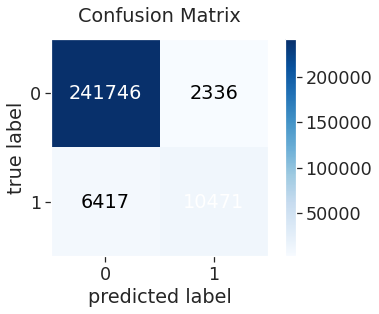

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

## GradientBoostingClassifier

In [ ]:
df_kkbox5 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5.csv')

In [ ]:
df_kkbox5.head()

,city,bd,registered_via,registration_init_time,registration_init_year,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_on,cancel_changed,num_25_sum,num_25_min,num_25_mean,num_50_sum,num_50_min,num_50_mean,num_985_sum,num_985_min,num_985_mean,num_100_sum,num_100_min,num_100_mean,total_secs_sum,total_secs_min,total_secs_mean,num_unq_sum,num_unq_min,num_unq_mean,last_login,login_count,is_churn
0,18,36.0,9,20050406,2005,4,0,0,2,20161031,20170107,1,18.500000,37,7,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,0,51,0,1.961538,16,0,0.615385,11,0,0.423077,409,0,15.730769,1.080519e+05,237.205,4155.840538,462,2,17.769231,20170208,26,1
1,10,38.0,9,20050407,2005,4,1,0,23,20150131,20170224,2,28.826087,663,0,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,0,1,447,0,0.857965,157,0,0.301344,178,0,0.341651,9942,0,19.082534,2.615312e+06,1.533,5019.792971,7232,1,13.880998,20170215,521,1
2,11,27.0,9,20051016,2005,10,0,0,10,20160202,20170112,2,30.000000,300,30,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,0,1,1570,0,6.624473,950,0,4.008439,479,0,2.021097,10033,0,42.333333,2.597385e+06,160.104,10959.428928,11533,1,48.662447,20170131,237,1
3,13,23.0,9,20051102,2005,11,0,0,2,20160104,20160106,2,410.000000,820,410,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,0,7265,0,9.884354,2420,0,3.292517,1634,0,2.223129,18070,0,24.585034,4.945309e+06,2.847,6728.311370,18479,1,25.141497,20170221,735,1
4,3,27.0,9,20051228,2005,12,1,0,8,20150102,20170128,1,98.125000,785,30,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,0,1389,0,1.832454,714,0,0.941953,3228,0,4.258575,68731,0,90.674142,1.864415e+07,233.000,24596.500005,72674,1,95.875989,20170228,758,1


## Separação dos dados

In [ ]:
X = df_kkbox5.iloc[:, :-1] 
y = df_kkbox5['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

## Padronização

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
gb_model = GradientBoostingClassifier() 

params = {'max_depth':[2,3,5,7,10,15],
          'min_samples_split':[2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'learning_rate' : [0.02,0.05,0.07]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_gb = RandomizedSearchCV(gb_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_gb.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed: 28.7min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed: 28.9min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed: 29.1min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed: 29.3min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 41.7min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed: 41.8min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed: 42.1min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed: 50.7min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed: 54.6min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 54.7min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 56.9min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 59.3min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 63.3min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed: 63.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                        criterion='friedman_mse',
                                                        init=None,
                                                        learning_rate=0.1,
                                                        loss='deviance',
                                                        max_depth=3,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                 

In [ ]:
random_gb.best_params_

{'learning_rate': 0.07,
 'max_depth': 10,
 'min_samples_leaf': 3,
 'min_samples_split': 5}

In [ ]:
random_gb.best_score_

0.9657957400686451

### Testando log-loss do melhor parametro

In [ ]:
gb_model_best = GradientBoostingClassifier(min_samples_split= 5,
                                           min_samples_leaf= 3,
                                           max_depth= 10,
                                           learning_rate= 0.07) 

In [ ]:
gb_model_best.fit(X_train, y_train)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.07, loss='deviance', max_depth=10,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=3, min_samples_split=5,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [ ]:
gb_model_best_probs = gb_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, gb_model_best_probs))

0.08415962287067279


In [ ]:
y_pred = gb_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.99      0.98    244082
           1       0.79      0.66      0.72     16888

    accuracy                           0.97    260970
   macro avg       0.88      0.82      0.85    260970
weighted avg       0.96      0.97      0.97    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[241183,   2899],
       [  5783,  11105]])

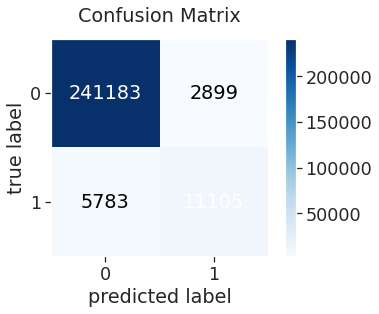

In [ ]:
fig, ax = plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox5.columns,gb_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.004691343938439116
bd:0.005658397870038908
registered_via:0.0033944094253799697
registration_init_time:0.01052642191743206
registration_init_year:0.0005757270691542376
registration_init_month:0.0035098056042145937
gender_male:0.0006079598984573908
gender_nan:0.0006039295719980071
transactions_count:0.010066637883005788
first_transactions:0.011849184034597638
last_transactions:0.44045501853287256
payment_method_changes:0.013570072933213396
payment_plan_days_mean:0.007392444652693792
payment_plan_days_total:0.0142195375087419
payment_plan_days_min:0.0008940907837023069
payment_plan_changes:0.0017909068536021747
plan_list_price_mean:0.018681629449120243
actual_amount_paid_mean:0.006729467677723401
plan_list_price_total:0.008511588997708094
actual_amount_paid_total:0.009709384150485353
plan_list_price_changes:0.008900220278692274
actual_amount_paid_changes:0.03803455014608107
duration:0.026865686440672228
payment_mean_diff:0.002814199730793599
payment_total_diff:0.001946075377207666

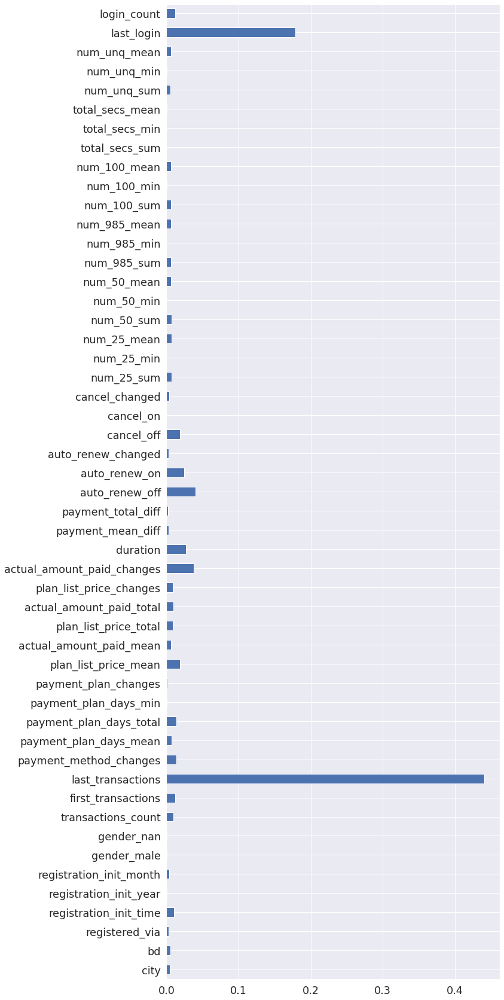

In [ ]:
feat_importances = pd.Series(gb_model_best.feature_importances_, index=X.columns)

sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year        False
registration_init_month        True
gender_male                   False
gender_nan                    False
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total        True
payment_plan_days_min         False
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean        True
plan_list_price_total          True
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff              True
payment_total_diff             True
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_gb_drop = [


'registration_init_year'       , 

'gender_male'                ,   
'gender_nan'                ,    

'payment_plan_days_min'     ,    

'cancel_on'                ,     

'num_25_min'              ,      

'num_50_min'             ,       

'num_985_min'          ,         

'num_100_min'        ,           

'total_secs_sum'    ,            
'total_secs_min'   ,             
'total_secs_mean'  ,             

'num_unq_min'                   
                   
 ]


In [ ]:

df_kkbox5_full_gb = df_kkbox5.drop(labels = labels_gb_drop, axis=1)

In [ ]:
df_kkbox5_full_gb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 869900 entries, 0 to 869899
Data columns (total 39 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   city                        869900 non-null  int64  
 1   bd                          869900 non-null  float64
 2   registered_via              869900 non-null  int64  
 3   registration_init_time      869900 non-null  int64  
 4   registration_init_month     869900 non-null  int64  
 5   transactions_count          869900 non-null  int64  
 6   first_transactions          869900 non-null  int64  
 7   last_transactions           869900 non-null  int64  
 8   payment_method_changes      869900 non-null  int64  
 9   payment_plan_days_mean      869900 non-null  float64
 10  payment_plan_days_total     869900 non-null  int64  
 11  payment_plan_changes        869900 non-null  int64  
 12  plan_list_price_mean        869900 non-null  float64
 13  actual_amount_

In [ ]:
#df_kkbox5_full_gb.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_full_gb.csv', index = False)

In [ ]:
df_kkbox5_full_gb = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5_full_gb.csv')

In [ ]:
df_kkbox5_full_gb.head()

,city,bd,registered_via,registration_init_time,registration_init_month,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,num_25_sum,num_25_mean,num_50_sum,num_50_mean,num_985_sum,num_985_mean,num_100_sum,num_100_mean,num_unq_sum,num_unq_mean,last_login,login_count,is_churn
0,18,36.0,9,20050406,4,2,20161031,20170107,1,18.500000,37,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,51,1.961538,16,0.615385,11,0.423077,409,15.730769,462,17.769231,20170208,26,1
1,10,38.0,9,20050407,4,23,20150131,20170224,2,28.826087,663,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,1,447,0.857965,157,0.301344,178,0.341651,9942,19.082534,7232,13.880998,20170215,521,1
2,11,27.0,9,20051016,10,10,20160202,20170112,2,30.000000,300,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,1,1570,6.624473,950,4.008439,479,2.021097,10033,42.333333,11533,48.662447,20170131,237,1
3,13,23.0,9,20051102,11,2,20160104,20160106,2,410.000000,820,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,7265,9.884354,2420,3.292517,1634,2.223129,18070,24.585034,18479,25.141497,20170221,735,1
4,3,27.0,9,20051228,12,8,20150102,20170128,1,98.125000,785,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,1389,1.832454,714,0.941953,3228,4.258575,68731,90.674142,72674,95.875989,20170228,758,1


In [ ]:
X = df_kkbox5_full_gb.iloc[:, :-1] 
y = df_kkbox5_full_gb['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
gb_full_model_feature = GradientBoostingClassifier() 

params = {'max_depth':[2,3,5,7,10,15],
          'min_samples_split':[2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'learning_rate' : [0.02,0.05,0.07]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_full_gb_feature = RandomizedSearchCV(gb_full_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_full_gb_feature.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed: 56.7min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed: 57.2min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed: 57.3min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed: 58.2min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 83.5min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed: 83.7min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed: 84.5min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed: 108.4min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed: 108.6min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 111.4min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 136.4min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 159.1min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 159.5min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapse

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                        criterion='friedman_mse',
                                                        init=None,
                                                        learning_rate=0.1,
                                                        loss='deviance',
                                                        max_depth=3,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                 

In [ ]:
random_full_gb_feature.best_params_

{'learning_rate': 0.05,
 'max_depth': 15,
 'min_samples_leaf': 2,
 'min_samples_split': 3}

In [ ]:
random_full_gb_feature.best_score_

0.9650222521472089

In [ ]:
gb_feature_full_model_best = GradientBoostingClassifier(min_samples_split= 3,
                                           min_samples_leaf= 2,
                                           max_depth= 15,
                                           learning_rate= 0.05) 

In [ ]:
gb_feature_full_model_best.fit(X_train, y_train)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.05, loss='deviance', max_depth=15,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=2, min_samples_split=3,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [ ]:
gb_feature_full_model_best_probs = gb_feature_full_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, gb_feature_full_model_best_probs))

0.08895292232666976


In [ ]:
y_pred = gb_feature_full_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.99      0.98    244082
           1       0.79      0.65      0.71     16888

    accuracy                           0.97    260970
   macro avg       0.88      0.82      0.85    260970
weighted avg       0.96      0.97      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[241123,   2959],
       [  5850,  11038]])

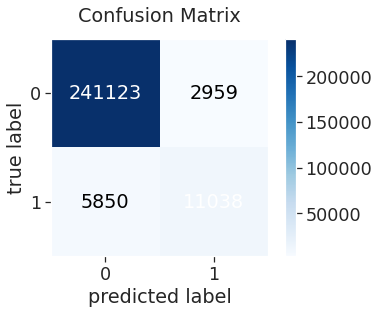

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

# Balanceamento de dados com SMOTE (Base Completa)

## Hyperparameter tuning with GridSearchCV and RandomizedSearchCV


## DecisionTreeClassifier

### Preparação

In [ ]:
df_kkbox7 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5.csv')

In [ ]:
#df_kkbox7 = pd.read_csv('kkbox5.csv')

In [ ]:
X = df_kkbox7.iloc[:, :-1] 
y = df_kkbox7['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

### Balancing data Using SMOTE

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 40258
Before OverSampling, counts of label '0': 568672 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (1137344, 51)
After OverSampling, the shape of train_y: (1137344,) 

After OverSampling, counts of label '1': 568672
After OverSampling, counts of label '0': 568672


### Padronização

In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
dtc_model = DecisionTreeClassifier() 

params = {'max_depth' : [2,3,5,7,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'criterion' : ['gini', 'entropy'],
          'splitter' : ['best', 'random']}


In [ ]:
random_dtc = RandomizedSearchCV(dtc_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_dtc.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   20.9s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   21.0s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   21.1s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   21.9s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   29.6s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   30.5s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   31.8s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   38.1s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   40.0s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   40.6s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   43.2s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:   50.3s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:   52.8s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:   5

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=None,
       

In [ ]:
random_dtc.best_params_

{'criterion': 'entropy',
 'max_depth': 15,
 'min_samples_leaf': 2,
 'min_samples_split': 10,
 'splitter': 'best'}

In [ ]:
random_dtc.best_score_

0.9681574045180652

### Testando log-loss do melhor parametro

In [ ]:
dtc_model_best = DecisionTreeClassifier(splitter= 'best',
                                   min_samples_split= 10,
                                   min_samples_leaf= 2,
                                   max_depth= 15,
                                   criterion= 'entropy') 


In [ ]:
dtc_model_best.fit(X_train_res, y_train_res)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=15, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=10,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dtc_model_best_probs = dtc_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, dtc_model_best_probs))

0.25286506516734747


In [ ]:
y_pred = dtc_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98    244082
           1       0.69      0.71      0.70     16888

    accuracy                           0.96    260970
   macro avg       0.83      0.84      0.84    260970
weighted avg       0.96      0.96      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[238625,   5457],
       [  4930,  11958]])

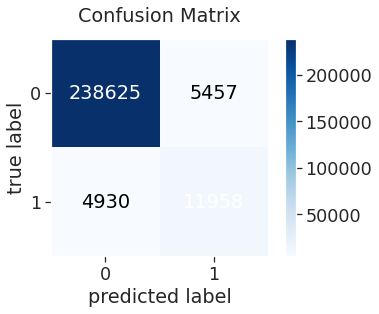

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox7.columns,dtc_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.0014168584264161236
bd:0.00040593318903037976
registered_via:0.0026073070238166562
registration_init_time:0.0013299483037971717
registration_init_year:9.982586246024797e-05
registration_init_month:0.00041364083113937776
gender_male:0.005328058781187183
gender_nan:0.0017978098185174201
transactions_count:0.002574331093032139
first_transactions:0.0024492570183057014
last_transactions:0.38937406856820134
payment_method_changes:0.007360447594621704
payment_plan_days_mean:0.0011206685216521147
payment_plan_days_total:0.0009320095329716103
payment_plan_days_min:0.0007826681006809584
payment_plan_changes:0.0036499489713896337
plan_list_price_mean:0.003830459629415441
actual_amount_paid_mean:0.0007480704554427475
plan_list_price_total:0.0006058981805273901
actual_amount_paid_total:0.004531472134609481
plan_list_price_changes:0.004047427326182966
actual_amount_paid_changes:0.03803369230406033
duration:0.004474541023407391
payment_mean_diff:0.0005526080081087659
payment_total_diff:0.00046

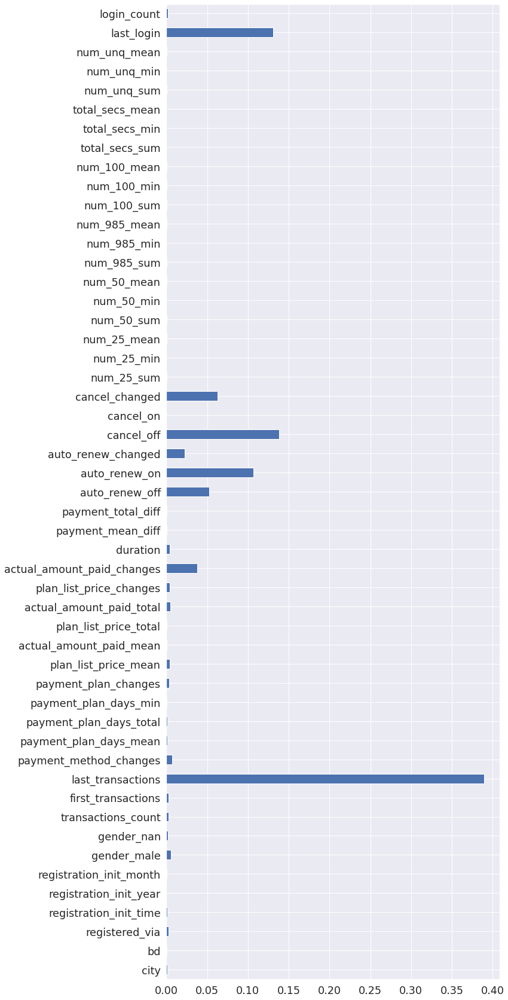

In [ ]:
feat_importances = pd.Series(dtc_model_best.feature_importances_, index=X.columns)


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                            False
registered_via                 True
registration_init_time         True
registration_init_year        False
registration_init_month       False
gender_male                    True
gender_nan                     True
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total       False
payment_plan_days_min         False
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean       False
plan_list_price_total         False
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff             False
payment_total_diff            False
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_dtc_drop = [
                   


'bd'             ,               

'registration_init_year'    ,    
'registration_init_month'   ,    

'payment_plan_days_total'  ,     
'payment_plan_days_min'   ,      

'actual_amount_paid_mean' ,      
'plan_list_price_total'  ,       

'payment_mean_diff'   ,         
'payment_total_diff'  ,          

'cancel_on'          ,           

'num_25_sum'       ,             
'num_25_min'       ,             
'num_25_mean'     ,              
'num_50_sum'       ,             
'num_50_min'      ,              
'num_50_mean'     ,              
'num_985_sum'     ,              
'num_985_min'     ,              
'num_985_mean'    ,              
'num_100_sum'      ,             
'num_100_min'      ,             
'num_100_mean'     ,             
'total_secs_sum'    ,            
'total_secs_min'    ,            
'total_secs_mean'   ,            
'num_unq_sum'      ,             
'num_unq_min'      ,             
'num_unq_mean'                  




 ]


In [ ]:

df_kkbox7_dtc = df_kkbox7.drop(labels = labels_dtc_drop, axis=1)

In [ ]:
df_kkbox7_dtc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 869900 entries, 0 to 869899
Data columns (total 24 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   city                        869900 non-null  int64  
 1   registered_via              869900 non-null  int64  
 2   registration_init_time      869900 non-null  int64  
 3   gender_male                 869900 non-null  int64  
 4   gender_nan                  869900 non-null  int64  
 5   transactions_count          869900 non-null  int64  
 6   first_transactions          869900 non-null  int64  
 7   last_transactions           869900 non-null  int64  
 8   payment_method_changes      869900 non-null  int64  
 9   payment_plan_days_mean      869900 non-null  float64
 10  payment_plan_changes        869900 non-null  int64  
 11  plan_list_price_mean        869900 non-null  float64
 12  actual_amount_paid_total    869900 non-null  int64  
 13  plan_list_pric

In [ ]:
#df_kkbox7_dtc.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox7_dtc.csv', index = False)

In [ ]:
df_kkbox7_dtc = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox7_dtc.csv')

In [ ]:
df_kkbox7_dtc.head()

,city,registered_via,registration_init_time,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_changes,plan_list_price_mean,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,last_login,login_count,is_churn
0,18,9,20050406,0,0,2,20161031,20170107,1,18.500000,2,74.500000,149,2,2,68,1,0,0,1,0,20170208,26,1
1,10,9,20050407,1,0,23,20150131,20170224,2,28.826087,3,143.869565,3458,3,2,755,0,0,1,0,1,20170215,521,1
2,11,9,20051016,0,0,10,20160202,20170112,2,30.000000,1,149.200000,1492,2,2,345,0,0,1,0,1,20170131,237,1
3,13,9,20051102,0,0,2,20160104,20160106,2,410.000000,1,894.000000,1788,2,2,2,1,0,0,1,0,20170221,735,1
4,3,9,20051228,1,0,8,20150102,20170128,1,98.125000,3,447.000000,3576,3,3,757,1,0,0,1,0,20170228,758,1


In [ ]:
X = df_kkbox7_dtc.iloc[:, :-1] 
y = df_kkbox7_dtc['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 40258
Before OverSampling, counts of label '0': 568672 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (1137344, 23)
After OverSampling, the shape of train_y: (1137344,) 

After OverSampling, counts of label '1': 568672
After OverSampling, counts of label '0': 568672


In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
dtc_model_feature = DecisionTreeClassifier() 

params = {'max_depth' : [2,3,5,7,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'criterion' : ['gini', 'entropy'],
          'splitter' : ['best', 'random']}


In [ ]:
random_dtc_feature = RandomizedSearchCV(dtc_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_dtc_feature.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   30.4s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   30.9s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   31.2s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   31.6s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   40.8s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   40.8s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   41.0s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   42.9s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   44.8s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   46.7s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   48.7s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:   50.6s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:   50.7s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:   5

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=None,
       

In [ ]:
random_dtc_feature.best_params_

{'criterion': 'entropy',
 'max_depth': 10,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'splitter': 'best'}

In [ ]:
random_dtc_feature.best_score_

0.9595153353905136

In [ ]:
dtc_feature_model_best = DecisionTreeClassifier(splitter= 'best',
                                   min_samples_split= 2,
                                   min_samples_leaf= 2,
                                   max_depth= 10,
                                   criterion= 'entropy') 


In [ ]:
dtc_feature_model_best.fit(X_train_res, y_train_res)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=10, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dtc_feature_model_best_probs = dtc_feature_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, dtc_feature_model_best_probs))

0.13450521201618745


In [ ]:
y_pred = dtc_feature_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.99      0.96      0.97    244082
           1       0.60      0.80      0.69     16888

    accuracy                           0.95    260970
   macro avg       0.79      0.88      0.83    260970
weighted avg       0.96      0.95      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[235258,   8824],
       [  3443,  13445]])

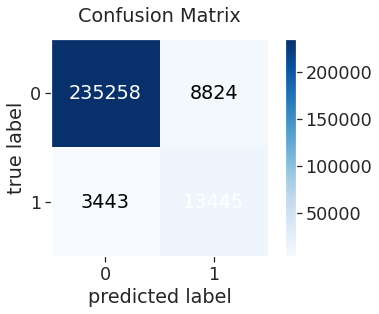

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

## RandomForestClassifier

### Preparação

In [ ]:
df_kkbox7 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5.csv')

In [ ]:
#df_kkbox7 = pd.read_csv('kkbox5.csv')

In [ ]:
X = df_kkbox7.iloc[:, :-1] 
y = df_kkbox7['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

### Balancing data Using SMOTE

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 40258
Before OverSampling, counts of label '0': 568672 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (1137344, 51)
After OverSampling, the shape of train_y: (1137344,) 

After OverSampling, counts of label '1': 568672
After OverSampling, counts of label '0': 568672


### Padronização

In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
rf_model = RandomForestClassifier()

params = {'n_estimators' : [100,200,500,1000,2000],
          'max_features' : ['auto', 'sqrt'],
          'max_depth' : [2,3,5,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'bootstrap' : [True, False]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_rf = RandomizedSearchCV(rf_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_rf.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  5.1min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  5.2min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  5.2min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  5.2min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 10.3min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed: 12.6min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed: 12.9min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed: 12.9min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed: 17.8min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 19.9min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 51.4min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 51.9min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 56.0min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed: 56.

/usr/local/lib/python3.7/dist-packages/joblib/externals/loky/process_executor.py:691: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  "timeout or by a memory leak.", UserWarning


[Parallel(n_jobs=-1)]: Done  32 tasks      | elapsed: 159.5min
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed: 159.7min
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed: 167.0min
[Parallel(n_jobs=-1)]: Done  35 tasks      | elapsed: 167.1min
[Parallel(n_jobs=-1)]: Done  36 tasks      | elapsed: 173.0min
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed: 173.4min
[Parallel(n_jobs=-1)]: Done  38 tasks      | elapsed: 173.5min
[Parallel(n_jobs=-1)]: Done  39 tasks      | elapsed: 178.5min
[Parallel(n_jobs=-1)]: Done  40 tasks      | elapsed: 178.7min
[Parallel(n_jobs=-1)]: Done  41 tasks      | elapsed: 180.2min
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed: 183.5min
[Parallel(n_jobs=-1)]: Done  43 tasks      | elapsed: 183.6min
[Parallel(n_jobs=-1)]: Done  45 out of  50 | elapsed: 186.8min remaining: 20.8min
[Parallel(n_jobs=-1)]: Done  47 out of  50 | elapsed: 248.5min remaining: 15.9min
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed: 290.1min finished


RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
random_rf.best_params_

{'bootstrap': True,
 'max_depth': 15,
 'max_features': 'sqrt',
 'min_samples_leaf': 3,
 'min_samples_split': 5,
 'n_estimators': 500}

In [ ]:
random_rf.best_score_

0.9728929935557596

### Testando log-loss do melhor parametro

In [ ]:
rf_model_best = RandomForestClassifier(n_estimators= 500,
                                       min_samples_split= 5,
                                       min_samples_leaf= 3,
                                       max_features= 'sqrt',
                                       max_depth= 15,
                                       bootstrap= True)

In [ ]:
rf_model_best.fit(X_train_res, y_train_res)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=15, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=500,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf_model_best_probs = rf_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, rf_model_best_probs))

0.09762260826787762


In [ ]:
y_pred = rf_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98    244082
           1       0.68      0.77      0.72     16888

    accuracy                           0.96    260970
   macro avg       0.83      0.87      0.85    260970
weighted avg       0.96      0.96      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[238025,   6057],
       [  3965,  12923]])

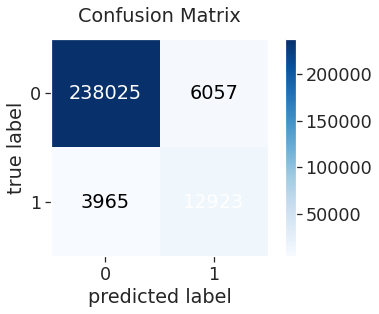

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox7.columns,rf_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.007312865463356155
bd:0.00445682011225292
registered_via:0.01613752400920947
registration_init_time:0.0018180418394191185
registration_init_year:0.000955405282388511
registration_init_month:0.002441137522247739
gender_male:0.00945914532096447
gender_nan:0.01664712112830846
transactions_count:0.016360712249938788
first_transactions:0.00618699734871828
last_transactions:0.16226775557483963
payment_method_changes:0.027643878181627002
payment_plan_days_mean:0.020958507953622155
payment_plan_days_total:0.008812038559978051
payment_plan_days_min:0.011544903175049713
payment_plan_changes:0.0102670159991062
plan_list_price_mean:0.029939993935148432
actual_amount_paid_mean:0.030427074635890748
plan_list_price_total:0.006111438536616261
actual_amount_paid_total:0.006947080445456304
plan_list_price_changes:0.017619053636933345
actual_amount_paid_changes:0.03018684725244362
duration:0.016677956182560617
payment_mean_diff:0.003769520771186081
payment_total_diff:0.006937760729968935
auto_rene

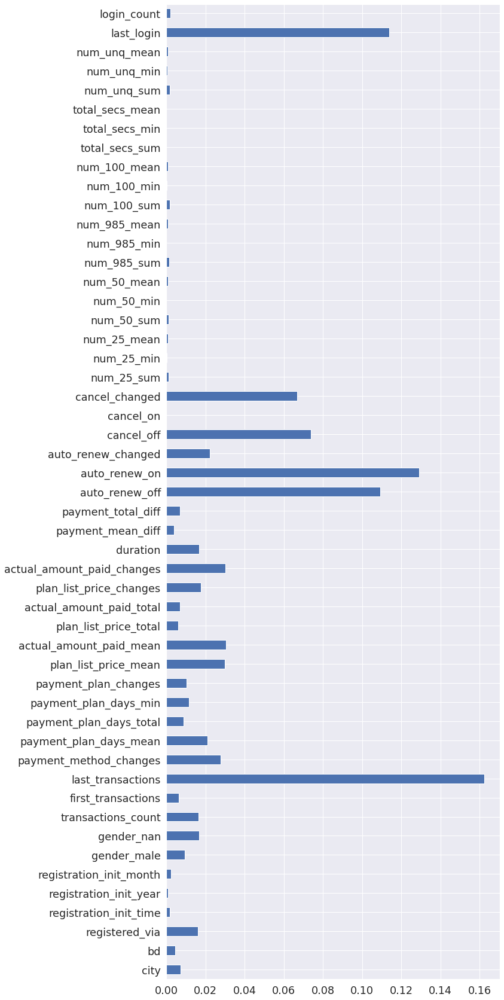

In [ ]:
feat_importances = pd.Series(rf_model_best.feature_importances_, index=X.columns)


sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                             True
registered_via                 True
registration_init_time         True
registration_init_year        False
registration_init_month        True
gender_male                    True
gender_nan                     True
transactions_count             True
first_transactions             True
last_transactions              True
payment_method_changes         True
payment_plan_days_mean         True
payment_plan_days_total        True
payment_plan_days_min          True
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean        True
plan_list_price_total          True
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff              True
payment_total_diff             True
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_rf_drop = [


'registration_init_year'        ,

'cancel_on'                  ,   

'num_25_min'               ,     
'num_25_mean'              ,     

'num_50_min'             ,       
'num_50_mean'           ,        

'num_985_min'         ,          
'num_985_mean'       ,           

'num_100_min'        ,           
'num_100_mean'      ,            
'total_secs_sum'    ,            
'total_secs_min'    ,            
'total_secs_mean'   ,            

'num_unq_min'       ,            
'num_unq_mean'                  

    

                   
 ]


In [ ]:

df_kkbox7_rf = df_kkbox7.drop(labels = labels_rf_drop, axis=1)

In [ ]:
df_kkbox7_rf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 869900 entries, 0 to 869899
Data columns (total 37 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   city                        869900 non-null  int64  
 1   bd                          869900 non-null  float64
 2   registered_via              869900 non-null  int64  
 3   registration_init_time      869900 non-null  int64  
 4   registration_init_month     869900 non-null  int64  
 5   gender_male                 869900 non-null  int64  
 6   gender_nan                  869900 non-null  int64  
 7   transactions_count          869900 non-null  int64  
 8   first_transactions          869900 non-null  int64  
 9   last_transactions           869900 non-null  int64  
 10  payment_method_changes      869900 non-null  int64  
 11  payment_plan_days_mean      869900 non-null  float64
 12  payment_plan_days_total     869900 non-null  int64  
 13  payment_plan_d

In [ ]:
#df_kkbox7_rf.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox7_rf.csv', index = False)

In [ ]:
df_kkbox7_rf = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox7_rf.csv')

In [ ]:
df_kkbox7_rf.head()

,city,bd,registered_via,registration_init_time,registration_init_month,gender_male,gender_nan,transactions_count,first_transactions,last_transactions,payment_method_changes,payment_plan_days_mean,payment_plan_days_total,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_mean,plan_list_price_total,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,payment_mean_diff,payment_total_diff,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,num_25_sum,num_50_sum,num_985_sum,num_100_sum,num_unq_sum,last_login,login_count,is_churn
0,18,36.0,9,20050406,4,0,0,2,20161031,20170107,1,18.500000,37,7,2,74.500000,74.500000,149,149,2,2,68,0.000000,0,1,0,0,1,0,51,16,11,409,462,20170208,26,1
1,10,38.0,9,20050407,4,1,0,23,20150131,20170224,2,28.826087,663,0,3,143.869565,150.347826,3309,3458,3,2,755,6.478261,149,0,0,1,0,1,447,157,178,9942,7232,20170215,521,1
2,11,27.0,9,20051016,10,0,0,10,20160202,20170112,2,30.000000,300,30,1,149.200000,149.200000,1492,1492,2,2,345,0.000000,0,0,0,1,0,1,1570,950,479,10033,11533,20170131,237,1
3,13,23.0,9,20051102,11,0,0,2,20160104,20160106,2,410.000000,820,410,1,894.000000,894.000000,1788,1788,2,2,2,0.000000,0,1,0,0,1,0,7265,2420,1634,18070,18479,20170221,735,1
4,3,27.0,9,20051228,12,1,0,8,20150102,20170128,1,98.125000,785,30,3,447.000000,447.000000,3576,3576,3,3,757,0.000000,0,1,0,0,1,0,1389,714,3228,68731,72674,20170228,758,1


In [ ]:
X = df_kkbox7_rf.iloc[:, :-1] 
y = df_kkbox7_rf['is_churn']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [ ]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 40258
Before OverSampling, counts of label '0': 568672 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (1137344, 36)
After OverSampling, the shape of train_y: (1137344,) 

After OverSampling, counts of label '1': 568672
After OverSampling, counts of label '0': 568672


In [ ]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
rf_model_feature = RandomForestClassifier()

params = {'n_estimators' : [100,200,500,1000,2000],
          'max_features' : ['auto', 'sqrt'],
          'max_depth' : [2,3,5,10,15],
          'min_samples_split' : [2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'bootstrap' : [True, False]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_rf_feature = RandomizedSearchCV(rf_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_rf_feature.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed: 27.1min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed: 27.2min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed: 27.5min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed: 27.5min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 50.8min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed: 149.8min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed: 151.3min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed: 152.2min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed: 164.1min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 164.4min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 174.4min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 176.0min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 177.4min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elap

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
random_rf_feature.best_params_

{'bootstrap': False,
 'max_depth': 15,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 7,
 'n_estimators': 100}

In [ ]:
random_rf_feature.best_score_

0.973570011011257

In [ ]:
rf_feature_model_best = RandomForestClassifier(n_estimators= 100,
                                       min_samples_split= 7,
                                       min_samples_leaf= 1,
                                       max_features= 'auto',
                                       max_depth= 15,
                                       bootstrap= False)

In [ ]:
rf_feature_model_best.fit(X_train_res, y_train_res)

RandomForestClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=15, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=7,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf_feature_model_best_probs = rf_feature_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, rf_feature_model_best_probs))

0.09825624147376502


In [ ]:
y_pred = rf_feature_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.97      0.98    244082
           1       0.67      0.78      0.72     16888

    accuracy                           0.96    260970
   macro avg       0.83      0.88      0.85    260970
weighted avg       0.96      0.96      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[237719,   6363],
       [  3747,  13141]])

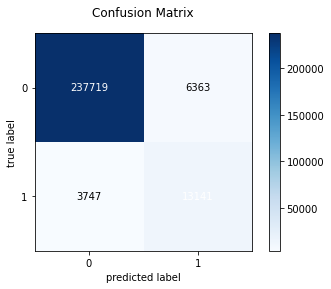

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

## GradientBoostingClassifier

### Preparação

In [6]:
df_kkbox7 = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox5.csv')

In [ ]:
#df_kkbox7 = pd.read_csv('kkbox5.csv')

In [7]:
X = df_kkbox7.iloc[:, :-1] 
y = df_kkbox7['is_churn']

In [8]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

### Balancing data Using SMOTE

In [9]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 40258
Before OverSampling, counts of label '0': 568672 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (1137344, 51)
After OverSampling, the shape of train_y: (1137344,) 

After OverSampling, counts of label '1': 568672
After OverSampling, counts of label '0': 568672


### Padronização

In [10]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [ ]:
gb_model = GradientBoostingClassifier() 

params = {'max_depth':[2,3,5,7,10,15],
          'min_samples_split':[2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'learning_rate' : [0.02,0.05,0.07]}

In [ ]:
# Exemplo para o uso scoring igual ao meus_scores.
random_gb = RandomizedSearchCV(gb_model, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_gb.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed: 86.2min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed: 86.2min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed: 86.3min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed: 90.0min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 107.0min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed: 107.6min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed: 111.1min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed: 127.6min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed: 128.5min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 171.7min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 180.3min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 193.6min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 195.3min
[Parallel(n_jobs=-1)]: Done  14 tasks      | ela

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                        criterion='friedman_mse',
                                                        init=None,
                                                        learning_rate=0.1,
                                                        loss='deviance',
                                                        max_depth=3,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                 

In [ ]:
random_gb.best_params_

{'learning_rate': 0.05,
 'max_depth': 7,
 'min_samples_leaf': 1,
 'min_samples_split': 7}

In [ ]:
random_gb.best_score_

0.9711564968502134

### Testando log-loss do melhor parametro

In [ ]:
gb_model_best = GradientBoostingClassifier(min_samples_split= 7,
                                           min_samples_leaf= 1,
                                           max_depth= 7,
                                           learning_rate= 0.05) 

In [ ]:
gb_model_best.fit(X_train_res, y_train_res)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.05, loss='deviance', max_depth=7,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=7,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [ ]:
gb_model_best_probs = gb_model_best.predict_proba(X_test)

In [ ]:
print(log_loss(y_test, gb_model_best_probs))

0.09994934921920583


In [ ]:
y_pred = gb_model_best.predict(X_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98    244082
           1       0.70      0.72      0.71     16888

    accuracy                           0.96    260970
   macro avg       0.84      0.85      0.84    260970
weighted avg       0.96      0.96      0.96    260970



In [ ]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[238735,   5347],
       [  4700,  12188]])

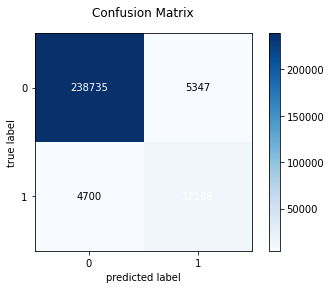

In [ ]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()

### Feature Importance

In [ ]:

for feature,importance in zip(df_kkbox7.columns,gb_model_best.feature_importances_):
    print("{}:{}".format(feature, importance))

city:0.0013126115392417448
bd:0.00015639025783664088
registered_via:0.0030796843271902576
registration_init_time:8.514332029000904e-05
registration_init_year:1.6096750070129413e-05
registration_init_month:0.0002481598411509232
gender_male:0.004307842714283957
gender_nan:0.0031477767227376767
transactions_count:0.0034313621696878127
first_transactions:0.0009896787160473316
last_transactions:0.33976947824840764
payment_method_changes:0.006635997626740247
payment_plan_days_mean:0.0008473893448309868
payment_plan_days_total:0.0003153267884496878
payment_plan_days_min:0.001229087718241522
payment_plan_changes:0.002464255883493519
plan_list_price_mean:0.001430764682165008
actual_amount_paid_mean:0.0004490216435014291
plan_list_price_total:0.00032741768461600374
actual_amount_paid_total:0.002195705302030424
plan_list_price_changes:0.004641051521151848
actual_amount_paid_changes:0.027798594360774906
duration:0.0032409902539009515
payment_mean_diff:0.00014929117717722527
payment_total_diff:0.00

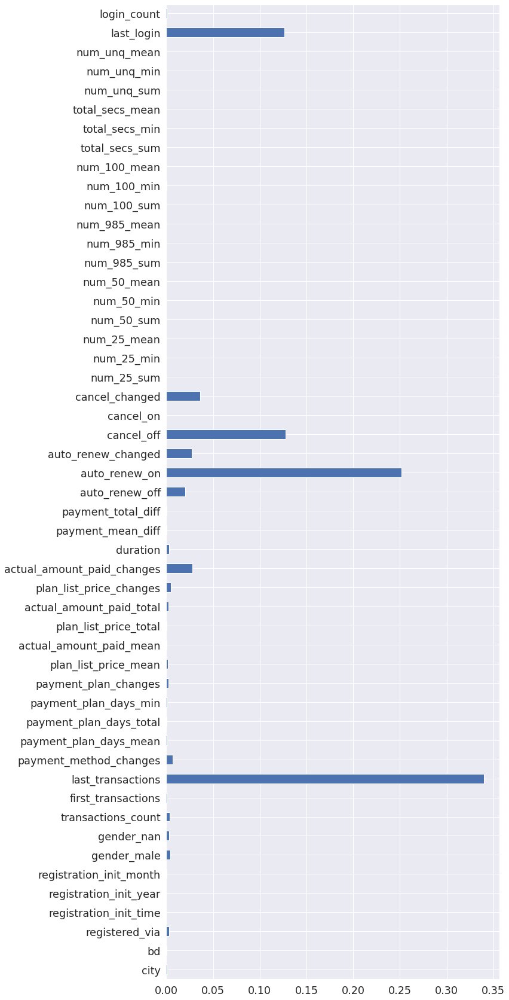

In [ ]:
feat_importances = pd.Series(gb_model_best.feature_importances_, index=X.columns)

sns.set(font_scale=1.6)
fig, ax = plt.subplots(figsize=(10,30)) 
feat_importances.plot(kind='barh')

In [ ]:
feat_importances_best = feat_importances > 0.001

In [ ]:
feat_importances_best

city                           True
bd                            False
registered_via                 True
registration_init_time        False
registration_init_year        False
registration_init_month       False
gender_male                    True
gender_nan                     True
transactions_count             True
first_transactions            False
last_transactions              True
payment_method_changes         True
payment_plan_days_mean        False
payment_plan_days_total       False
payment_plan_days_min          True
payment_plan_changes           True
plan_list_price_mean           True
actual_amount_paid_mean       False
plan_list_price_total         False
actual_amount_paid_total       True
plan_list_price_changes        True
actual_amount_paid_changes     True
duration                       True
payment_mean_diff             False
payment_total_diff            False
auto_renew_off                 True
auto_renew_on                  True
auto_renew_changed          

In [ ]:
labels_gb_drop = [


'bd'                 ,           

'registration_init_time'    ,    
'registration_init_year'    ,    
'registration_init_month'   ,    

'first_transactions'      ,      

'payment_plan_days_mean' ,       
'payment_plan_days_total' ,      

'actual_amount_paid_mean' ,      
'plan_list_price_total'    ,     

'payment_mean_diff'     ,        
'payment_total_diff'    ,        

'cancel_on'        ,             

'num_25_sum'      ,              
'num_25_min'       ,             
'num_25_mean'     ,              
'num_50_sum'      ,              
'num_50_min'      ,              
'num_50_mean'     ,              
'num_985_sum'     ,              
'num_985_min'      ,             
'num_985_mean'      ,            
'num_100_sum'      ,             
'num_100_min'      ,             
'num_100_mean'     ,             
'total_secs_sum'    ,            
'total_secs_min'   ,             
'total_secs_mean'  ,             
'num_unq_sum'      ,             
'num_unq_min'     ,              
'num_unq_mean'    ,              

'login_count'                   


                   
 ]


In [ ]:

df_kkbox7_gb = df_kkbox7.drop(labels = labels_gb_drop, axis=1)

In [ ]:
df_kkbox7_gb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 869900 entries, 0 to 869899
Data columns (total 21 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   city                        869900 non-null  int64  
 1   registered_via              869900 non-null  int64  
 2   gender_male                 869900 non-null  int64  
 3   gender_nan                  869900 non-null  int64  
 4   transactions_count          869900 non-null  int64  
 5   last_transactions           869900 non-null  int64  
 6   payment_method_changes      869900 non-null  int64  
 7   payment_plan_days_min       869900 non-null  int64  
 8   payment_plan_changes        869900 non-null  int64  
 9   plan_list_price_mean        869900 non-null  float64
 10  actual_amount_paid_total    869900 non-null  int64  
 11  plan_list_price_changes     869900 non-null  int64  
 12  actual_amount_paid_changes  869900 non-null  int64  
 13  duration      

In [ ]:
#df_kkbox7_gb.to_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox7_gb.csv', index = False)

In [11]:
df_kkbox7_gb = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/kkbox7_gb.csv')

In [12]:
df_kkbox7_gb.head()

,city,registered_via,gender_male,gender_nan,transactions_count,last_transactions,payment_method_changes,payment_plan_days_min,payment_plan_changes,plan_list_price_mean,actual_amount_paid_total,plan_list_price_changes,actual_amount_paid_changes,duration,auto_renew_off,auto_renew_on,auto_renew_changed,cancel_off,cancel_changed,last_login,is_churn
0,18,9,0,0,2,20170107,1,7,2,74.500000,149,2,2,68,1,0,0,1,0,20170208,1
1,10,9,1,0,23,20170224,2,0,3,143.869565,3458,3,2,755,0,0,1,0,1,20170215,1
2,11,9,0,0,10,20170112,2,30,1,149.200000,1492,2,2,345,0,0,1,0,1,20170131,1
3,13,9,0,0,2,20160106,2,410,1,894.000000,1788,2,2,2,1,0,0,1,0,20170221,1
4,3,9,1,0,8,20170128,1,30,3,447.000000,3576,3,3,757,1,0,0,1,0,20170228,1


In [13]:
X = df_kkbox7_gb.iloc[:, :-1] 
y = df_kkbox7_gb['is_churn']

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X,y,random_state = 123,test_size = 0.3)    

In [15]:
print("Before OverSampling, counts of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train == 0)))

sm = SMOTE(random_state = 123,n_jobs=-1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train)
  
print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res == 0)))

Before OverSampling, counts of label '1': 40258
Before OverSampling, counts of label '0': 568672 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


After OverSampling, the shape of train_X: (1137344, 20)
After OverSampling, the shape of train_y: (1137344,) 

After OverSampling, counts of label '1': 568672
After OverSampling, counts of label '0': 568672


In [16]:
scaler = StandardScaler()
X_train_res = scaler.fit_transform(X_train_res) # aplica fit e tansforme no treino
X_test = scaler.transform(X_test)    #aplica somente transform no teste

In [17]:
gb_model_feature = GradientBoostingClassifier() 

params = {'max_depth':[2,3,5,7,10,15],
          'min_samples_split':[2,3,5,7,10],
          'min_samples_leaf' : [1,2,3],
          'learning_rate' : [0.02,0.05,0.07]}

In [18]:
# Exemplo para o uso scoring igual ao meus_scores.
random_gb_feature = RandomizedSearchCV(gb_model_feature, param_distributions=params, verbose=50, n_jobs=-1)

In [ ]:
random_gb_feature.fit(X_train_res, y_train_res)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed: 25.5min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed: 25.5min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed: 25.9min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed: 26.2min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed: 50.8min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed: 51.0min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed: 51.3min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed: 51.9min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed: 60.5min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed: 60.6min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed: 69.1min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed: 69.5min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed: 76.0min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed: 76.

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                        criterion='friedman_mse',
                                                        init=None,
                                                        learning_rate=0.1,
                                                        loss='deviance',
                                                        max_depth=3,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                 

In [ ]:
random_gb_feature.best_params_

{'learning_rate': 0.07,
 'max_depth': 15,
 'min_samples_leaf': 1,
 'min_samples_split': 2}

In [ ]:
random_gb_feature.best_score_

0.9737317958279774

In [19]:
gb_feature_model_best = GradientBoostingClassifier(min_samples_split= 2,
                                           min_samples_leaf= 1,
                                           max_depth= 15,
                                           learning_rate= 0.07) 

In [20]:
gb_feature_model_best.fit(X_train_res, y_train_res)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.07, loss='deviance', max_depth=15,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=None, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [21]:
gb_feature_model_best_probs = gb_feature_model_best.predict_proba(X_test)

In [22]:
print(log_loss(y_test, gb_feature_model_best_probs))

0.09226426965167604


In [23]:
y_pred = gb_feature_model_best.predict(X_test)

In [24]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98    244082
           1       0.74      0.70      0.72     16888

    accuracy                           0.96    260970
   macro avg       0.86      0.84      0.85    260970
weighted avg       0.96      0.96      0.96    260970



In [25]:
matrix = confusion_matrix(y_test, y_pred)
matrix

array([[239959,   4123],
       [  5117,  11771]])

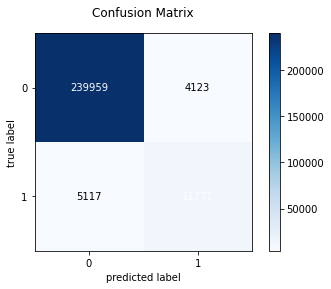

In [26]:
plot_confusion_matrix(conf_mat=matrix,
                                show_absolute=True,
                                show_normed=False,
                                colorbar=True
                                )
plt.title('Confusion Matrix')
plt.show()